First, import necessary packages (all of them should be included in the Anaconda installation). The last few lines are just for plot formatting and specifying how matplotlib plots interact with this Jupyter notebook.

In [1]:
import numpy as np
import os
import warnings
from astropy.stats import sigma_clip
from astropy.io import fits
import matplotlib.pyplot as plt
from matplotlib import rc
rc('font', family='serif')
rc('mathtext', fontset='cm')

%matplotlib notebook

Next, download the full dataset from the [CFHTLS website](https://www.cadc-ccda.hia-iha.nrc-cnrc.gc.ca/en/megapipe/cfhtls/dfspt.html) and unzip the files using tar. I put the whole folder into the same directory this notebook is in, but you can just change the file path in the next line to point to wherever you put your data.

In [2]:
full_file_list = os.listdir('full') # creates a Python list containing the file paths for every object's time series

# this is just see how many objects we're working with
len(full_file_list)

28108

In [3]:
def load_one_timeseries(file_name):
    """
    Function to access light curve data for one object.
    
    Parameters
    ---
    file_name : str
        File path to CFHTLS time series data file (eg. 'CFHTLS-VAR-J022359.77-041810.1.mjdmag')
        
    Returns
    ---
    field : str
        CFHTLS field (D1, D2, D3, or D4) object is found in
    timestamps : ndarray
        Array of recorded times for each measurement
    mags : ndarray
        Array of measured magnitude for each measurement
    magerrs : ndarray
        Array of measurement error in magnitude for each measurement
    expnums : ndarray
        Array of the MegaCam exposure number in which each measurement can be found
    int_filters : ndarray
        Array of integers representing each CFHTLS filter indicating what filter each magnitude was measured in
        (u = 0, g = 1, r = 2, i1 = 3, i2 = 4, z = 5 - there were two different I-band filters)
    num_entries : int
        Total number of measurements
    
    """
    timestamps = []
    mags = []
    magerrs = []
    expnums = []
    filters = []

    with open('full/'+file_name) as data_file:
        first_line = data_file.readline()
        field = (first_line.split())[2]
        for line in data_file:
            if not line.startswith('#'):
                data = line.split()
                timestamps.append(data[0])
                mags.append(data[1])
                magerrs.append(data[2])
                expnums.append(data[3])
                filters.append(data[8])

    timestamps = np.asarray(timestamps, dtype=float)
    mags = np.asarray(mags, dtype=float)
    magerrs = np.asarray(magerrs, dtype=float)
    expnums = np.asarray(expnums, dtype=int)

    int_filters = np.empty(len(filters), dtype=int)
    with warnings.catch_warnings():
        warnings.simplefilter(action='ignore', category=FutureWarning)
        int_filters[np.where(np.asarray(filters)=='U')[0]] = 0
        int_filters[np.where(np.asarray(filters)=='G')[0]] = 1
        int_filters[np.where(np.asarray(filters)=='R')[0]] = 2
        int_filters[np.where(np.asarray(filters)=='I')[0]] = 3
        int_filters[np.where(np.asarray(filters)=='I2')[0]] = 4
        int_filters[np.where(np.asarray(filters)=='Z')[0]] = 5
        
    num_entries = len(timestamps)
    
    return field, timestamps, mags, magerrs, expnums, int_filters, num_entries

In [4]:
def get_num_measurements(file_list, by_filter=False):
    """
    Function to obtain the number of measurements in each time series file.
    
    Parameters
    ---
    file_list : list of str
        List of file paths (eg. one created by os.listdir(folder_path))
    by_filter : bool
        Defaults to False. Set to true to return an array containing number of measurements per filter
        
    Returns
    ---
    num_measurements : ndarray
        Array containing number of time series measurements per object
        If by_filter=False, Nx1 array, where N = number of objects
        If by_filter=True, NxM array, where N = number of objects and M = number of filters
    
    """
    if by_filter==False:
        num_measurements = np.empty(len(file_list))
        for i, fname in enumerate(file_list):
            _, _, _, _, _, _, num = load_one_timeseries(fname)
            num_measurements[i] = num
    elif by_filter==True:
        num_measurements = np.empty((len(file_list), 6))
        for i, fname in enumerate(file_list):
            _, _, _, _, _, filters, _ = load_one_timeseries(fname)
            for j in range(6):
                num_measurements[i,j] = np.sum(filters==j)
    return num_measurements

Use the functions we just wrote to get a sense of how many measurements we're working with:\
1) Obtain the total number of measurements for each object\
2) See how many objects have a sufficient number of measurements (>15) to work with\
3) Obtain the number of measurements per filter for each object\
4) See how many objects have at least one measurement in each filter

We keep only those objects that satisfy (2) and (4).

Note: I personally frequently load the array I just generated using a function to get an idea of what it looks like and check if there are any problems with the code.

In [5]:
num_measurements = get_num_measurements(full_file_list)
num_measurements

array([3074., 3034., 2508., ..., 2892., 2914., 2973.])

In [6]:
file_list = (np.asarray(full_file_list))[num_measurements>15]
len(file_list)

28056

In [7]:
num_measurements_by_filter = get_num_measurements(file_list, by_filter=True)
num_measurements_by_filter

array([[201., 589., 707., 624., 243., 710.],
       [200., 588., 705., 618., 240., 683.],
       [176., 502., 575., 491., 211., 553.],
       ...,
       [181., 573., 678., 629., 201., 630.],
       [161., 574., 688., 638., 212., 641.],
       [215., 578., 688., 638., 212., 642.]])

In [8]:
file_list = file_list[np.all(num_measurements_by_filter>0, axis=1)]
len(file_list)

27844

In [9]:
def get_medians(file_list):
    """
    Function that obtains the median magnitude in each filter for each object.
    
    Parameters
    ---
    file_list : list of str
        List of file paths (eg. one created by os.listdir(folder_path))
        
    Returns
    ---
    medians : ndarray
        NxM array, where N = number of objects and M = number of filters
        Contains median magnitude of measurement in a given filter per object.
    
    Examples
    ---
    medians[0] will return the median measurement in each of all 6 filters for the first object in file_list
    medians[:,5] will return the median z-band measurements for all objects in file_list
    medians[5,2] will return the median r-band measurement for the 6th object in file_list

    """
    medians = np.empty((len(file_list), 6))
    for i, fname in enumerate(file_list):
        _, _, mags, _, _, filters, _ = load_one_timeseries(fname)
        for j in range(6):
            medians[i,j] = np.median(mags[filters==j])
    return medians

In [10]:
medians = get_medians(file_list)
medians

array([[23.817 , 23.11  , 22.814 , 22.623 , 22.571 , 22.536 ],
       [23.869 , 23.5295, 23.456 , 23.05  , 23.2045, 22.887 ],
       [23.1055, 22.484 , 22.219 , 22.102 , 22.012 , 22.085 ],
       ...,
       [22.522 , 21.829 , 21.523 , 21.416 , 21.387 , 21.381 ],
       [25.553 , 23.784 , 22.5265, 21.607 , 21.629 , 21.254 ],
       [23.11  , 22.448 , 21.807 , 21.0265, 21.048 , 20.6825]])

In [11]:
def get_avg_photo_err(file_list, by_filter=False):
    """
    Function that obtains the mean photometric measurement error in each filter for each object.
    
    Parameters
    ---
    file_list : list of str
        List of file paths (eg. one created by os.listdir(folder_path))
    by_filter : bool
        Defaults to False. Set to true to return an array containing number of measurements per filter
        
    Returns
    ---
    errs : ndarray
        Array containing the mean of the photometric measurement error per object
        If by_filter=False, Nx1 array, where N = number of objects
        If by_filter=True, NxM array, where N = number of objects and M = number of filters.

    """
    if by_filter==False:
        errs = np.empty(len(file_list))
        for i, fname in enumerate(file_list):
            _, _, _, magerrs, _, _, _ = load_one_timeseries(fname)
            errs[i] = np.mean(magerrs)
    elif by_filter==True:
        errs = np.empty((len(file_list), 6))
        for i, fname in enumerate(file_list):
            _, _, _, magerrs, _, filters, _ = load_one_timeseries(fname)
            for j in range(6):
                errs[i,j] = np.mean(magerrs[filters==j])
    return errs

In [12]:
mean_photo_err = get_avg_photo_err(file_list)
mean_photo_err

array([0.21538874, 0.35158965, 0.11729785, ..., 0.11406362, 0.24811153,
       0.13699832])

In [13]:
mean_photo_err_by_filter = get_avg_photo_err(file_list, by_filter=True)
mean_photo_err_by_filter

array([[0.63032836, 0.10380985, 0.13157284, 0.11773237, 0.16617695,
        0.37661549],
       [0.409005  , 0.1722483 , 0.22816454, 0.20052913, 0.30124583,
        0.77094876],
       [0.22847159, 0.06090637, 0.07370957, 0.07596334, 0.11692891,
        0.21526944],
       ...,
       [0.11666851, 0.10538743, 0.10789676, 0.15158824, 0.17172637,
        0.07198095],
       [2.13437267, 0.19077003, 0.079875  , 0.17285423, 0.19300943,
        0.09938846],
       [0.1940093 , 0.19307439, 0.10055523, 0.10818809, 0.12412736,
        0.13935514]])

In [14]:
# find how many objects have an average photometric measurement error below 0.1 mag
smallerrs = mean_photo_err<0.1 # this will be a boolean filter we will use later!
np.sum(smallerrs)

10477

There are two i-band filters, but we want to put all the I-band data into one filter. We do this by fitting a relation between the median g-band magnitudes and median i-band magnitudes for the data with small average photometric measurement error:

$$ <i_2> - <i_1> = a + b(<g> - <i_1>) $$

where the brackets indicate the median value for each object. Then, we can convert all the first i-band filters to the second for each object, and recalculate the median i-band magnitude.

<IPython.core.display.Javascript object>


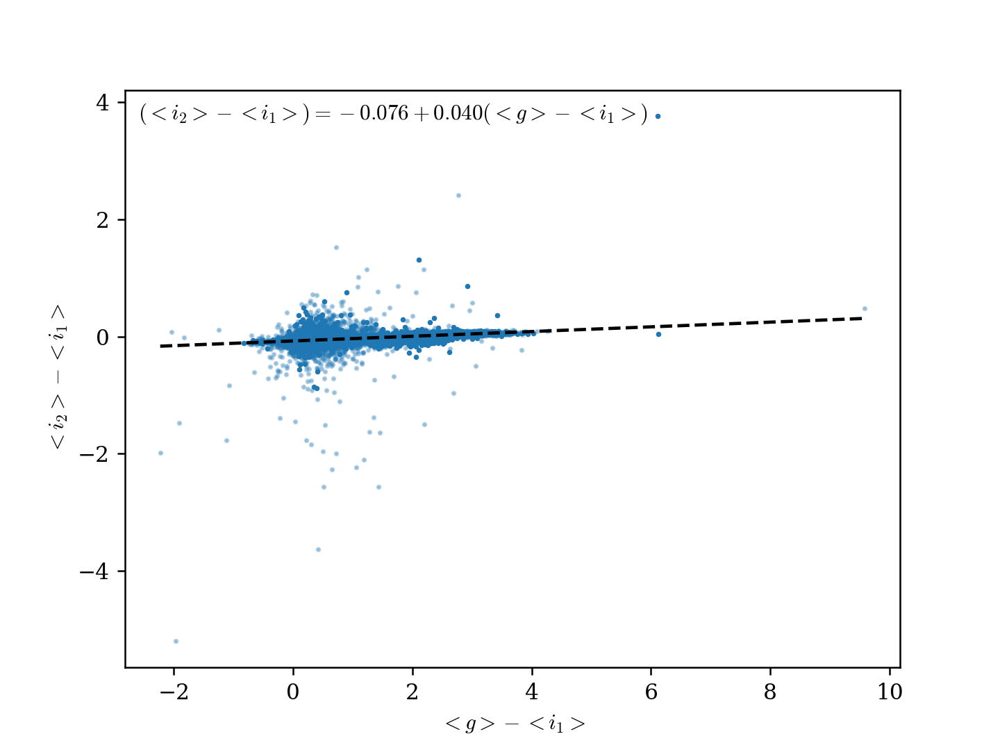

Text(-2.6, 3.7, '$(<i_2>-<i_1>) = -0.076 + 0.040(<g>-<i_1>)$')

In [15]:
# assign integer filter values to variables, just to make things easier/keep things in order
u = 0
g = 1
r = 2
i1 = 3
i2 = 4
z = 5

fit_coeffs = np.polyfit(medians[smallerrs,g]-medians[smallerrs,i1], medians[smallerrs,i2]-medians[smallerrs,i1], 1) # this finds a and b
fit = np.poly1d(fit_coeffs) # this creates a function with the coefficients we just fit

xp = np.linspace((medians[:,g]-medians[:,i1]).min(), (medians[:,g]-medians[:,i1]).max(), 100)
plt.scatter(medians[~smallerrs,g]-medians[~smallerrs,i1], medians[~smallerrs,i2]-medians[~smallerrs,i1], s=2, c='C0', alpha=0.3)
plt.scatter(medians[smallerrs,g]-medians[smallerrs,i1], medians[smallerrs,i2]-medians[smallerrs,i1], s=2)
plt.plot(xp, fit(xp), 'k--')
plt.xlabel(r'$<g>-<i_1>$')
plt.ylabel(r'$<i_2>-<i_1>$')
plt.text(-2.6, 3.7, r'$(<i_2>-<i_1>) = %.3f + %.3f(<g>-<i_1>)$' % (fit_coeffs[1], fit_coeffs[0]))
#plt.savefig('./figs/i2-i1_vs_g-i1.png', bbox_inches='tight')

In [16]:
# save the i-band transform coefficients in case we want them later without rerunning all the code
np.savetxt('i1toi2_transform_coeffs.txt', fit_coeffs)

In [17]:
medians_combined_i = np.empty((len(file_list), 5))
medians_combined_i[:,0] = medians[:,u] # u
medians_combined_i[:,1] = medians[:,g] # g
medians_combined_i[:,2] = medians[:,r] # r
medians_combined_i[:,4] = medians[:,z] # z

for i, fname in enumerate(file_list):
    _, _, mags, _, _, filters, _ = load_one_timeseries(fname)
    transformed_mags_i1_to_i2 = mags[filters==i1] + fit(medians[i,g]-medians[i,i1])
    medians_combined_i[i,3] = np.median(np.concatenate((mags[filters==i2], transformed_mags_i1_to_i2)))

I initially also propagated the measurement error by rewriting the relation above as 
$$ <i_2> = a + b(<g> - <i_1>) + <i_1> = (a+b<g>) + (1-b)<i_1> $$ so that $|1-b|$ would be the correct factor by which to multiply the $i_1$ photometric measurement error.

However, upon further inspection (ie. as I'm going back through my work to annotate and document my code), I realized that the transformation for each individual $i_1$ measurement was actually $$ i_2 = a + b(<g> - <i_1>) + i_1 $$ where the brackets indicate the median magnitude for the object and the non-bracketed values are individual measurements. In this case, the transformation is just the addition of a constant wrt the individual magnitude measurement $i_1$, so the measurement error is not changed.

With both methods, the mean photometric measurement error was then recalculated for the entire i-band. Since $b$ in the first case is very small, there is really little practical difference in the two approaches. I've left my code from the first method in, just commented out, in case you'd like to see it.

In [18]:
photo_err_combined_i = np.empty((len(file_list), 5))
photo_err_combined_i[:,0] = mean_photo_err_by_filter[:,u] # u
photo_err_combined_i[:,1] = mean_photo_err_by_filter[:,g] # g
photo_err_combined_i[:,2] = mean_photo_err_by_filter[:,r] # r
photo_err_combined_i[:,4] = mean_photo_err_by_filter[:,z] # z

for i, fname in enumerate(file_list):
    _, _, _, magerrs, _, filters, _ = load_one_timeseries(fname)
    #transformed_magerrs_i1_to_i2 = (1-fit_coeffs[0])*magerrs[filters==i1]
    #photo_err_combined_i[i,3] = np.mean(np.concatenate((magerrs[filters==i2], transformed_magerrs_i1_to_i2)))
    photo_err_combined_i[i,3] = np.mean(np.concatenate((magerrs[filters==i2], magerrs[filters==i1])))

In [19]:
# just resetting the filters to account for the new arrays with a combined i-band
u = 0
g = 1
r = 2
i = 3
z = 4

Now we start getting into the interesting stuff. Below is a plot of the mean photometric error as a function of median magnitude. This plot is very unusual because of the sharp dip visible in all the bands just above \~22 mag (\~20 mag for z-band). We do expect measurement errors to go up as stars get dimmer, and this trend is visible up to the dip. However, the sudden drop in error at dimmer magnitudes is strange.

<IPython.core.display.Javascript object>


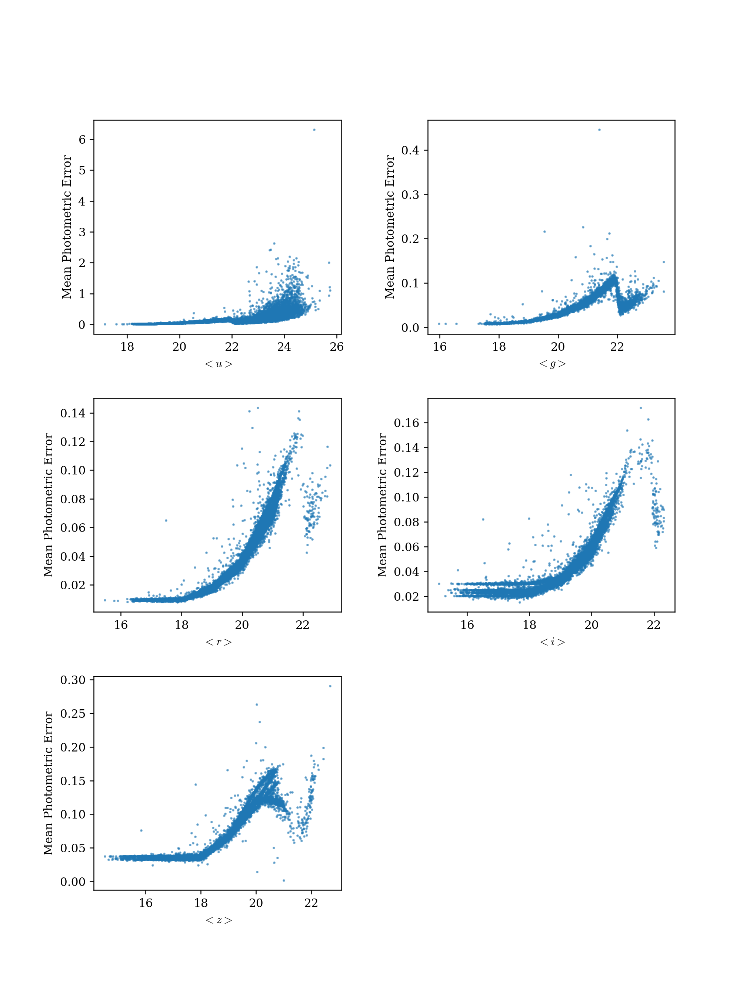

In [20]:
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(medians_combined_i[smallerrs,j], photo_err_combined_i[smallerrs,j], s=1.5, alpha=0.5)
    ax.set_ylabel('Mean Photometric Error')
    ax.set_xlabel(r'$<%s>$' % band)

#plt.savefig('./figs/err_vs_mag_smallerrs.png', bbox_inches='tight')

And below, I just wanted to take a look at the mean photometric errors in the i-band since we'd combined them. It looks like the second i-band just had generically higher errors than the first, and the combined values are in between as we'd expect. The magnitude range is expected and about the same for all bands. This is a good sanity check for our earlier i-band transformation.

<IPython.core.display.Javascript object>


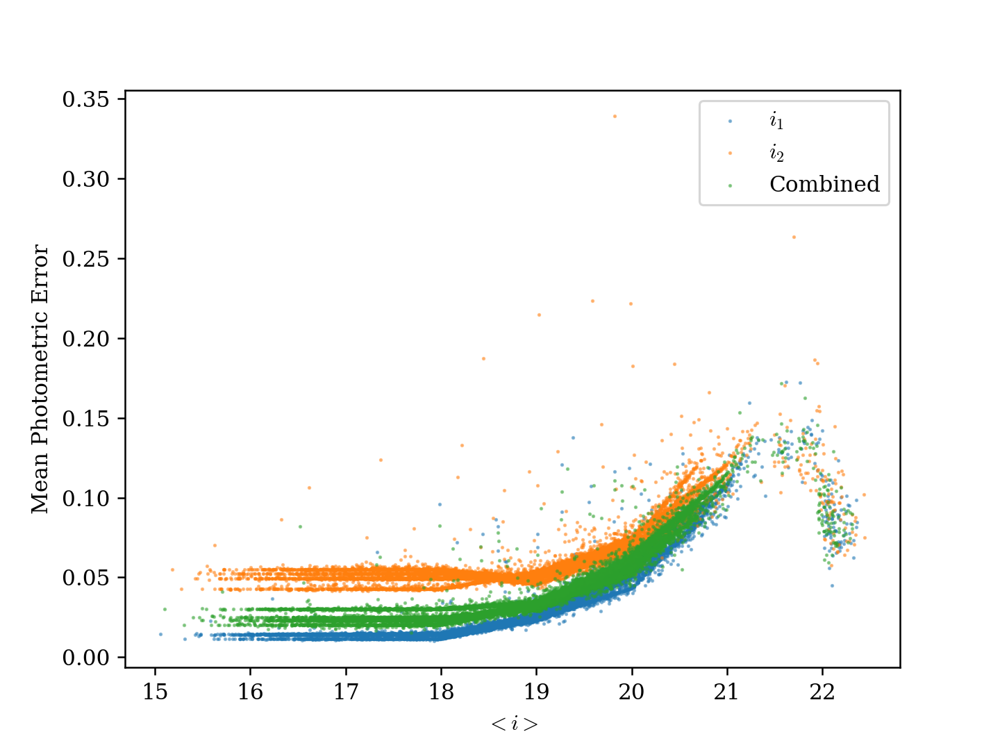

In [21]:
plt.scatter(medians[smallerrs,i1], mean_photo_err_by_filter[smallerrs,i1], s=0.5, alpha=0.5, label=r'$i_1$')
plt.scatter(medians[smallerrs,i2], mean_photo_err_by_filter[smallerrs,i2], s=0.5, alpha=0.5, label=r'$i_2$')
plt.scatter(medians_combined_i[smallerrs,i], photo_err_combined_i[smallerrs,i], s=0.5, alpha=0.5, label='Combined')
plt.ylabel('Mean Photometric Error')
plt.xlabel(r'$<i>$')
plt.legend()

#plt.savefig('./figs/err_vs_mag_ibands.png', bbox_inches='tight')

I thought that maybe the issue was in the mean photometric error calculation, so I repeated what I did above but calculated the median of the photometric errors instead to see if anything would change.

In [22]:
def get_med_photo_err(file_list, by_filter=False):
    """
    Function that obtains the median photometric measurement error in each filter for each object.
    
    Parameters
    ---
    file_list : list of str
        List of file paths (eg. one created by os.listdir(folder_path))
    by_filter : bool
        Defaults to False. Set to true to return an array containing number of measurements per filter
        
    Returns
    ---
    errs : ndarray
        Array containing the median of the photometric measurement errors, per object
        If by_filter=False, Nx1 array, where N = number of objects
        If by_filter=True, NxM array, where N = number of objects and M = number of filters.

    """
    if by_filter==False:
        errs = np.empty(len(file_list))
        for i, fname in enumerate(file_list):
            _, _, _, magerrs, _, _, _ = load_one_timeseries(fname)
            errs[i] = np.median(magerrs)
    elif by_filter==True:
        errs = np.empty((len(file_list), 6))
        for i, fname in enumerate(file_list):
            _, _, _, magerrs, _, filters, _ = load_one_timeseries(fname)
            for j in range(6):
                errs[i,j] = np.median(magerrs[filters==j])
    return errs

In [23]:
med_photo_err = get_med_photo_err(file_list)
med_photo_err

array([0.105, 0.166, 0.057, ..., 0.106, 0.132, 0.102])

In [24]:
med_smallerrs = med_photo_err<0.1
np.sum(med_smallerrs)

18629

In [25]:
med_photo_err_by_filter = get_med_photo_err(file_list, by_filter=True)
med_photo_err_by_filter

array([[0.172 , 0.079 , 0.086 , 0.093 , 0.103 , 0.231 ],
       [0.174 , 0.113 , 0.157 , 0.139 , 0.1915, 0.318 ],
       [0.0855, 0.044 , 0.051 , 0.056 , 0.062 , 0.139 ],
       ...,
       [0.061 , 0.097 , 0.101 , 0.143 , 0.152 , 0.    ],
       [0.899 , 0.153 , 0.068 , 0.163 , 0.186 , 0.    ],
       [0.109 , 0.055 , 0.11  , 0.103 , 0.1175, 0.088 ]])

In [26]:
med_photo_err_combined_i = np.empty((len(file_list), 5))
med_photo_err_combined_i[:,0] = med_photo_err_by_filter[:,0] # u
med_photo_err_combined_i[:,1] = med_photo_err_by_filter[:,1] # g
med_photo_err_combined_i[:,2] = med_photo_err_by_filter[:,2] # r
med_photo_err_combined_i[:,4] = med_photo_err_by_filter[:,5] # z

for i, fname in enumerate(file_list):
    _, _, _, magerrs, _, filters, _ = load_one_timeseries(fname)
    transformed_magerrs_i1_to_i2 = (1-fit_coeffs[0])*magerrs[filters==i1]
    med_photo_err_combined_i[i,3] = np.median(np.concatenate((magerrs[filters==i2], transformed_magerrs_i1_to_i2)))

In [27]:
u = 0
g = 1
r = 2
i = 3
z = 4

<IPython.core.display.Javascript object>


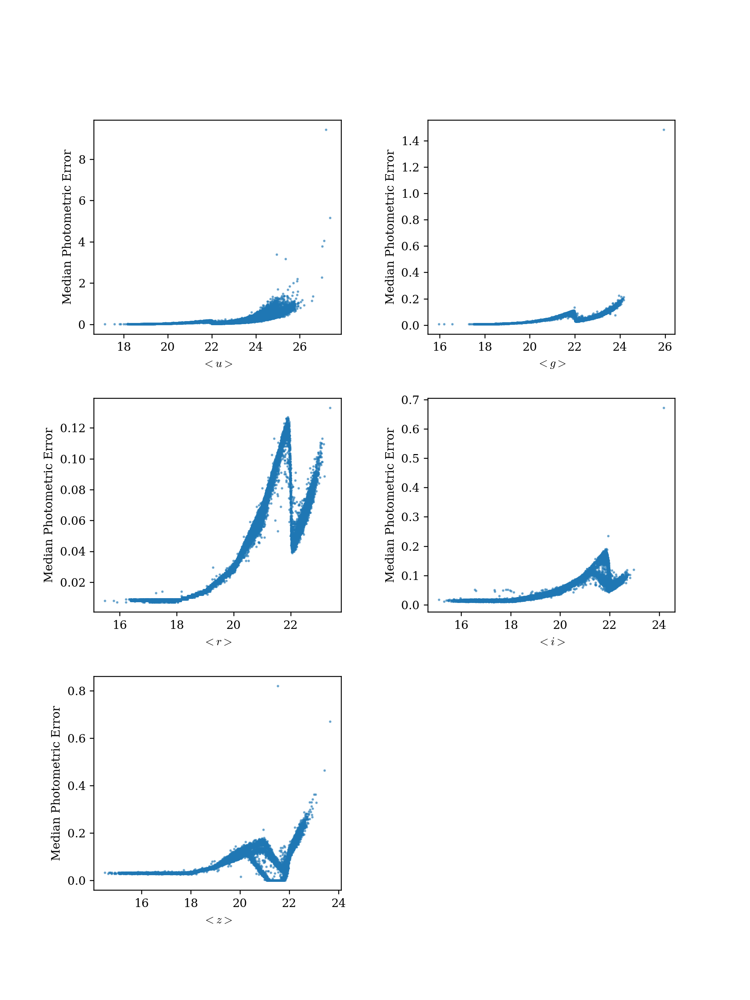

In [28]:
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(medians_combined_i[med_smallerrs,j], med_photo_err_combined_i[med_smallerrs,j], s=1.5, alpha=0.5)
    ax.set_ylabel('Median Photometric Error')
    ax.set_xlabel(r'$<%s>$' % band)

#plt.savefig('./figs/usingmedians_err_vs_mag_smallerrs.png', bbox_inches='tight')

The dip/kink is still visible even when the median is used, so it seems to be something in the data and not the calculations. Maybe there's something weird going on in one of the fields that's driving the pattern we see in the plots.

In [29]:
def get_fields(file_list):
    """
    Function that a list of the CFHTLS field (eg. D1, D2, D3, or D4) each object is found in.
    
    Parameters
    ---
    file_list : list of str
        List of file paths (eg. one created by os.listdir(folder_path))
        
    Returns
    ---
    fields : ndarray
        Array containing the field each object is found in (str)

    """
    fields = []
    for fname in file_list:
        field, _, _, _, _, _, _ = load_one_timeseries(fname)
        fields.append(field)
    fields = np.asarray(fields)
    
    return fields

In [30]:
fields = get_fields(file_list)
fields

array(['D1', 'D1', 'D1', ..., 'D4', 'D4', 'D4'], dtype='<U2')

<IPython.core.display.Javascript object>


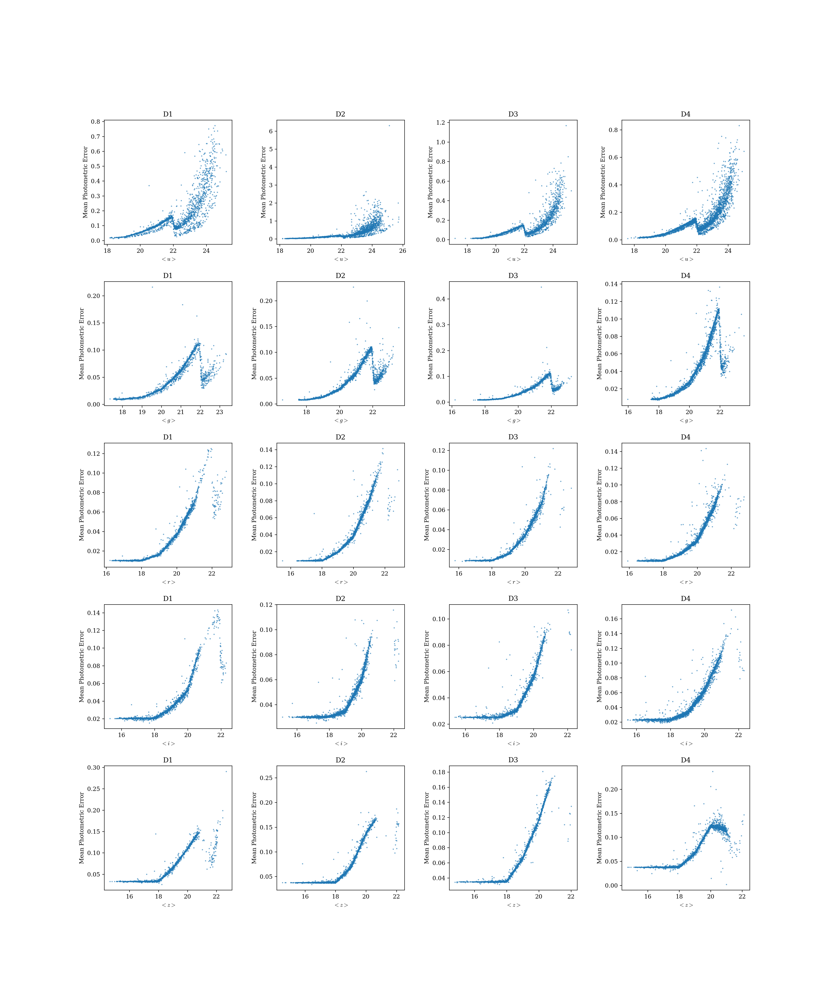

In [31]:
# mean photometric error as a function of median magnitude, per band, per field

fig = plt.figure(figsize=(20,24))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    for d, field in enumerate(['D1', 'D2', 'D3', 'D4']):
        ax = fig.add_subplot(5,4,(4*j)+d+1)
        toplot = np.logical_and(smallerrs, fields==field)
        ax.scatter(medians_combined_i[toplot,j], photo_err_combined_i[toplot,j], s=1.5, alpha=0.5)
        ax.set_ylabel('Mean Photometric Error')
        ax.set_xlabel(r'$<%s>$' % band)
        ax.set_title(field)

#plt.savefig('./figs/err_vs_mag_smallerrs_byfield.png', bbox_inches='tight')

Since the photometric error kink seems to be present in all of the fields, that isn't the cause either. Another explanation for the sudden dip in mean (or median) photometric error at dimmer magnitudes could be attributed to those dimmer objects having been observed longer. In that case, the dimmer objects might have lower photometric errors as well as longer exposure times.

To investigate this, you'll need to download information from CFHTLS on the input images. The files are located [here](https://www.cadc-ccda.hia-iha.nrc-cnrc.gc.ca/en/megapipe/cfhtls/input.html); you want all the data in the Deep Fields (full) table. I put all of the text files from the site into a folder called "fields" in the same directory as this notebook, but as before, you can just change the file path if you choose to put the files somewhere else.

In [32]:
field_info_list = os.listdir('fields') # like before, creates a Python list of paths to the exposure data

In [33]:
def process_exposure_info(file_list):
    """
    Function that takes the CFHTLS exposure data from the input images and extracts the exposure numbers and times
    
    Parameters
    ---
    file_list : list of str
        List of file paths (eg. one created by os.listdir(folder_path))
        
    Returns
    ---
    expnums : ndarray
        Array of all exposure numbers from every file in file_list
    exptimes : ndarray
        Array of exposure times in seconds corresponding to each entry in expnums
    """
    expnums = []
    exptimes = []
    
    for fname in file_list:
        with open('fields/'+fname) as data_file:
            for line in data_file:
                if not line.startswith('#'):
                    data = line.split()
                    if len(data)==0:
                        continue
                    expnums.append(data[0])
                    exptimes.append(data[3])
    
    expnums = np.asarray(expnums, dtype=int)
    exptimes = np.asarray(exptimes, dtype=float)
    
    return expnums, exptimes

In [34]:
def get_avg_exptimes(file_list, field_info_list):
    """
    Function that calculates the mean exposure time for all measurements in a given band for each object
    
    Parameters
    ---
    file_list : list of str
        List of file paths (eg. one created by os.listdir(folder_path)) for all objects
    field_info_list : list of str
        List of file paths for all CFHTLS data files containing exposure data for the input images
        
    Returns
    ---
    avg_exptimes : ndarray
        MxN array containing the mean of available exposure times for a given filter and object
        M is the number of objects and N is the number of filters
    percent_available : ndarray
        MxN array containing the percentage of measurements for a given filter and object with an available exposure time
        M is the number of objects and N is the number of filters
    """
    avg_exptimes = np.empty((len(file_list),6))
    percent_available = np.empty((len(file_list),6))
    field_expnums, field_exptimes = process_exposure_info(field_info_list)
    
    for i, fname in enumerate(file_list):
        _, _, _, _, expnums, filters, _ = load_one_timeseries(fname)
        
        for j in range(6):
            in_filter = filters==j
            exptimes = np.empty(len(expnums[in_filter]))
            for k, expnum in enumerate(expnums[in_filter]):
                ind = np.where(expnum==field_expnums)[0]
                if len(ind)==1:
                    exptimes[k] = field_exptimes[ind]
                elif len(ind)==0:
                    exptimes[k] = np.nan
            
            with warnings.catch_warnings():
                warnings.simplefilter(action='ignore', category=RuntimeWarning)
                avg_exptimes[i,j] = np.nanmean(exptimes)
                percent_available[i,j] = 100*((np.sum(~np.isnan(exptimes)))/(len(exptimes)))
        
    return avg_exptimes, percent_available

In [35]:
avg_exptimes, percent_available = get_avg_exptimes(file_list, field_info_list)

# the CFHTLS site did not have any exposure information for the second i-band filter for some reason, so I deleted that column
# feel free to check this for yourself! 
avg_exptimes = np.delete(avg_exptimes, 4, 1)

<IPython.core.display.Javascript object>


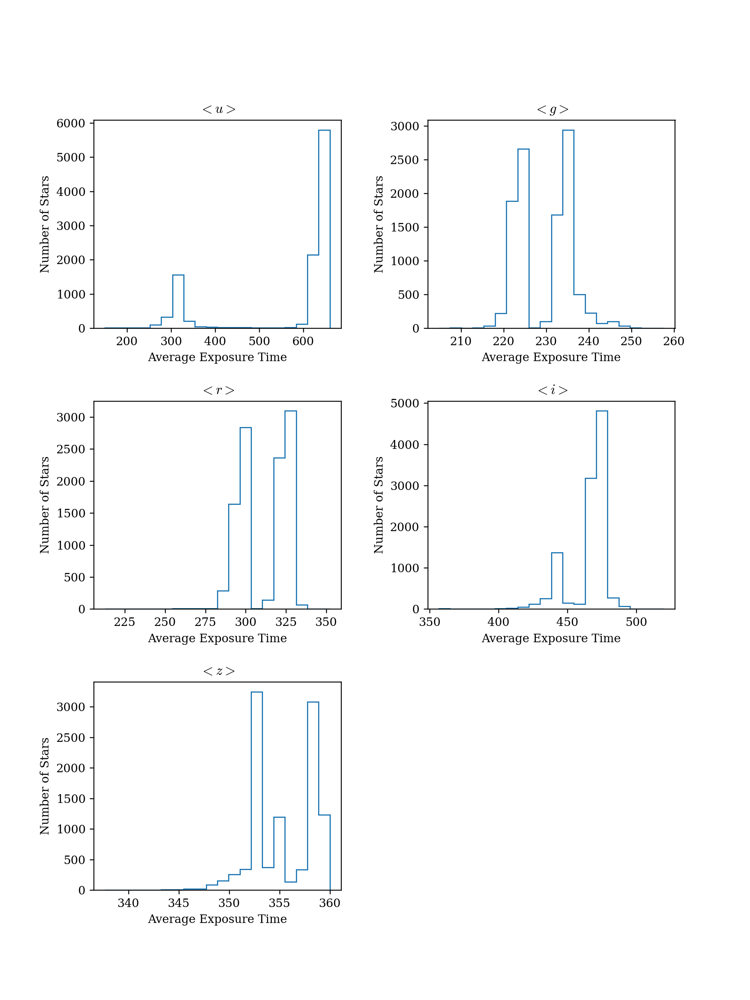

In [36]:
# histogram of the average exposure times, per band. note not all stars have exposure time information

fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.35)

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,j+1)
    has_exptimes = ~np.isnan(avg_exptimes[:,j])
    keep = np.logical_and(smallerrs, has_exptimes)
    ax.hist(avg_exptimes[keep,j], bins=20, histtype='step')
    ax.set_ylabel('Number of Stars')
    ax.set_xlabel('Average Exposure Time')
    ax.set_title(r'$<%s>$' % band)
    
#plt.savefig('./figs/avg_exptime_hists.png', bbox_inches='tight')

In [37]:
# prints the average exposure time as well as the maximum and minimum for each filter
for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    has_exptimes = ~np.isnan(avg_exptimes[:,j])
    keep = np.logical_and(smallerrs, has_exptimes)
    avg_exptime = np.mean(avg_exptimes[keep,j])
    min_exptime = (avg_exptimes[keep,j]).min()
    max_exptime = (avg_exptimes[keep,j]).max()
    print('%s filter: %f, (%f, %f)' % (band, avg_exptime, min_exptime, max_exptime))

u filter: 567.467630, (150.000000, 660.000000)
g filter: 229.663485, (204.767442, 257.608696)
r filter: 310.574665, (212.727273, 352.222222)
i filter: 466.197228, (356.687898, 520.000000)
z filter: 355.541197, (337.674419, 360.000000)


<IPython.core.display.Javascript object>


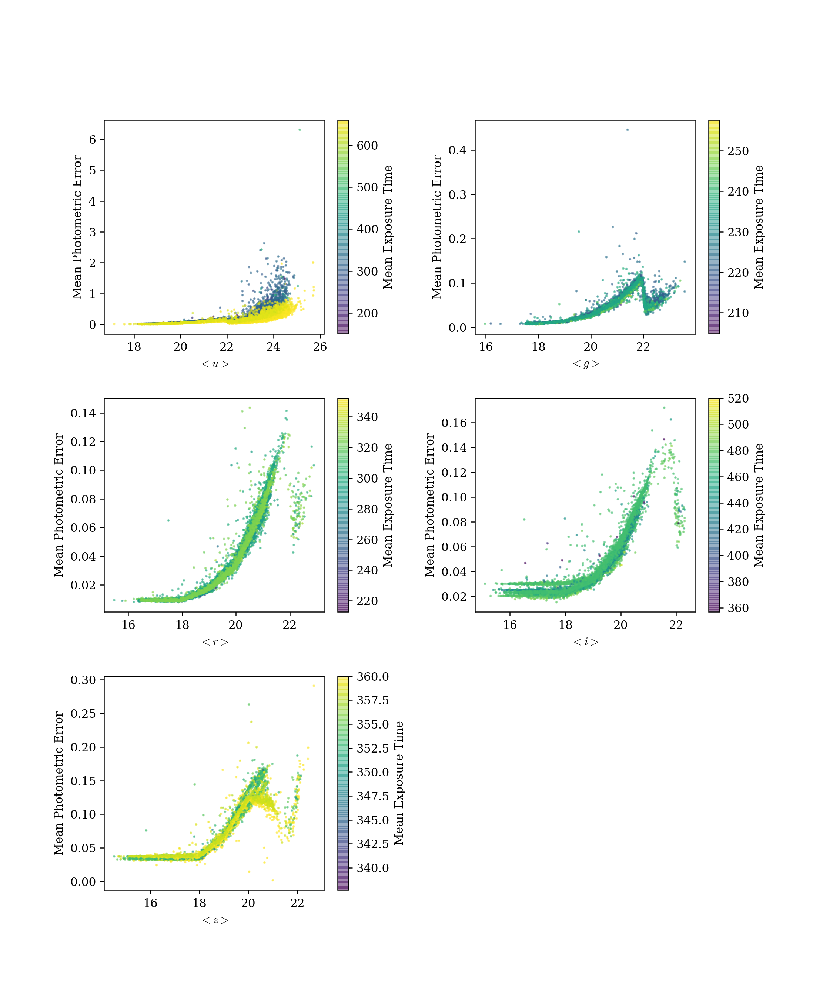

In [38]:
# this is just the same plot as before of mean photometric error as a function of median magnitude
# but this time we color all the objects in the plot by their average exposure time

fig = plt.figure(figsize=(10,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,j+1)
    has_exptimes = ~np.isnan(avg_exptimes[:,j])
    keep = np.logical_and(smallerrs, has_exptimes)
    im = ax.scatter(medians_combined_i[keep,j], photo_err_combined_i[keep,j], s=1.5, alpha=0.5, c=avg_exptimes[keep,j])
    ax.set_ylabel('Mean Photometric Error')
    ax.set_xlabel(r'$<%s>$' % band)
    cbar = plt.colorbar(im)
    cbar.set_label('Mean Exposure Time')
    
#plt.savefig('./figs/err_vs_mag_smallerrs_coloredbyexptime.png', bbox_inches='tight')

If the exposure times were related to the sharp drop we see in the mean photometric error, we would see a color gradient along the curve with higher mean exposure times at dimmer magnitude. We don't see this, however - let's do the same thing but with median exposure times just to check.

In [39]:
def get_median_exptimes(file_list, field_info_list):
    """
    Function that calculates the median exposure time for all measurements in a given band for each object
    
    Parameters
    ---
    file_list : list of str
        List of file paths (eg. one created by os.listdir(folder_path)) for all objects
    field_info_list : list of str
        List of file paths for all CFHTLS data files containing exposure data for the input images
        
    Returns
    ---
    med_exptimes : ndarray
        MxN array containing the median of available exposure times for a given filter and object
        M is the number of objects and N is the number of filters
    """
    med_exptimes = np.empty((len(file_list),6))
    field_expnums, field_exptimes = process_exposure_info(field_info_list)
    
    for i, fname in enumerate(file_list):
        _, _, _, _, expnums, filters, _ = load_one_timeseries(fname)
        
        for j in range(6):
            in_filter = filters==j
            exptimes = np.empty(len(expnums[in_filter]))
            for k, expnum in enumerate(expnums[in_filter]):
                ind = np.where(expnum==field_expnums)[0]
                if len(ind)==1:
                    exptimes[k] = field_exptimes[ind]
                elif len(ind)==0:
                    exptimes[k] = np.nan
            
            with warnings.catch_warnings():
                warnings.simplefilter(action='ignore', category=RuntimeWarning)
                med_exptimes[i,j] = np.median(exptimes[~np.isnan(exptimes)])
        
    return med_exptimes

In [40]:
med_exptimes = get_median_exptimes(file_list, field_info_list)
med_exptimes = np.delete(med_exptimes, 4, 1)

<IPython.core.display.Javascript object>


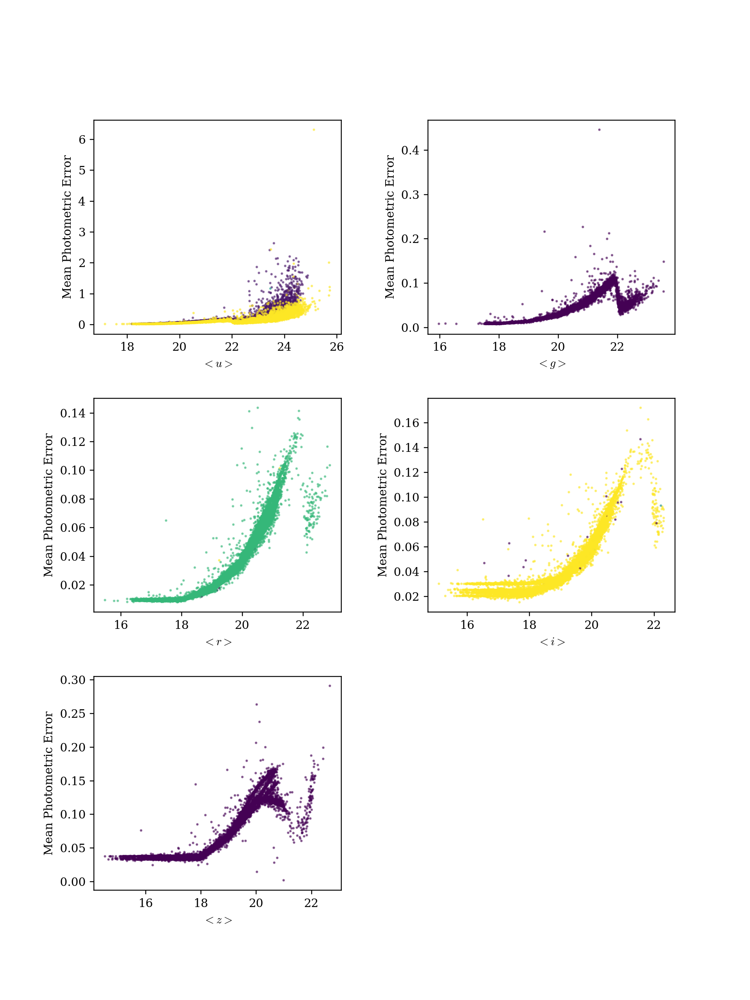

In [41]:
# the same plot as before; this time we color all the objects in the plot by their median exposure time

fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,j+1)
    has_exptimes = ~np.isnan(med_exptimes[:,j])
    keep = np.logical_and(smallerrs, has_exptimes)
    ax.scatter(medians_combined_i[keep,j], photo_err_combined_i[keep,j], s=1.5, alpha=0.5, c=med_exptimes[keep,j])
    ax.set_ylabel('Mean Photometric Error')
    ax.set_xlabel(r'$<%s>$' % band)

With the median, some filters don't even have variation in exposure times, much less variation in exposure times that is correlated with variation in mean photometric error and median magnitude. It seems that exposure time isn't the cause of the kink in the plots either.

Just to make sure of these results, let's plot the same data a slightly different way:

<IPython.core.display.Javascript object>


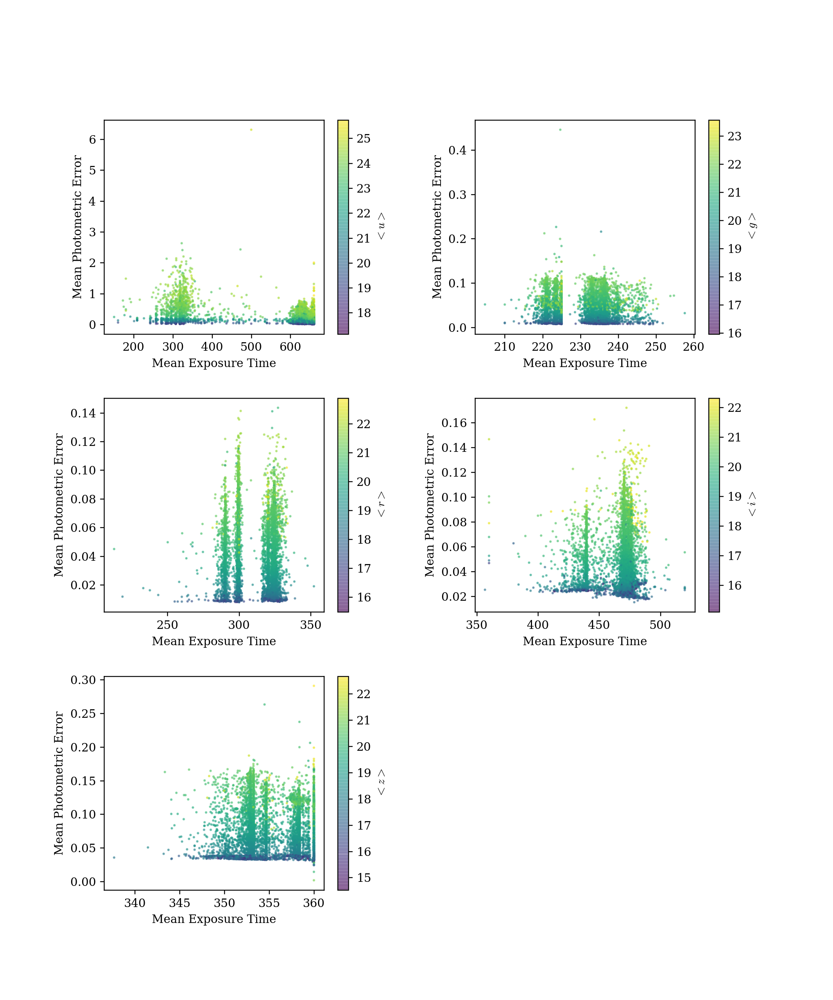

In [42]:
fig = plt.figure(figsize=(10,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,j+1)
    has_exptimes = ~np.isnan(avg_exptimes[:,j])
    keep = np.logical_and(smallerrs, has_exptimes)
    im = ax.scatter(avg_exptimes[keep,j], photo_err_combined_i[keep,j], s=1.5, alpha=0.5, c=medians_combined_i[keep,j])
    ax.set_ylabel('Mean Photometric Error')
    ax.set_xlabel('Mean Exposure Time')
    cbar = plt.colorbar(im)
    cbar.set_label(r'$<%s>$' % band)
    
#plt.savefig('./figs/err_vs_exptime_smallerrs_coloredbymag.png', bbox_inches='tight')

<IPython.core.display.Javascript object>


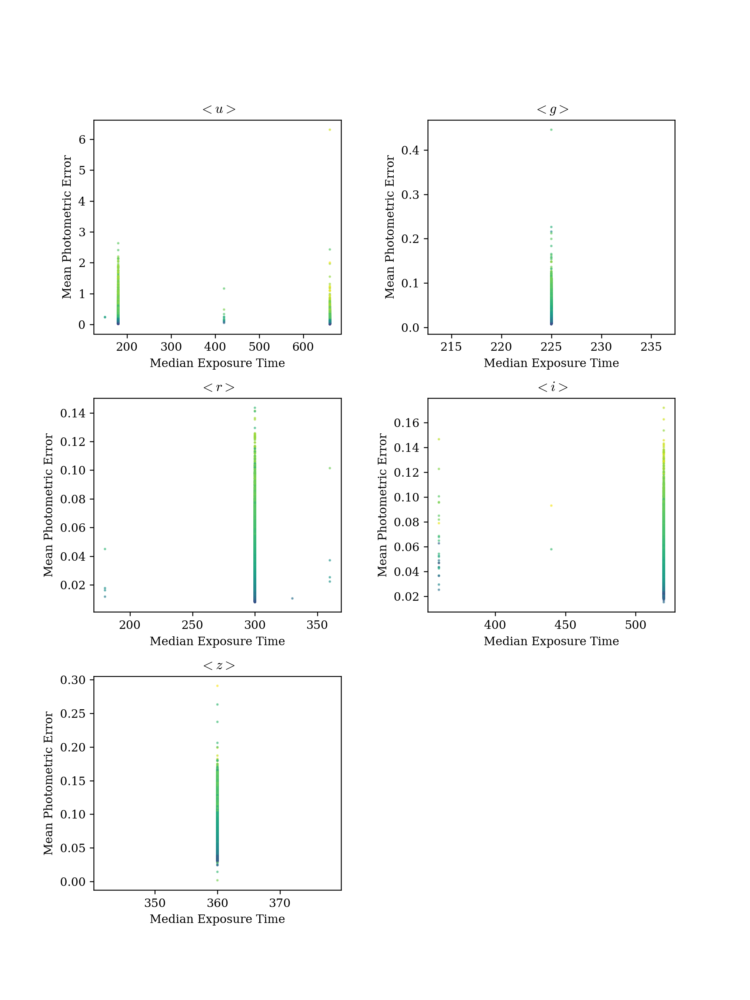

In [43]:
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,j+1)
    has_exptimes = ~np.isnan(med_exptimes[:,j])
    keep = np.logical_and(smallerrs, has_exptimes)
    ax.scatter(med_exptimes[keep,j], photo_err_combined_i[keep,j], s=1.5, alpha=0.5, c=medians_combined_i[keep,j])
    ax.set_ylabel('Mean Photometric Error')
    ax.set_xlabel('Median Exposure Time')
    ax.set_title(r'$<%s>$' % band)

One more different way to visualize this data: the histograms of the mean exposure times from before are all pretty clearly bimodal. So I split the mean exposure times into "high" and "low" categories by eye, and then plot just the objects that fall into each category on the same mean photometric error vs. median magnitude plot.

<IPython.core.display.Javascript object>


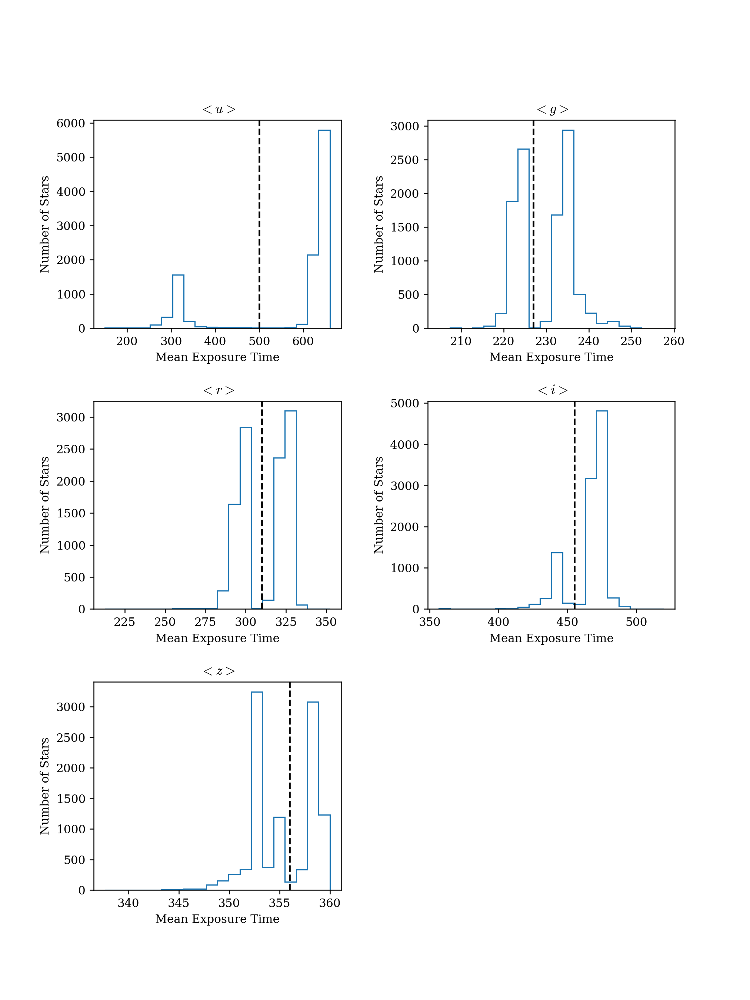

Text(0.5, 1.0, '$<z>$')

In [44]:
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.35)

ax1 = fig.add_subplot(3,2,1)
keep_u = np.logical_and(smallerrs, ~np.isnan(avg_exptimes[:,u]))
u_exp_cutoff=500
ax1.hist(avg_exptimes[keep_u,u], bins=20, histtype='step')
ax1.axvline(x=u_exp_cutoff, c='k', ls='--')
ax1.set_ylabel('Number of Stars')
ax1.set_xlabel('Mean Exposure Time')
ax1.set_title(r'$<u>$')

ax2 = fig.add_subplot(3,2,2)
keep_g = np.logical_and(smallerrs, ~np.isnan(avg_exptimes[:,g]))
g_exp_cutoff=227
ax2.hist(avg_exptimes[keep_g,g], bins=20, histtype='step')
ax2.axvline(x=g_exp_cutoff, c='k', ls='--')
ax2.set_ylabel('Number of Stars')
ax2.set_xlabel('Mean Exposure Time')
ax2.set_title(r'$<g>$')

ax3 = fig.add_subplot(3,2,3)
keep_r = np.logical_and(smallerrs, ~np.isnan(avg_exptimes[:,r]))
r_exp_cutoff=310
ax3.hist(avg_exptimes[keep_r,r], bins=20, histtype='step')
ax3.axvline(x=r_exp_cutoff, c='k', ls='--')
ax3.set_ylabel('Number of Stars')
ax3.set_xlabel('Mean Exposure Time')
ax3.set_title(r'$<r>$')

ax4 = fig.add_subplot(3,2,4)
keep_i = np.logical_and(smallerrs, ~np.isnan(avg_exptimes[:,i]))
i_exp_cutoff=455
ax4.hist(avg_exptimes[keep_i,i], bins=20, histtype='step')
ax4.axvline(x=i_exp_cutoff, c='k', ls='--')
ax4.set_ylabel('Number of Stars')
ax4.set_xlabel('Mean Exposure Time')
ax4.set_title(r'$<i>$')

ax5 = fig.add_subplot(3,2,5)
keep_z = np.logical_and(smallerrs, ~np.isnan(avg_exptimes[:,z]))
z_exp_cutoff=356
ax5.hist(avg_exptimes[keep_z,z], bins=20, histtype='step')
ax5.axvline(x=z_exp_cutoff, c='k', ls='--')
ax5.set_ylabel('Number of Stars')
ax5.set_xlabel('Mean Exposure Time')
ax5.set_title(r'$<z>$')

#plt.savefig('./figs/avg_exptime_hists_withcutoffs.png', bbox_inches='tight')

<IPython.core.display.Javascript object>


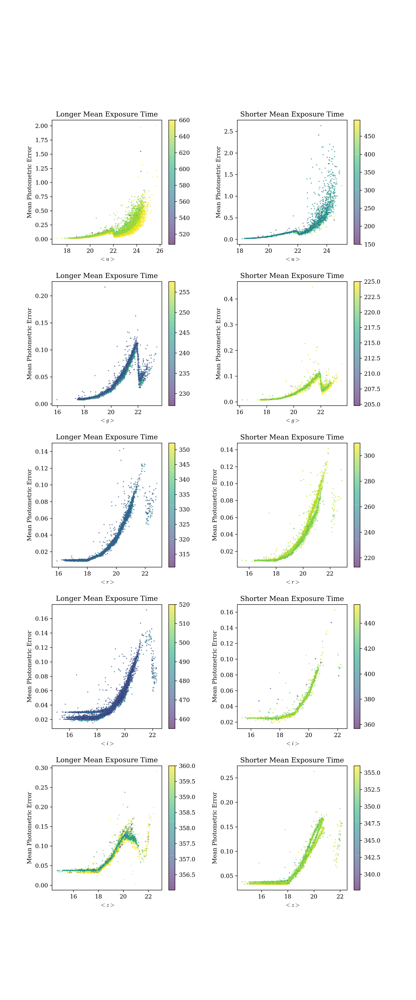

Text(0.5, 1.0, 'Shorter Mean Exposure Time')

In [45]:
# the warnings I set to ignore here are because there are nan values in the exposure time arrays due to some exposure times not being available
fig = plt.figure(figsize=(10,24))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

axu1 = fig.add_subplot(5,2,1)
with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    keep_u1 = np.logical_and(keep_u, avg_exptimes[:,u]>u_exp_cutoff)
imu1 = axu1.scatter(medians_combined_i[keep_u1,u], photo_err_combined_i[keep_u1,u], s=1.5, alpha=0.5, c=avg_exptimes[keep_u1,u])
plt.colorbar(imu1)
axu1.set_ylabel('Mean Photometric Error')
axu1.set_xlabel(r'$<u>$')
axu1.set_title('Longer Mean Exposure Time')
axu2 = fig.add_subplot(5,2,2)
with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    keep_u2 = np.logical_and(keep_u, avg_exptimes[:,u]<u_exp_cutoff)
imu2 = axu2.scatter(medians_combined_i[keep_u2,u], photo_err_combined_i[keep_u2,u], s=1.5, alpha=0.5, c=avg_exptimes[keep_u2,u])
plt.colorbar(imu2)
axu2.set_ylabel('Mean Photometric Error')
axu2.set_xlabel(r'$<u>$')
axu2.set_title('Shorter Mean Exposure Time')

axg1 = fig.add_subplot(5,2,3)
with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    keep_g1 = np.logical_and(keep_g, avg_exptimes[:,g]>g_exp_cutoff)
img1 = axg1.scatter(medians_combined_i[keep_g1,g], photo_err_combined_i[keep_g1,g], s=1.5, alpha=0.5, c=avg_exptimes[keep_g1,g])
plt.colorbar(img1)
axg1.set_ylabel('Mean Photometric Error')
axg1.set_xlabel(r'$<g>$')
axg1.set_title('Longer Mean Exposure Time')
axg2 = fig.add_subplot(5,2,4)
with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    keep_g2 = np.logical_and(keep_g, avg_exptimes[:,g]<g_exp_cutoff)
img2 = axg2.scatter(medians_combined_i[keep_g2,g], photo_err_combined_i[keep_g2,g], s=1.5, alpha=0.5, c=avg_exptimes[keep_g2,g])
plt.colorbar(img2)
axg2.set_ylabel('Mean Photometric Error')
axg2.set_xlabel(r'$<g>$')
axg2.set_title('Shorter Mean Exposure Time')

axr1 = fig.add_subplot(5,2,5)
with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    keep_r1 = np.logical_and(keep_r, avg_exptimes[:,r]>r_exp_cutoff)
imr1 = axr1.scatter(medians_combined_i[keep_r1,r], photo_err_combined_i[keep_r1,r], s=1.5, alpha=0.5, c=avg_exptimes[keep_r1,r])
plt.colorbar(imr1)
axr1.set_ylabel('Mean Photometric Error')
axr1.set_xlabel(r'$<r>$')
axr1.set_title('Longer Mean Exposure Time')
axr2 = fig.add_subplot(5,2,6)
with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    keep_r2 = np.logical_and(keep_r, avg_exptimes[:,r]<r_exp_cutoff)
imr2 = axr2.scatter(medians_combined_i[keep_r2,r], photo_err_combined_i[keep_r2,r], s=1.5, alpha=0.5, c=avg_exptimes[keep_r2,r])
plt.colorbar(imr2)
axr2.set_ylabel('Mean Photometric Error')
axr2.set_xlabel(r'$<r>$')
axr2.set_title('Shorter Mean Exposure Time')

axi1 = fig.add_subplot(5,2,7)
with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    keep_i1 = np.logical_and(keep_i, avg_exptimes[:,i]>i_exp_cutoff)
imi1 = axi1.scatter(medians_combined_i[keep_i1,i], photo_err_combined_i[keep_i1,i], s=1.5, alpha=0.5, c=avg_exptimes[keep_i1,i])
plt.colorbar(imi1)
axi1.set_ylabel('Mean Photometric Error')
axi1.set_xlabel(r'$<i>$')
axi1.set_title('Longer Mean Exposure Time')
axi2 = fig.add_subplot(5,2,8)
with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    keep_i2 = np.logical_and(keep_i, avg_exptimes[:,i]<i_exp_cutoff)
imi2 = axi2.scatter(medians_combined_i[keep_i2,i], photo_err_combined_i[keep_i2,i], s=1.5, alpha=0.5, c=avg_exptimes[keep_i2,i])
plt.colorbar(imi2)
axi2.set_ylabel('Mean Photometric Error')
axi2.set_xlabel(r'$<i>$')
axi2.set_title('Shorter Mean Exposure Time')

axz1 = fig.add_subplot(5,2,9)
with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    keep_z1 = np.logical_and(keep_z, avg_exptimes[:,z]>z_exp_cutoff)
imz1 = axz1.scatter(medians_combined_i[keep_z1,z], photo_err_combined_i[keep_z1,z], s=1.5, alpha=0.5, c=avg_exptimes[keep_z1,z])
plt.colorbar(imz1)
axz1.set_ylabel('Mean Photometric Error')
axz1.set_xlabel(r'$<z>$')
axz1.set_title('Longer Mean Exposure Time')
axz2 = fig.add_subplot(5,2,10)
with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    keep_z2 = np.logical_and(keep_z, avg_exptimes[:,z]<z_exp_cutoff)
imz2 = axz2.scatter(medians_combined_i[keep_z2,z], photo_err_combined_i[keep_z2,z], s=1.5, alpha=0.5, c=avg_exptimes[keep_z2,z])
plt.colorbar(imz2)
axz2.set_ylabel('Mean Photometric Error')
axz2.set_xlabel(r'$<z>$')
axz2.set_title('Shorter Mean Exposure Time')

#plt.savefig('./figs/err_vs_mag_smallerrs_bymeanexptime.png', bbox_inches='tight')

In [46]:
# this is just to see, on average, what percentage of measurements had available exposure times in each band
np.mean(percent_available, axis=0)

array([ 77.0442269 ,  88.29909622,  93.13112113, 100.        ,
         0.        ,  94.72689066])

We were never really able to figure out what was causing the weird behavior with the photometric measurement error. But will this really affect the rest of our results (in terms of looking for variation in the light curves)?

A great way to initially detect variation in light curves is by examining the root-mean-square variation or standard deviation.

In [47]:
def get_stddevs(file_list, by_filter=True):
    """
    Function that obtains the standard deviation of magnitude measurements for each object.
    
    Parameters
    ---
    file_list : list of str
        List of file paths (eg. one created by os.listdir(folder_path))
    by_filter : bool
        Defaults to False. Set to true to return an array containing standard deviation per filter
        
    Returns
    ---
    stddevs : ndarray
        Array containing the standard deviation of magnitude measurements, per object
        If by_filter=False, Nx1 array, where N = number of objects
        If by_filter=True, NxM array, where N = number of objects and M = number of filters.

    """
    if by_filter==True:
        stddevs = np.empty((len(file_list), 6))
        for i, fname in enumerate(file_list):
            _, _, mags, _, _, filters, _ = load_one_timeseries(fname)
            for j in range(6):
                stddevs[i,j] = np.std(mags[filters==j])
    
    elif by_filter==False:
        stddevs = np.empty(len(file_list))
        for i, fname in enumerate(file_list):
            _, _, mags, _, _, _, _ = load_one_timeseries(fname)
            stddevs[i] = np.std(mags)
        
    return stddevs

In [48]:
stddevs = get_stddevs(file_list)
stddevs

array([[0.63936489, 0.18823686, 0.22338088, 0.22677469, 0.27173085,
        0.57432757],
       [0.58255565, 0.29567023, 0.33855491, 0.38063248, 0.51276636,
        0.85036199],
       [0.38143452, 0.1260749 , 0.12437605, 0.20355832, 0.22785955,
        0.51796206],
       ...,
       [0.24838542, 0.19372692, 0.23038799, 0.08752097, 0.30596704,
        0.21717727],
       [1.39078282, 0.26248386, 0.12246309, 0.09493559, 0.13213011,
        0.28111725],
       [0.6841024 , 0.52870073, 0.43662971, 0.2744726 , 0.32974652,
        0.24918938]])

As we did to calculate the median magnitudes, we have to transform the two different i-band filters onto the same scale and recalculate the standard deviation with the new i-band values.

In [49]:
stddevs_combined_i = np.empty((len(file_list), 5))
stddevs_combined_i[:,0] = stddevs[:,0] # u
stddevs_combined_i[:,1] = stddevs[:,1] # g
stddevs_combined_i[:,2] = stddevs[:,2] # r
stddevs_combined_i[:,4] = stddevs[:,5] # z

for i, fname in enumerate(file_list):
    _, _, mags, _, _, filters, _ = load_one_timeseries(fname)
    transformed_mags_i1_to_i2 = mags[filters==i1] + fit(medians[i,g]-medians[i,i1])
    stddevs_combined_i[i,3] = np.std(np.concatenate((mags[filters==i2], transformed_mags_i1_to_i2)))

<IPython.core.display.Javascript object>


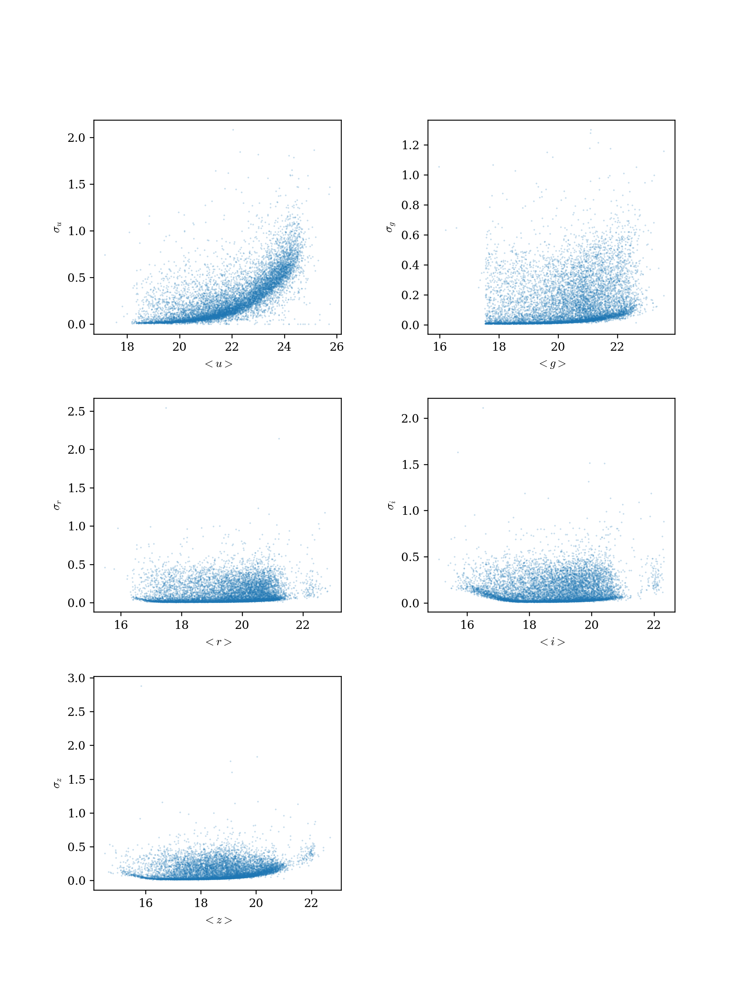

In [50]:
# plot standard deviation as a function of median magnitude (for objects with low average measurement error)
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(medians_combined_i[smallerrs,j], stddevs_combined_i[smallerrs,j], s=0.05, alpha=0.5)
    ax.set_ylabel(r'$\sigma_%s$' % band)
    ax.set_xlabel(r'$<%s>$' % band)
    
#plt.savefig('./figs/stddev_vs_mag_smallerrs.png', bbox_inches='tight')

<IPython.core.display.Javascript object>


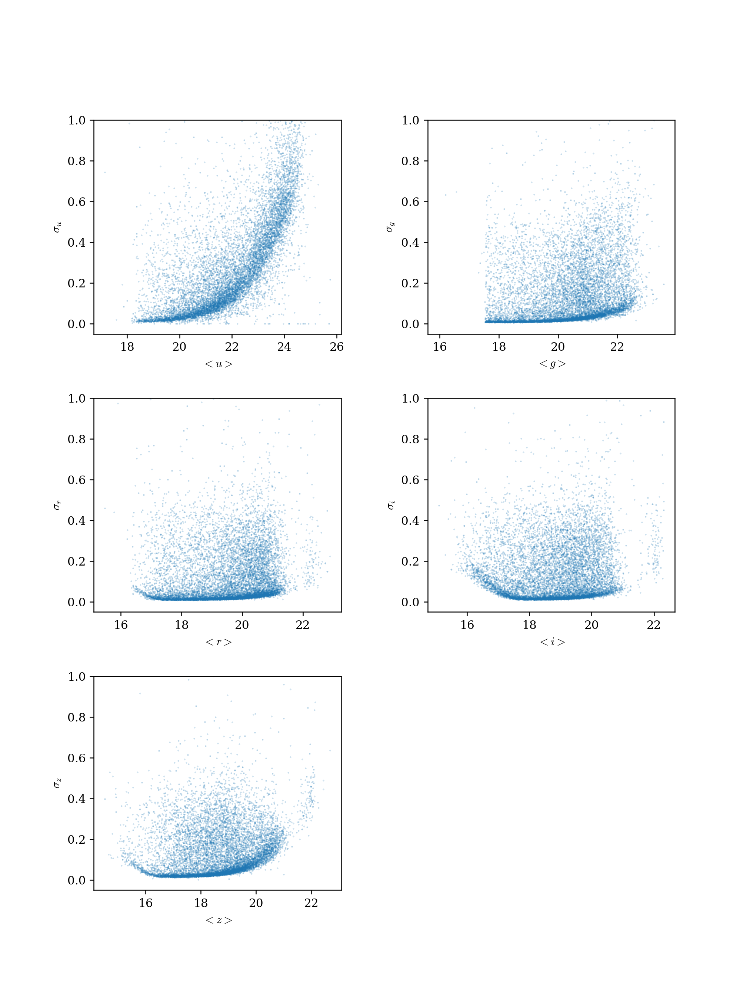

In [51]:
# same as above, but with a limited y-axis consistent throughout all the filters
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(medians_combined_i[smallerrs,j], stddevs_combined_i[smallerrs,j], s=0.05, alpha=0.5)
    ax.set_ylim(-0.05,1)
    ax.set_ylabel(r'$\sigma_%s$' % band)
    ax.set_xlabel(r'$<%s>$' % band)
    
#plt.savefig('./figs/stddev_vs_mag_zoomed_smallerrs.png', bbox_inches='tight')

In [52]:
# just making sure these are still correct in case I reused i as an index
u = 0
g = 1
r = 2
i = 3
z = 4

In [53]:
# calculate colors for all objects based on their median magnitudes
gi_color = medians_combined_i[:,g] - medians_combined_i[:,i]
ug_color = medians_combined_i[:,u] - medians_combined_i[:,g]
iz_color = medians_combined_i[:,i] - medians_combined_i[:,z]
gr_color = medians_combined_i[:,g] - medians_combined_i[:,r]
ri_color = medians_combined_i[:,r] - medians_combined_i[:,i]

A color-color plot can be useful to identify which objects are stars (and therefore possible RR Lyrae candidates), and to check that nothing seems wrong with the time-averaged photometry. In the following plots, the orange points (objects with low average measurement errors) are consistent with being essentially only stars, while some of the blue points (objects with higher average measurement error) could be a mix of stars, distant galaxies, and/or quasars.

<IPython.core.display.Javascript object>


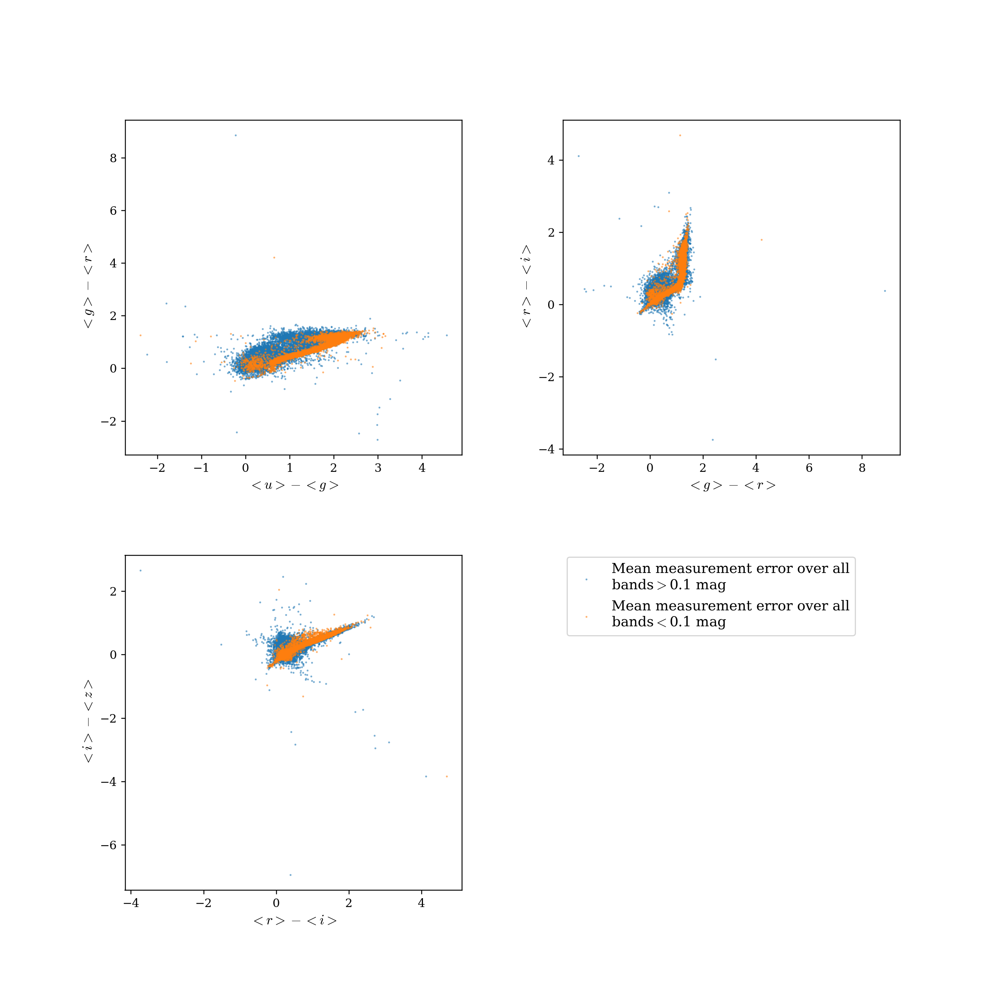

<ipython-input-54-7a623a7fef07>:22: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  fig.legend([higherr, lowerr], labels=['Mean measurement error over all\nbands$>$0.1 mag', 'Mean measurement error over all\nbands$<$0.1 mag'],


In [54]:
fig = plt.figure(figsize=(12,12))
fig.subplots_adjust(wspace=0.3, hspace=0.3)

ax1 = fig.add_subplot(2,2,1)
higherr = ax1.scatter(ug_color[~smallerrs], gr_color[~smallerrs], s=0.5, alpha=0.5)
lowerr = ax1.scatter(ug_color[smallerrs], gr_color[smallerrs], s=0.5, alpha=0.5)
ax1.set_xlabel(r'$<u>-<g>$', fontsize=12)
ax1.set_ylabel(r'$<g>-<r>$', fontsize=12)

ax2 = fig.add_subplot(2,2,2)
ax2.scatter(gr_color[~smallerrs], ri_color[~smallerrs], s=0.5, alpha=0.5)
ax2.scatter(gr_color[smallerrs], ri_color[smallerrs], s=0.5, alpha=0.5)
ax2.set_xlabel(r'$<g>-<r>$', fontsize=12)
ax2.set_ylabel(r'$<r>-<i>$', fontsize=12)

ax3 = fig.add_subplot(2,2,3)
ax3.scatter(ri_color[~smallerrs], iz_color[~smallerrs], s=0.5, alpha=0.5)
ax3.scatter(ri_color[smallerrs], iz_color[smallerrs], s=0.5, alpha=0.5)
ax3.set_xlabel(r'$<r>-<i>$', fontsize=12)
ax3.set_ylabel(r'$<i>-<z>$', fontsize=12)

fig.legend([higherr, lowerr], labels=['Mean measurement error over all\nbands$>$0.1 mag', 'Mean measurement error over all\nbands$<$0.1 mag'],
           loc='upper left', bbox_to_anchor=(0.56, 0, 0.5, 0.45), fontsize=12)

#plt.savefig('./figs/color-color_meanerrs.png')

<IPython.core.display.Javascript object>


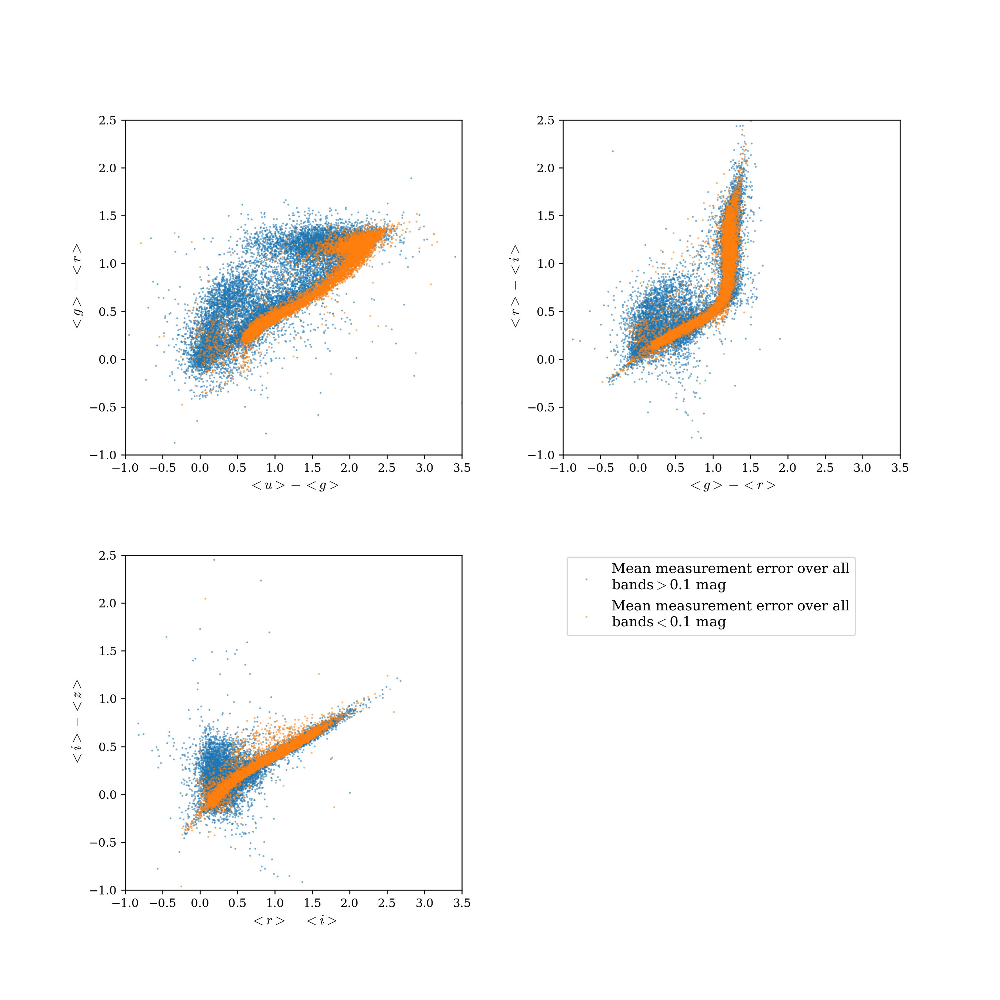

<ipython-input-55-e7e86ccd4478>:29: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  fig.legend([higherr, lowerr], labels=['Mean measurement error over all\nbands$>$0.1 mag', 'Mean measurement error over all\nbands$<$0.1 mag'],


In [55]:
# same plot as above, just zoomed in
fig = plt.figure(figsize=(12,12))
fig.subplots_adjust(wspace=0.3, hspace=0.3)

ax1 = fig.add_subplot(2,2,1)
higherr = ax1.scatter(ug_color[~smallerrs], gr_color[~smallerrs], s=0.5, alpha=0.5)
lowerr = ax1.scatter(ug_color[smallerrs], gr_color[smallerrs], s=0.5, alpha=0.5)
ax1.set_xlim(-1,3.5)
ax1.set_ylim(-1,2.5)
ax1.set_xlabel(r'$<u>-<g>$', fontsize=12)
ax1.set_ylabel(r'$<g>-<r>$', fontsize=12)

ax2 = fig.add_subplot(2,2,2)
ax2.scatter(gr_color[~smallerrs], ri_color[~smallerrs], s=0.5, alpha=0.5)
ax2.scatter(gr_color[smallerrs], ri_color[smallerrs], s=0.5, alpha=0.5)
ax2.set_xlim(-1,3.5)
ax2.set_ylim(-1,2.5)
ax2.set_xlabel(r'$<g>-<r>$', fontsize=12)
ax2.set_ylabel(r'$<r>-<i>$', fontsize=12)

ax3 = fig.add_subplot(2,2,3)
ax3.scatter(ri_color[~smallerrs], iz_color[~smallerrs], s=0.5, alpha=0.5)
ax3.scatter(ri_color[smallerrs], iz_color[smallerrs], s=0.5, alpha=0.5)
ax3.set_xlim(-1,3.5)
ax3.set_ylim(-1,2.5)
ax3.set_xlabel(r'$<r>-<i>$', fontsize=12)
ax3.set_ylabel(r'$<i>-<z>$', fontsize=12)

fig.legend([higherr, lowerr], labels=['Mean measurement error over all\nbands$>$0.1 mag', 'Mean measurement error over all\nbands$<$0.1 mag'],
           loc='upper left', bbox_to_anchor=(0.56, 0, 0.5, 0.45), fontsize=12)

#plt.savefig('./figs/color-color_zoomed_meanerrs.png')

Intuitively, we would expect that dimmer objects are more difficult to observe and thus might have naturally higher variation in their light curves due to uncertainties in their individual measurements. This trend is clearly visible in the following plot of RMS variation in magnitude vs. median magnitude

The plot also shows additional points indicating the median RMS in 0.2 mag bins, colored by the number of objects in each bin (as a rough measure of of the reliability of that median). We expect far more non-variable stars (ie. low RMS) than variable stars in our data, so the median RMS serves as benchmark for the RMS of a non-variable star at a given time-averaged magnitude. However, we notice that the median RMS appears to be unusually high, above an otherwise visible density of points even, in certain filters.

<IPython.core.display.Javascript object>


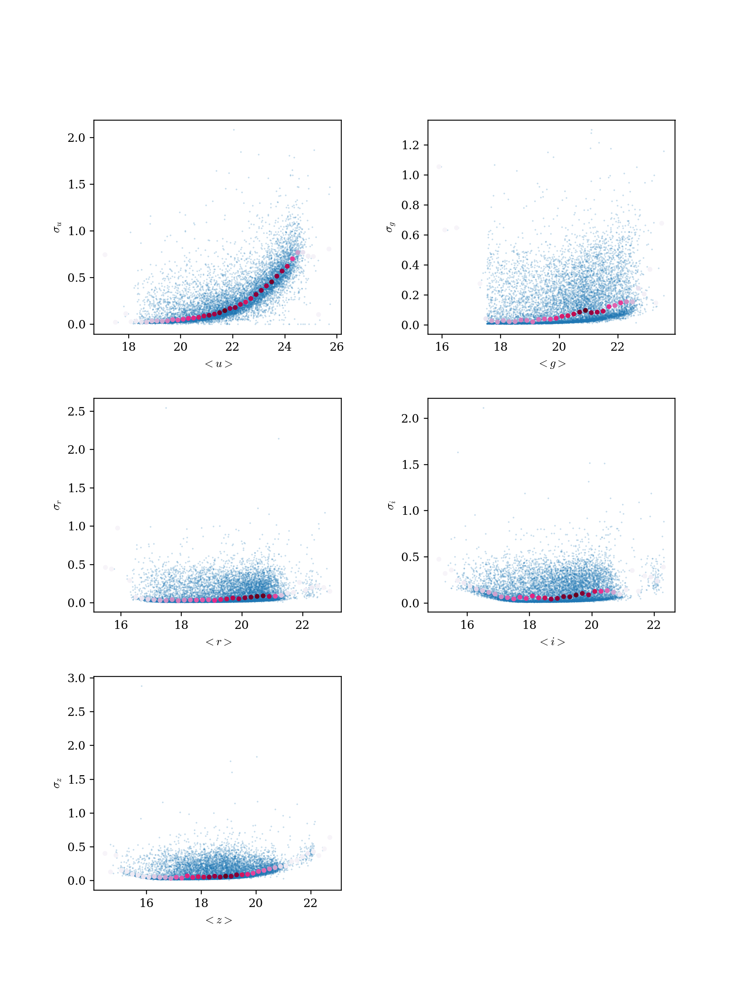

C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [56]:
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

bin_size = 0.2

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    mags = medians_combined_i[smallerrs,j]
    rms = stddevs_combined_i[smallerrs,j]
    start = np.floor(np.min(mags))
    end = np.ceil(np.max(mags))
    mags_plot = np.arange(start+(bin_size/2), end+(bin_size/2), bin_size)
    medrms_plot = np.empty_like(mags_plot)
    num_in_bin = np.empty_like(mags_plot)
    
    for k, mag in enumerate(mags_plot):
        in_bin = np.where((mags>mag-(bin_size/2)) & (mags<mag+(bin_size/2)))[0]
        medrms_plot[k] = np.median(rms[in_bin])
        num_in_bin[k] = len(in_bin)
    
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(mags, rms, s=0.05, alpha=0.5)
    ax.scatter(mags_plot, medrms_plot, s=10, c=num_in_bin, cmap='PuRd') #change cmap='PuRd' if plotting over full dataset
    ax.set_ylabel(r'$\sigma_%s$' % band)
    ax.set_xlabel(r'$<%s>$' % band)
    
#plt.savefig('./figs/medianRMS_vs_mag.png', bbox_inches='tight')

**Annotation left off here**

A possible method for reducing the high median RMS values is sigma clipping - removing outlier measurements in a time series if they are more than a certain number of standard deviations from a central value. To safely do this with our data, however, we need to make sure that there are enough measurements overall to afford removing some. A good benchmark is if most objects have >100 measurements in each filter.

**Meeting notes 11/23**:

~~histograms of # measurements/exposures of each star per filter\
expect sharp peak with sharp cutoff to right and slower cutoff to left(?)~~

~~->sigma clipping if peak counts around 100+ (around 5sigma, iterate until nothing is clipped out)\
if star has large fraction clipped out, be suspicious - could be variable\
most stars will have <10% clipped out~~

~~do different exposure times for u band~~

~~calculate median and rms of rms values (in 0.2 mag bins) - after sigma clipping~~

plot outliers in color-color space

sigma of sigma to identify true variability

typical sigmas of variable stars ~0.5 mag

expect to find about a dozen rr lyrae - look for color/potential variability and redo photometry of maybe a few hundred candidates

check sesar et al catalogs (pan-starrs, 45k) for matches - take ra/dec limits of deep fields and see if any PS1 3pi rr lyrae are in there

variability in quasars, rr lyrae, m stars

<IPython.core.display.Javascript object>


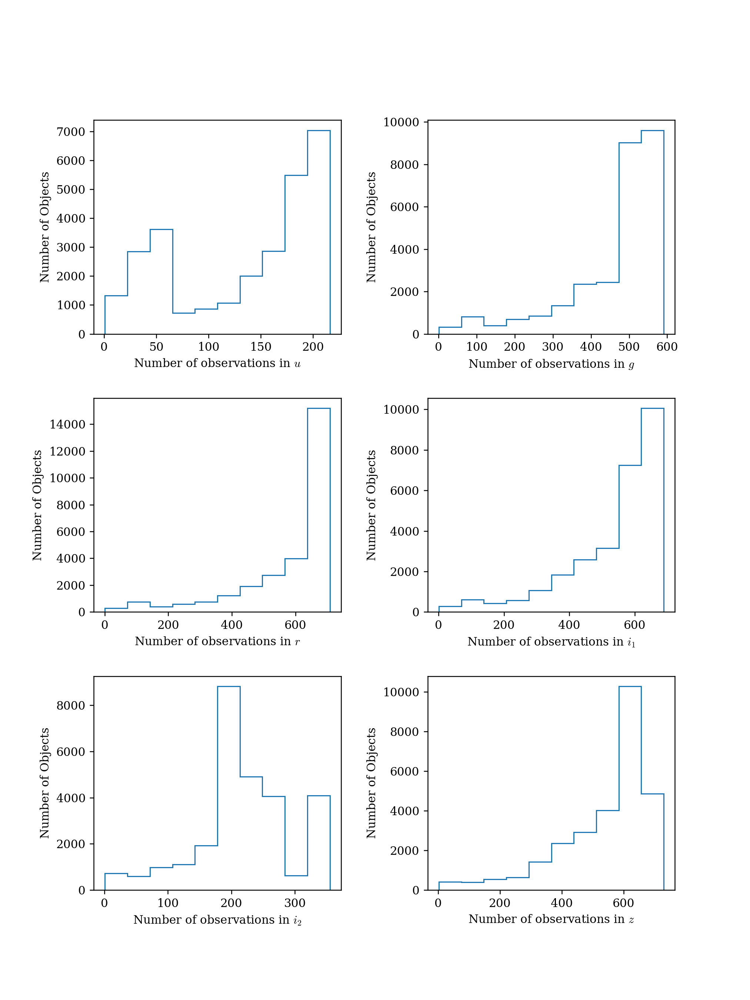

In [57]:
# plots histograms of number of measurements in each filter for the data
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

measurements_in_all = np.all(num_measurements_by_filter>0, axis=1)

for j, band in enumerate(['u', 'g', 'r', 'i_1', 'i_2', 'z']):
    ax = fig.add_subplot(3,2,j+1)
    ax.hist(num_measurements_by_filter[measurements_in_all,j], histtype='step')
    ax.set_ylabel('Number of Objects')
    ax.set_xlabel('Number of observations in $%s$' % band)
    
#plt.savefig('./figs/num_obs_hists.png', bbox_inches='tight')

In [58]:
# combine number of measurements for the two different i-band filters into one
num_measurements_by_filter_combined_i =  np.empty((len(file_list), 5))
num_measurements_by_filter_combined_i[:,0] = num_measurements_by_filter[measurements_in_all,0]
num_measurements_by_filter_combined_i[:,1] = num_measurements_by_filter[measurements_in_all,1]
num_measurements_by_filter_combined_i[:,2] = num_measurements_by_filter[measurements_in_all,2]
num_measurements_by_filter_combined_i[:,3] = num_measurements_by_filter[measurements_in_all,3]+num_measurements_by_filter[measurements_in_all,4]
num_measurements_by_filter_combined_i[:,4] = num_measurements_by_filter[measurements_in_all,5]

<IPython.core.display.Javascript object>


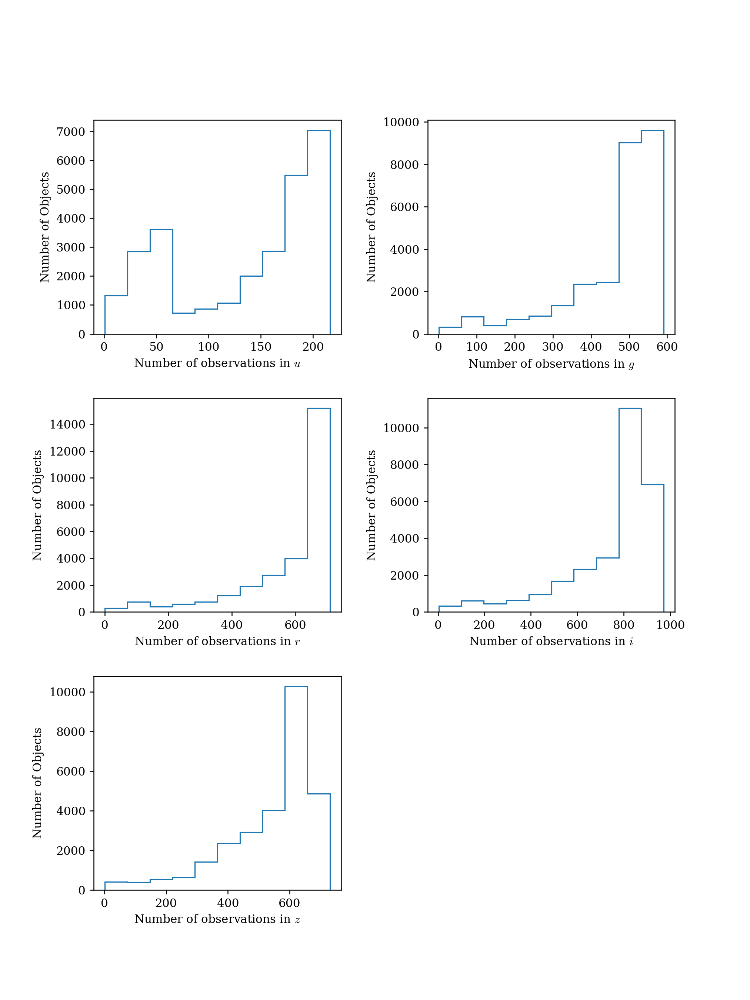

In [59]:
# same histograms as above, but with measurements in both i-band filters counted as one
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,j+1)
    ax.hist(num_measurements_by_filter_combined_i[:,j], histtype='step')
    ax.set_ylabel('Number of Objects')
    ax.set_xlabel('Number of observations in $%s$' % band)
    
#plt.savefig('./figs/num_obs_hists_combinedi.png', bbox_inches='tight')

Backtracking a bit: below is a plot of the RMS as a function of median magnitude for the u-band only, divided into two groups based on exposure time. This is because in the exposure time histograms, the u-band had the largest difference between the two exposure time peaks. This is mostly just to check if the exposure time is playing a role in the RMS vs. median magnitude plots.

<IPython.core.display.Javascript object>


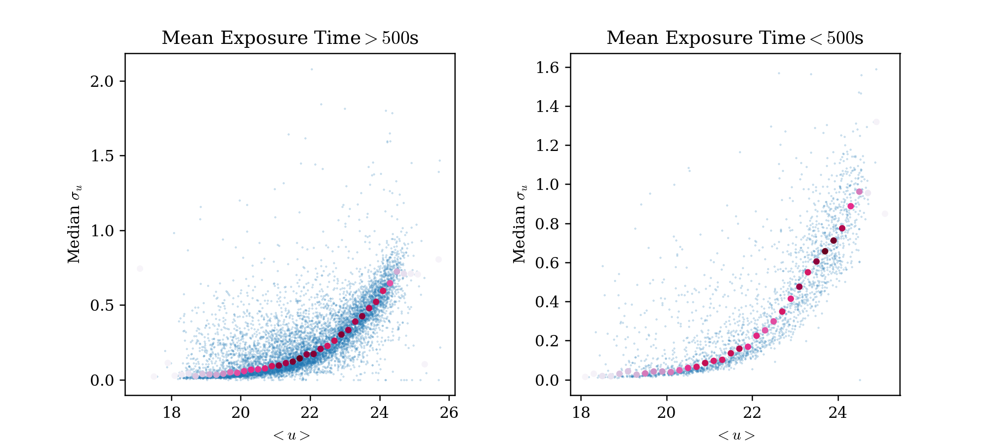

C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Text(0.5, 1.0, 'Mean Exposure Time$<500$s')

In [60]:
fig = plt.figure(figsize=(9,4))
fig.subplots_adjust(wspace=0.35)

mags_u1 = medians_combined_i[keep_u1,u]
rms_u1 = stddevs_combined_i[keep_u1,u]
start_u1 = np.floor(np.min(mags_u1))
end_u1 = np.ceil(np.max(mags_u1))
magsu1_plot = np.arange(start_u1+(bin_size/2), end_u1+(bin_size/2), bin_size)
medrmsu1_plot = np.empty_like(magsu1_plot)
num_in_bin_u1 = np.empty_like(magsu1_plot)
    
for k, mag in enumerate(magsu1_plot):
    in_bin = np.where((mags_u1>mag-(bin_size/2)) & (mags_u1<mag+(bin_size/2)))[0]
    medrmsu1_plot[k] = np.median(rms_u1[in_bin])
    num_in_bin_u1[k] = len(in_bin)
    
ax1 = fig.add_subplot(1,2,1)
ax1.scatter(mags_u1, rms_u1, s=0.05, alpha=0.5)
ax1.scatter(magsu1_plot, medrmsu1_plot, s=10, c=num_in_bin_u1, cmap='PuRd')
ax1.set_ylabel(r'Median $\sigma_u$')
ax1.set_xlabel(r'$<u>$')
ax1.set_title(r'Mean Exposure Time$>%s$s' % u_exp_cutoff)

mags_u2 = medians_combined_i[keep_u2,u]
rms_u2 = stddevs_combined_i[keep_u2,u]
start_u2 = np.floor(np.min(mags_u2))
end_u2 = np.ceil(np.max(mags_u2))
magsu2_plot = np.arange(start_u2+(bin_size/2), end_u2+(bin_size/2), bin_size)
medrmsu2_plot = np.empty_like(magsu2_plot)
num_in_bin_u2 = np.empty_like(magsu2_plot)
    
for k, mag in enumerate(magsu2_plot):
    in_bin = np.where((mags_u2>mag-(bin_size/2)) & (mags_u2<mag+(bin_size/2)))[0]
    medrmsu2_plot[k] = np.median(rms_u2[in_bin])
    num_in_bin_u2[k] = len(in_bin)
    
ax2 = fig.add_subplot(1,2,2)
ax2.scatter(mags_u2, rms_u2, s=0.05, alpha=0.5)
ax2.scatter(magsu2_plot, medrmsu2_plot, s=10, c=num_in_bin_u2, cmap='PuRd')
ax2.set_ylabel(r'Median $\sigma_u$')
ax2.set_xlabel(r'$<u>$')
ax2.set_title(r'Mean Exposure Time$<%s$s' % u_exp_cutoff)

#plt.savefig('./figs/medianRMS_vs_mag_ubandbyexptime.png', bbox_inches='tight')

Now we can begin the sigma clipping process. Luckily, AstroPy already has a built-in function to do this, which I used. Then, we can sigma clip every object in the data set and recalculate the medians, average photometric errors, and standard deviations. 

In [61]:
def load_one_timeseries_combined_i(file_name, coeffs):
    """
    Function to access light curve data for one object taking into account that the CFHTLS data has two i-band filters.
    
    Parameters
    ---
    file_name : str
        File path to CFHTLS time series data file (eg. 'CFHTLS-VAR-J022359.77-041810.1.mjdmag')
    coeffs : ndarray
        Coefficients of the linear function used to convert measurements with the first CFHTLS i-band filter to the second
        Array is the same as that produced by np.polyfit
        
    Returns
    ---
    times : ndarray
        Array of recorded times for each measurement
    mags : ndarray
        Array of measured magnitude for each measurement
    magerrs : ndarray
        Array of measurement error in magnitude for each measurement
    filters : ndarray
        Array of integers representing each filter (u = 0, g = 1, r = 2, i = 3, z = 4)        
    
    """    
    _, times, mags, magerrs, _, filters, _ = load_one_timeseries(file_name)
    
    gi_color = (np.median(mags[filters==1])) - (np.median(mags[filters==3]))
    fit = np.poly1d(coeffs)
    
    mags[filters==3] = mags[filters==3] + fit(gi_color)
    #magerrs[filters==3] = (1-coeffs[0])*magerrs[filters==3]
    filters[filters==4] = 3
    filters[filters==5] = 4
    
    return times, mags, magerrs, filters

<IPython.core.display.Javascript object>


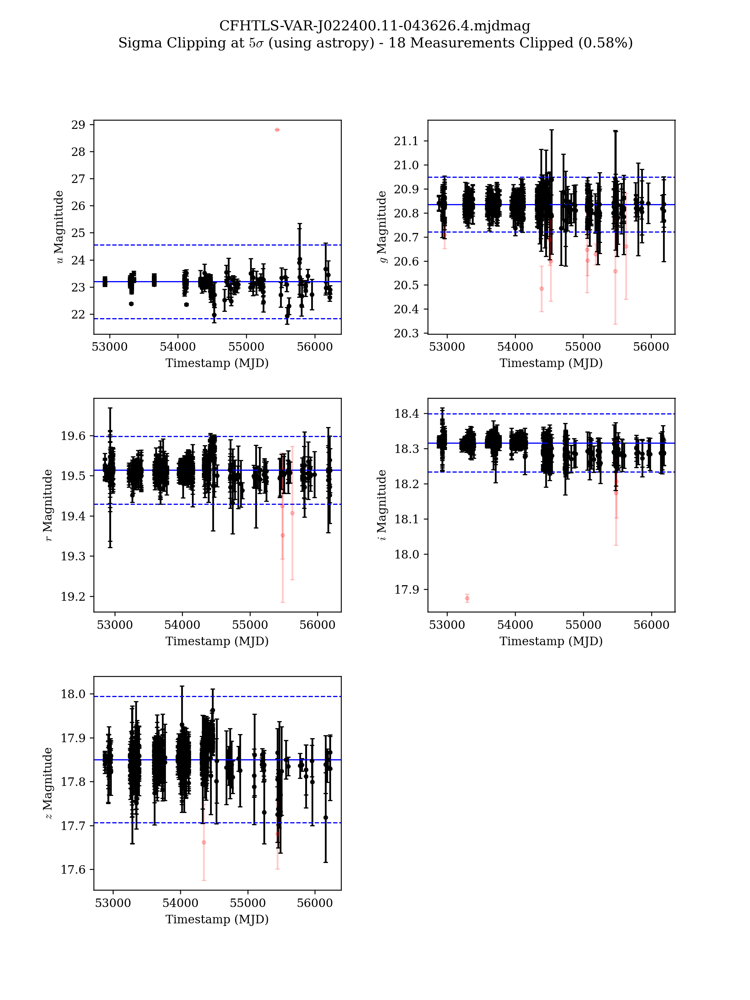

Text(0.5, 0.98, 'CFHTLS-VAR-J022400.11-043626.4.mjdmag\nSigma Clipping at $5\\sigma$ (using astropy) - 18 Measurements Clipped (0.58%)')

In [62]:
# a test of the new data loading function that combines i bands, and a visual illustration of sigma clipping in each filter

# in this case, I used the object with the largest mean photometric measurement error that was still <0.1 mag, feel free to examine other objects!
test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(file_list[smallerrs.argmax()], fit_coeffs)

fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

num_clipped = 0
for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,i+1)
    
    # just followed the astropy sigma_clip documentation
    masked_mags, upper, lower = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None, return_bounds=True)
    mask = ~masked_mags.mask
    num_clipped += np.sum(~mask) # calculates total number of clipped values
    
    ax.axhline(np.median(masked_mags[mask].data), c='b', ls='-', lw=1) # solid blue line indicates median
    ax.axhline(upper, c='b', ls='--', lw=1) # upper dashed blue line indicates 5 standard deviations above median
    ax.axhline(lower, c='b', ls='--', lw=1) # lower dashed blue line indicates 5 standard deviations below median
    
    # black data+errorbars for measurements that are kept
    ax.errorbar(test_t[test_filts==i][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==i][mask], 
                fmt='.', capsize=2, c='k')
    # faded red data+errorbars for measurements that are removed/clipped
    ax.errorbar(test_t[test_filts==i][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==i][~mask], 
                fmt='.', capsize=2, c='r', alpha=0.2)
    
    ax.set_xlabel('Timestamp (MJD)')
    ax.set_ylabel(r'$%s$ Magnitude' % band)
    
fig.suptitle(file_list[smallerrs.argmax()]+'\n'+r'Sigma Clipping at $5\sigma$ (using astropy) - %s Measurements Clipped (%.2f%%)' % (num_clipped, 100*(num_clipped/len(test_mag))))

In [63]:
def get_sigma_clipped_statistics(file_list, return_num_clipped=True, errs_by_filter=False):
    """
    Function that:
    1. Performs sigma clipping on the light curves of each object
    2. Calculates the median magnitude, RMS variation, and mean measurement error for each filter using the sigma-clipped data
    
    Parameters
    ---
    file_list : list of str
        List of file paths (eg. one created by os.listdir(folder_path))
    by_filter : bool
        Defaults to False. Set to true to return an array containing number of measurements per filter
    return_num_clipped : bool
        Defaults to True. Returns clipped_stats and clipped_stats_by_filter arrays if True.
    errs_by_filter : bool
        Defaults to False; errs will return Nx1 array if False.
        If True, errs returns Nx5 array containing mean measurement of measurements per filter.
    
    Returns
    ---
    medians : ndarray
        Nx5 array containing the median magnitude in each filter, calculated after sigma clipping, for each object
    stddevs : ndarray
        Nx5 array containing the standard deviation of magnitudes in each filter, calculated after sigma clipping, for each object
    errs : ndarray
        If errs_by_filter=False, Nx1 array containing the mean photometric measurement error of each object, calculated after sigma clipping
        If errs_by_filter=True, Nx5 array containing the mean photometric measurement error in each filter  of each object, calculated after sigma clipping
    clipped_stats : ndarray
        Nx2 array containing total number and percentage of measurements clipped over all filters for each object
        Only returned if return_num_clipped=True.
    clipped_stats_by_filter : ndarray
        Nx5x2 array containing total number and percentage of measurements clipped per filter for each object
        Only returned if return_num_clipped=True
    """
    fit_coeffs = np.loadtxt('i1toi2_transform_coeffs.txt')
    medians = np.empty((len(file_list), 5))
    stddevs = np.empty((len(file_list), 5))
    if return_num_clipped==True:
        clipped_stats_by_filter = np.empty((len(file_list), 5, 2))
        clipped_stats = np.empty((len(file_list), 2))
    if errs_by_filter==False:
        errs = np.empty(len(file_list))
    elif errs_by_filter==True:
        errs = np.empty((len(file_list), 5))
    
    for i, fname in enumerate(file_list):
        _, mags, magerrs, filts = load_one_timeseries_combined_i(fname, fit_coeffs)
        if errs_by_filter==False:
            masked_errs = []
            
        for j in range(5):
            masked_mags = sigma_clip(mags[filts==j], sigma=5, maxiters=None)
            mask = ~masked_mags.mask
            clipped_stats_by_filter[i,j,0] = np.sum(~mask)
            clipped_stats_by_filter[i,j,1] = 100*(clipped_stats_by_filter[i,j,0]/np.sum(filts==j))
            stddevs[i,j] = np.std(masked_mags[mask].data)
            medians[i,j] = np.median(masked_mags[mask].data)
            if errs_by_filter==False:
                masked_errs.extend((magerrs[filts==j][mask]).tolist())
            elif errs_by_filter==True:
                errs[i,j] = np.mean(magerrs[filts==j][mask])
                
        if errs_by_filter==False:
            errs[i] = np.mean(masked_errs)
                
        if return_num_clipped==True:
            clipped_stats[i,0] = np.sum(clipped_stats_by_filter[i,:,0])
            clipped_stats[i,1] = 100*(clipped_stats[i,0]/len(mags))
    
    if return_num_clipped==True:
        return medians, stddevs, errs, clipped_stats, clipped_stats_by_filter
    else:
        return medians, stddevs, errs

In [64]:
sigmaclipped_medians, sigmaclipped_stddevs, sigmaclipped_meanerr, sigmaclip_stats, sigmaclip_stats_by_filter = get_sigma_clipped_statistics(file_list)

In [65]:
sigmaclipped_smallerrs = sigmaclipped_meanerr<0.1
sigmaclipped_smallerrs.sum()

11268

<IPython.core.display.Javascript object>


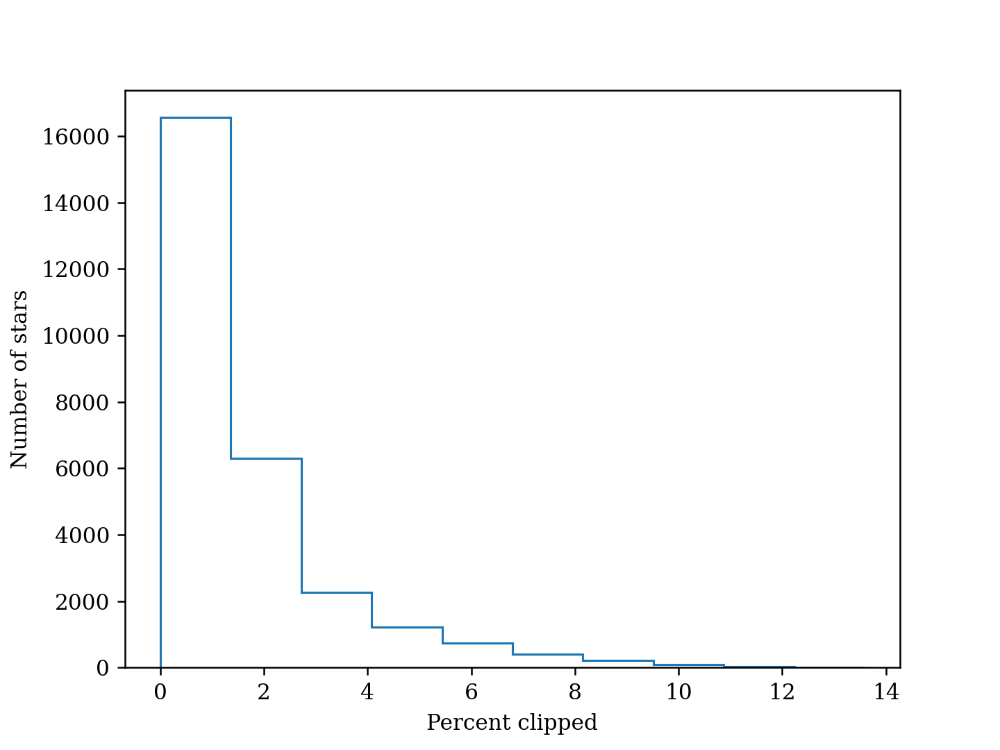

Text(0, 0.5, 'Number of stars')

In [66]:
plt.hist(sigmaclip_stats[:,1], histtype='step')
plt.xlabel('Percent clipped')
plt.ylabel('Number of stars')

It looks like the sigma clipping increased the number of stars with small average measurement errors, which is a very good sign that indicates that some of the more uncertain individual measurements were also outliers in the data. 

Sigma clipping also only removes a few percent of the measurements from most stars, which is what we'd expect. If the sigma clipping was removing too many measurements, we would suspect that the object's light curve actually had no true outliers and was instead highly variable.

<IPython.core.display.Javascript object>


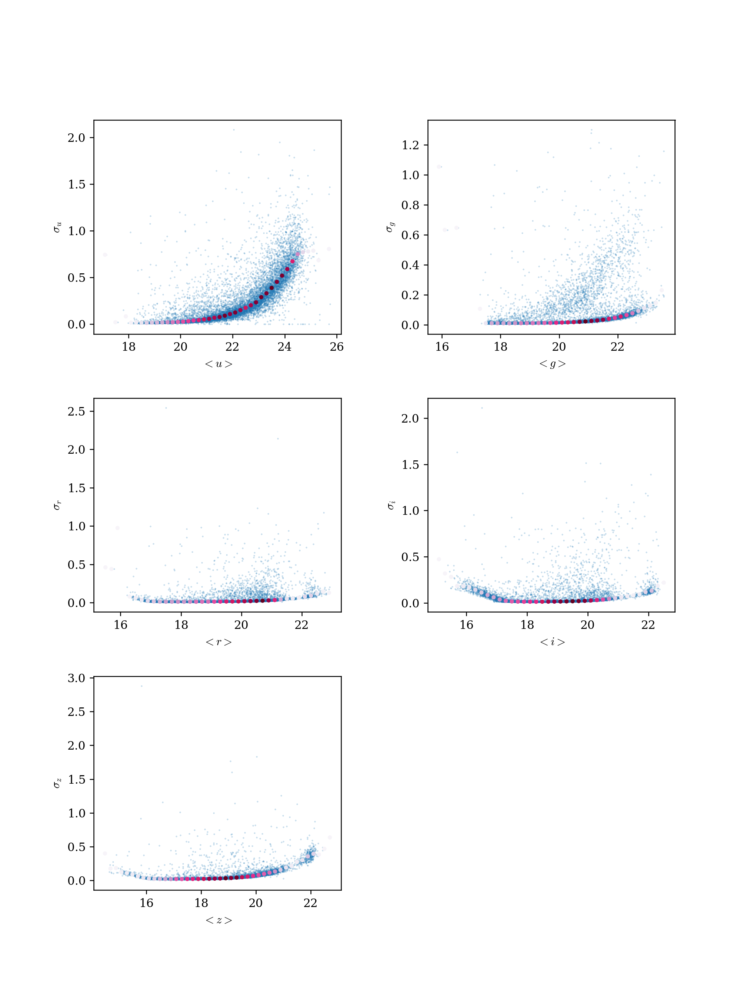

C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [67]:
# re-plot the RMS vs median magnitude plots from before, but with the sigma clipped data

fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

bin_size = 0.2

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    mags = sigmaclipped_medians[sigmaclipped_smallerrs,j]
    rms = sigmaclipped_stddevs[sigmaclipped_smallerrs,j]
    start = np.floor(np.min(mags))
    end = np.ceil(np.max(mags))
    mags_plot = np.arange(start+(bin_size/2), end+(bin_size/2), bin_size)
    medrms_plot = np.empty_like(mags_plot)
    num_in_bin = np.empty_like(mags_plot)
    
    for k, mag in enumerate(mags_plot):
        in_bin = np.where((mags>mag-(bin_size/2)) & (mags<mag+(bin_size/2)))[0]
        medrms_plot[k] = np.median(rms[in_bin])
        num_in_bin[k] = len(in_bin)
    
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(mags, rms, s=0.05, alpha=0.5)
    ax.scatter(mags_plot, medrms_plot, s=7, c=num_in_bin, cmap='PuRd')
    ax.set_ylabel(r'$\sigma_%s$' % band)
    ax.set_xlabel(r'$<%s>$' % band)
    
#plt.savefig('./figs/sigmaclipped_medianRMS_vs_mag.png', bbox_inches='tight')

<IPython.core.display.Javascript object>


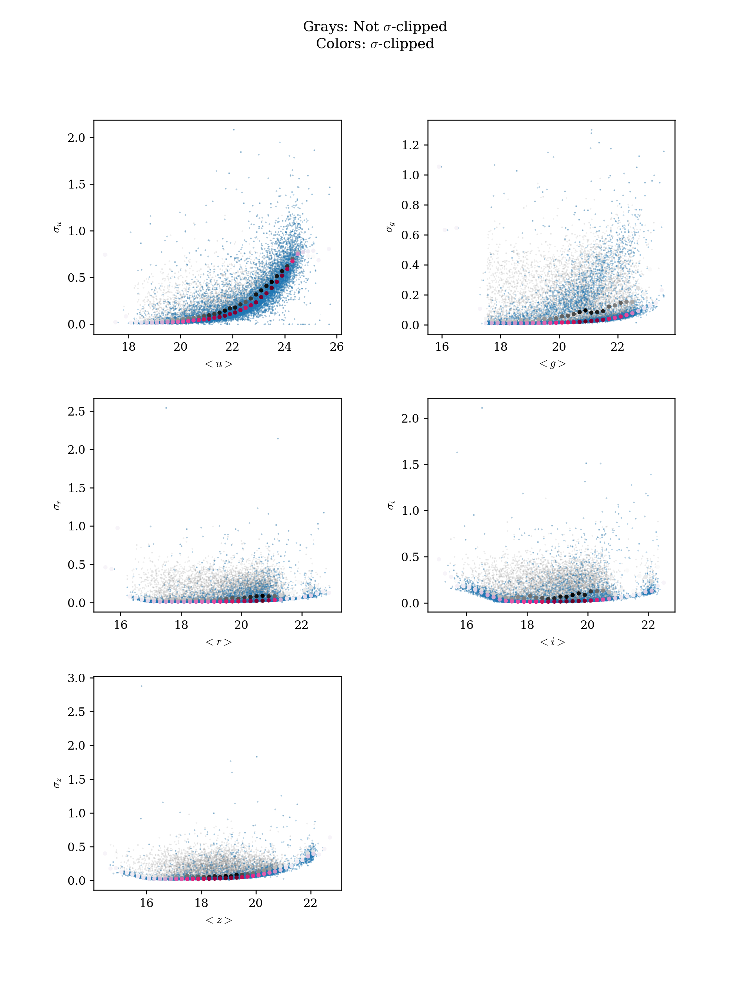

Text(0.5, 0.98, 'Grays: Not $\\sigma$-clipped\nColors: $\\sigma$-clipped')

In [68]:
# RMS vs median magnitude plots, but this time we plot both the sigma clipped and not-sigma clipped measurements to compare

fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

bin_size = 0.2

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    unclipped_mags = medians_combined_i[smallerrs,j]
    unclipped_rms = stddevs_combined_i[smallerrs,j]
    mags = sigmaclipped_medians[sigmaclipped_smallerrs,j]
    rms = sigmaclipped_stddevs[sigmaclipped_smallerrs,j]
    start = np.floor(np.min(mags))
    end = np.ceil(np.max(mags))
    mags_plot = np.arange(start+(bin_size/2), end+(bin_size/2), bin_size)
    unclipped_start = np.floor(np.min(unclipped_mags))
    unclipped_end = np.ceil(np.max(unclipped_mags))
    unclipped_mags_plot = np.arange(unclipped_start+(bin_size/2), end+(bin_size/2), bin_size)
    medrms_plot = np.empty_like(mags_plot)
    num_in_bin = np.empty_like(mags_plot)
    unclipped_medrms_plot = np.empty_like(unclipped_mags_plot)
    unclipped_num_in_bin = np.empty_like(unclipped_mags_plot)
    
    for k, mag in enumerate(mags_plot):
        in_bin = np.where((mags>mag-(bin_size/2)) & (mags<mag+(bin_size/2)))[0]
        medrms_plot[k] = np.median(rms[in_bin])
        num_in_bin[k] = len(in_bin)
        
    for k, mag in enumerate(unclipped_mags_plot):
        in_bin = np.where((unclipped_mags>mag-(bin_size/2)) & (unclipped_mags<mag+(bin_size/2)))[0]
        unclipped_medrms_plot[k] = np.median(unclipped_rms[in_bin])
        unclipped_num_in_bin[k] = len(in_bin)
    
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(unclipped_mags, unclipped_rms, s=0.05, alpha=0.3, c='grey')
    ax.scatter(mags, rms, s=0.05, alpha=0.7)
    ax.scatter(unclipped_mags_plot, unclipped_medrms_plot, s=7, c=num_in_bin, cmap='Greys')
    ax.scatter(mags_plot, medrms_plot, s=7, c=num_in_bin, cmap='PuRd')
    ax.set_ylabel(r'$\sigma_%s$' % band)
    ax.set_xlabel(r'$<%s>$' % band)
    
plt.suptitle('Grays: Not $\sigma$-clipped'+'\n'+'Colors: $\sigma$-clipped')

It appears that sigma clipping has, overall, solved the previous issue of the median RMS in certain magnitude bins being higher than the visible locus of points. This is an excellent result. However, there are still some points with unusually high RMS. Let's investigate these.

In [69]:
highsigma = np.unique(np.where(sigmaclipped_stddevs[sigmaclipped_smallerrs]>2)[0]) # you can adjust the 2 mag threshold for "unusually high" RMS if you'd like!
sigmaclipped_stddevs[sigmaclipped_smallerrs][highsigma]

array([[0.25227427, 0.04201856, 2.54164216, 1.63008811, 2.88157886],
       [2.08051491, 0.76418519, 0.4289456 , 0.02703278, 0.02352234],
       [0.58303506, 0.07188059, 2.14261588, 2.11292869, 0.10555263]])

In [70]:
sigmaclipped_medians[sigmaclipped_smallerrs][highsigma]

array([[22.3515    , 21.708     , 17.4965    , 15.70244206, 15.834     ],
       [22.036     , 22.375     , 21.0555    , 19.53977773, 18.889     ],
       [24.167     , 22.342     , 21.208     , 16.51940328, 20.358     ]])

<IPython.core.display.Javascript object>


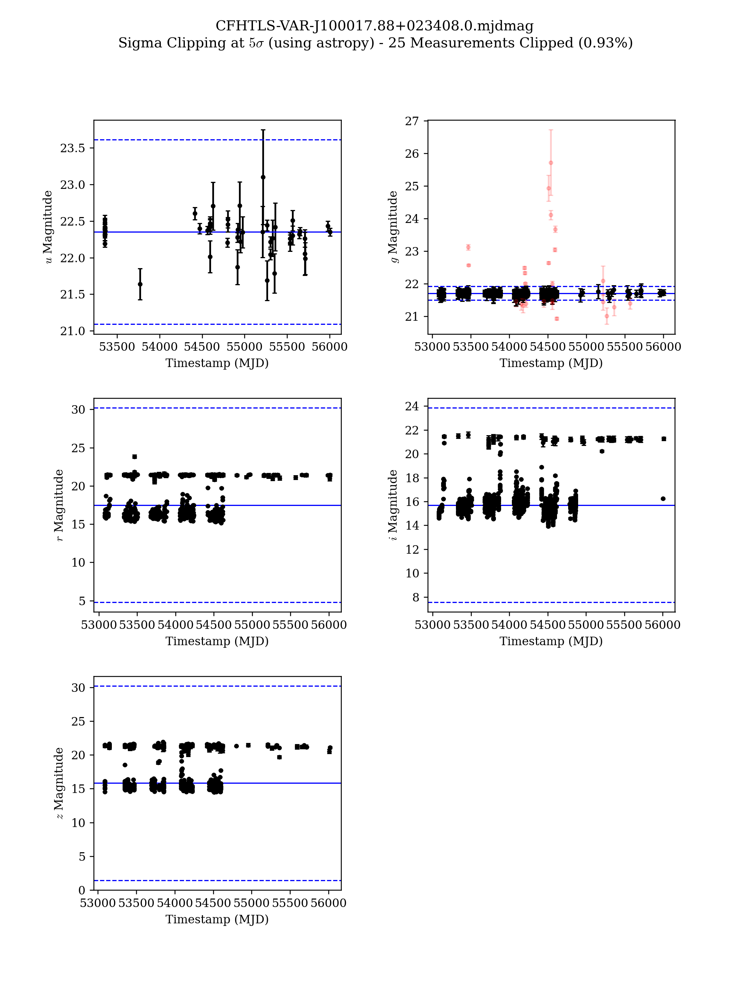

Text(0.5, 0.98, 'CFHTLS-VAR-J100017.88+023408.0.mjdmag\nSigma Clipping at $5\\sigma$ (using astropy) - 25 Measurements Clipped (0.93%)')

In [71]:
test_file = file_list[sigmaclipped_smallerrs][highsigma][0] # edit the index to examine the other high RMS objects
test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)

fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

num_clipped = 0
for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    ax = fig.add_subplot(3,2,i+1)
    
    masked_mags, upper, lower = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None, return_bounds=True)
    mask = ~masked_mags.mask
    num_clipped += np.sum(~mask)
    
    ax.axhline(np.median(masked_mags[mask].data), c='b', ls='-', lw=1)
    ax.axhline(upper, c='b', ls='--', lw=1)
    ax.axhline(lower, c='b', ls='--', lw=1)
    
    ax.errorbar(test_t[test_filts==i][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==i][mask], 
                fmt='.', capsize=2, c='k')
    ax.errorbar(test_t[test_filts==i][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==i][~mask], 
                fmt='.', capsize=2, c='r', alpha=0.2)
    
    ax.set_xlabel('Timestamp (MJD)')
    ax.set_ylabel(r'$%s$ Magnitude' % band)
    
fig.suptitle(test_file+'\n'+r'Sigma Clipping at $5\sigma$ (using astropy) - %s Measurements Clipped (%.2f%%)' % (num_clipped, 100*(num_clipped/len(test_mag))))

It looks like those unusually high RMS stars only exhibit that behavior in a few filters, and the issue lies in very dramatic highs and lows in their light curves in those filters. We probably don't have to worry too much about these objects - they're not likely to be RR Lyrae because of that high variation. But let's check where they are on the color-color diagram just to be sure.

In [72]:
# again, just resetting the filters->index values just in case
u = 0
g = 1
r = 2
i = 3
z = 4

# calculate colors as before, but using sigma clipped light curves
sigmaclipped_gi_color = sigmaclipped_medians[:,g] - sigmaclipped_medians[:,i]
sigmaclipped_ug_color = sigmaclipped_medians[:,u] - sigmaclipped_medians[:,g]
sigmaclipped_iz_color = sigmaclipped_medians[:,i] - sigmaclipped_medians[:,z]
sigmaclipped_gr_color = sigmaclipped_medians[:,g] - sigmaclipped_medians[:,r]
sigmaclipped_ri_color = sigmaclipped_medians[:,r] - sigmaclipped_medians[:,i]

<IPython.core.display.Javascript object>


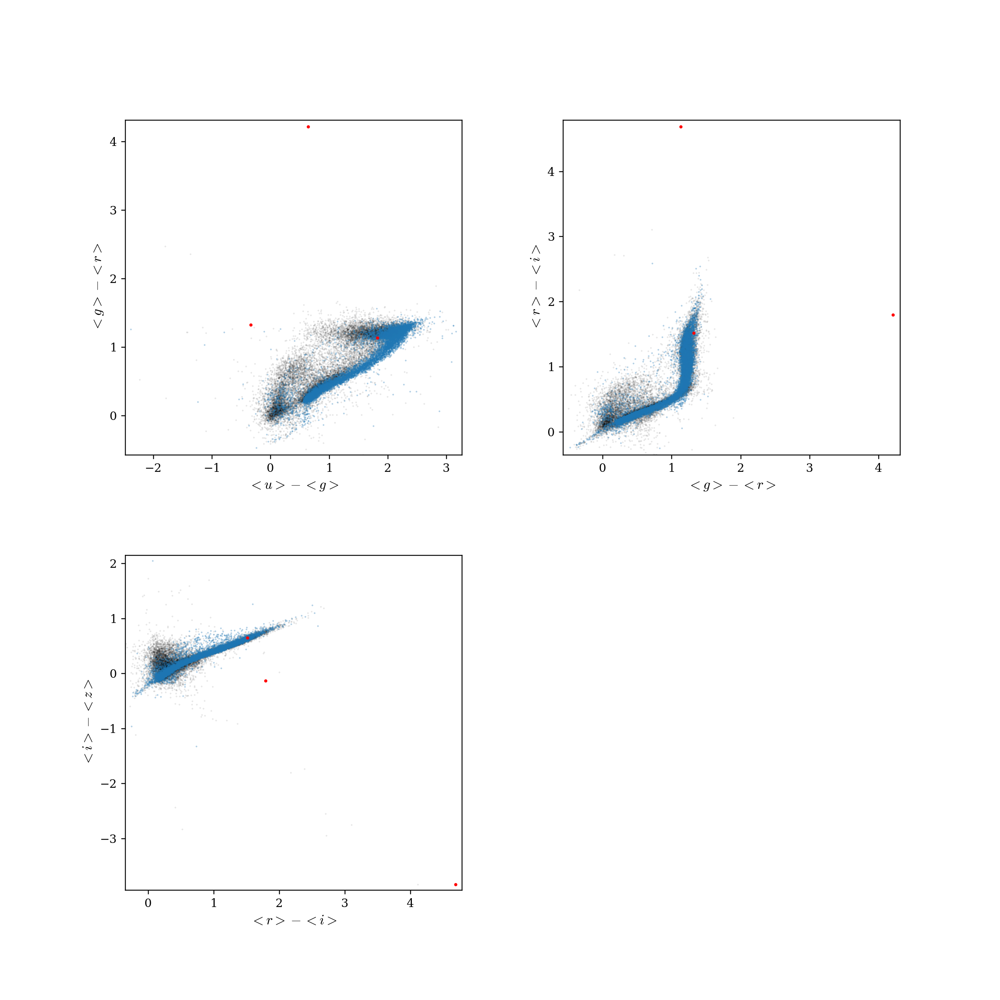

Text(0, 0.5, '$<i>-<z>$')

In [73]:
# the same color-color diagrams as before, but with sigma clipped values
# the red dots are the high RMS objects
# black points have average measurement error > 0.1 mag; blue points have average error < 0.1 mag

fig = plt.figure(figsize=(12,12))
fig.subplots_adjust(wspace=0.3, hspace=0.3)

ax1 = fig.add_subplot(2,2,1)
ax1.scatter(sigmaclipped_ug_color[~sigmaclipped_smallerrs], sigmaclipped_gr_color[~sigmaclipped_smallerrs], 
            s=0.05, alpha=0.2, c='k')
ax1.scatter(sigmaclipped_ug_color[sigmaclipped_smallerrs], sigmaclipped_gr_color[sigmaclipped_smallerrs], 
            s=0.1, alpha=0.5)
ax1.scatter(sigmaclipped_ug_color[sigmaclipped_smallerrs][highsigma], sigmaclipped_gr_color[sigmaclipped_smallerrs][highsigma], 
            s=3, c='r')
ax1.set_xlim((sigmaclipped_ug_color[sigmaclipped_smallerrs].min()-.1, sigmaclipped_ug_color[sigmaclipped_smallerrs].max()+.1))
ax1.set_ylim((sigmaclipped_gr_color[sigmaclipped_smallerrs].min()-.1, sigmaclipped_gr_color[sigmaclipped_smallerrs].max()+.1))
ax1.set_xlabel(r'$<u>-<g>$', fontsize=12)
ax1.set_ylabel(r'$<g>-<r>$', fontsize=12)

ax2 = fig.add_subplot(2,2,2)
ax2.scatter(sigmaclipped_gr_color[~sigmaclipped_smallerrs], sigmaclipped_ri_color[~sigmaclipped_smallerrs], 
            s=0.05, alpha=0.2, c='k')
ax2.scatter(sigmaclipped_gr_color[sigmaclipped_smallerrs], sigmaclipped_ri_color[sigmaclipped_smallerrs], 
            s=0.1, alpha=0.5)
ax2.scatter(sigmaclipped_gr_color[sigmaclipped_smallerrs][highsigma], sigmaclipped_ri_color[sigmaclipped_smallerrs][highsigma], 
            s=3, c='r')
ax2.set_xlim((sigmaclipped_gr_color[sigmaclipped_smallerrs].min()-.1, sigmaclipped_gr_color[sigmaclipped_smallerrs].max()+.1))
ax2.set_ylim((sigmaclipped_ri_color[sigmaclipped_smallerrs].min()-.1, sigmaclipped_ri_color[sigmaclipped_smallerrs].max()+.1))
ax2.set_xlabel(r'$<g>-<r>$', fontsize=12)
ax2.set_ylabel(r'$<r>-<i>$', fontsize=12)

ax3 = fig.add_subplot(2,2,3)
ax3.scatter(sigmaclipped_ri_color[~sigmaclipped_smallerrs], sigmaclipped_iz_color[~sigmaclipped_smallerrs], 
            s=0.05, alpha=0.2, c='k')
ax3.scatter(sigmaclipped_ri_color[sigmaclipped_smallerrs], sigmaclipped_iz_color[sigmaclipped_smallerrs], 
            s=0.1, alpha=0.5)
ax3.scatter(sigmaclipped_ri_color[sigmaclipped_smallerrs][highsigma], sigmaclipped_iz_color[sigmaclipped_smallerrs][highsigma], 
            s=3, c='r')
ax3.set_xlim((sigmaclipped_ri_color[sigmaclipped_smallerrs].min()-.1, sigmaclipped_ri_color[sigmaclipped_smallerrs].max()+.1))
ax3.set_ylim((sigmaclipped_iz_color[sigmaclipped_smallerrs].min()-.1, sigmaclipped_iz_color[sigmaclipped_smallerrs].max()+.1))
ax3.set_xlabel(r'$<r>-<i>$', fontsize=12)
ax3.set_ylabel(r'$<i>-<z>$', fontsize=12)

Great, looks like the high RMS objects are most likely not RR Lyrae candidates anyway. They're generally quite far from where we would expect RR Lyrae to be on these color-color diagrams.

There's one more thing to examine - the RMS vs. median magnitude g-band plot. There is an unusual upward spray of points in the plot still visible after sigma clipping. Let's see if we can figure out what's causing this.

<IPython.core.display.Javascript object>


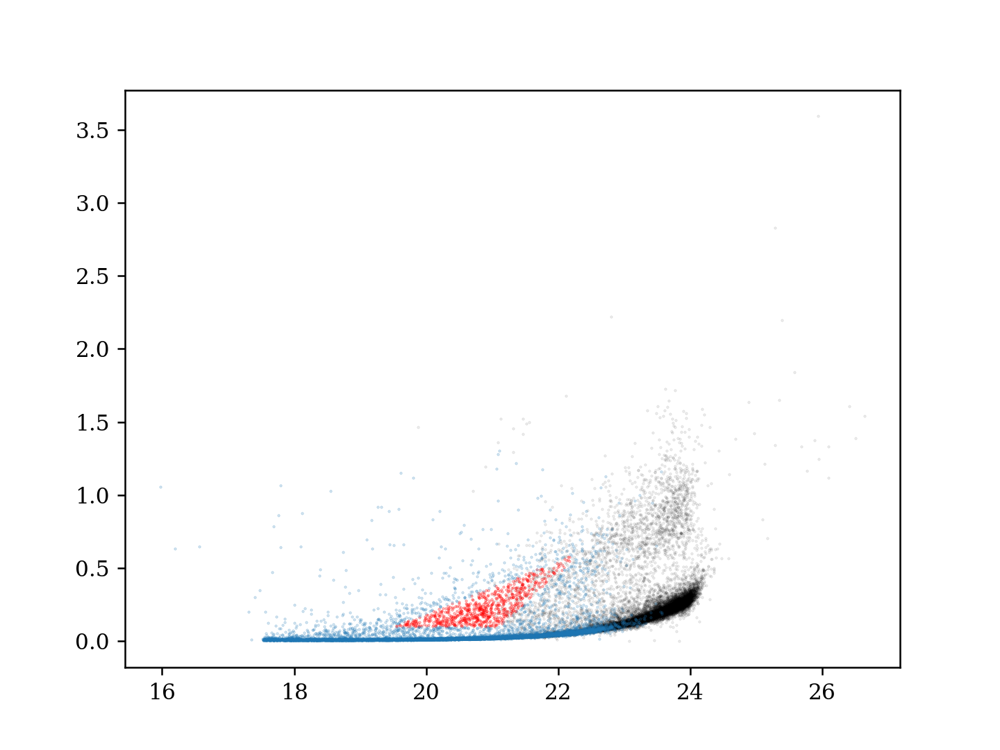

Selected: 6.30%


In [74]:
# basically, I just defined a triangle by eye to select stars that comprise the unusual pattern in the g-band
# feel free to play with the numerical values of the triangle corners

select = np.logical_and(sigmaclipped_stddevs[sigmaclipped_smallerrs,g]>0.1,
                        np.logical_and(
                            sigmaclipped_stddevs[sigmaclipped_smallerrs,g]<0.62+(((0.1-0.62)/(19.5-22.4))*(sigmaclipped_medians[sigmaclipped_smallerrs,g]-22.4)),
                            sigmaclipped_stddevs[sigmaclipped_smallerrs,g]>0.62+(((0.1-0.62)/(21.1-22.4))*(sigmaclipped_medians[sigmaclipped_smallerrs,g]-22.4))))
plt.scatter(sigmaclipped_medians[~sigmaclipped_smallerrs,g], sigmaclipped_stddevs[~sigmaclipped_smallerrs,g], s=0.05, alpha=0.2, c='k')
plt.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g][select], sigmaclipped_stddevs[sigmaclipped_smallerrs,g][select], c='r', s=0.05, alpha=0.7)
plt.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g][~select], sigmaclipped_stddevs[sigmaclipped_smallerrs,g][~select], s=0.05, alpha=0.5)

print('Selected: %.2f%%' % ((np.sum(select)/np.sum(sigmaclipped_smallerrs))*100)) #calcuates percent of stars selected

<IPython.core.display.Javascript object>


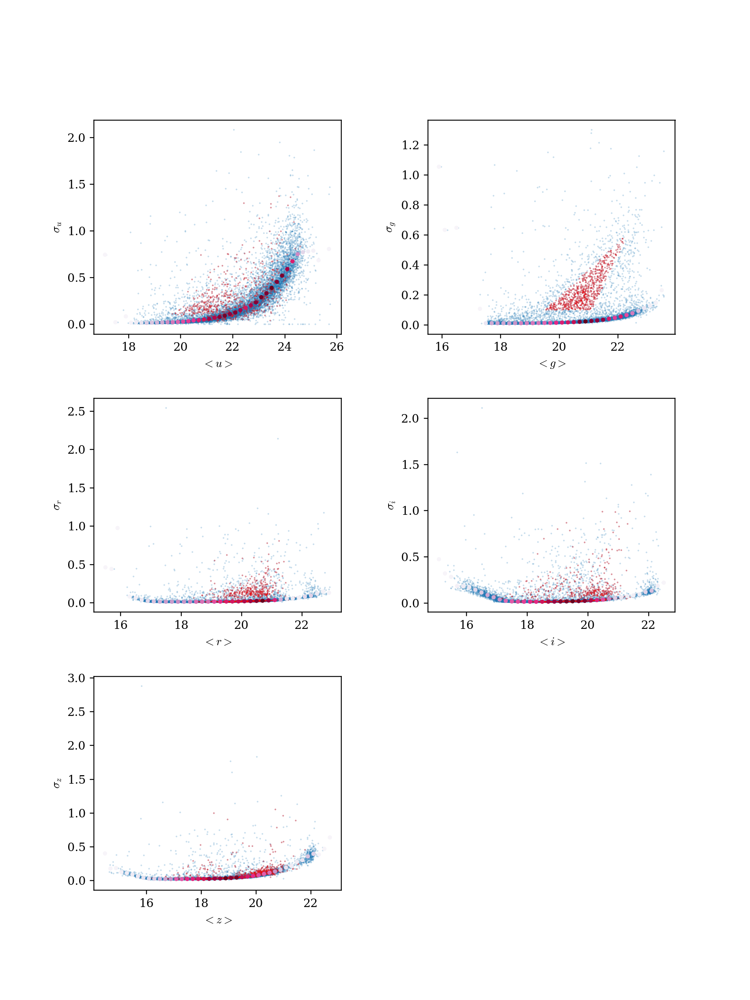

C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [75]:
# the same RMS vs median magnitude plot, but the selected objects are in red to see where they fall in other filters
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

bin_size = 0.2

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    mags = sigmaclipped_medians[sigmaclipped_smallerrs,j]
    rms = sigmaclipped_stddevs[sigmaclipped_smallerrs,j]
    start = np.floor(np.min(mags))
    end = np.ceil(np.max(mags))
    mags_plot = np.arange(start+(bin_size/2), end+(bin_size/2), bin_size)
    medrms_plot = np.empty_like(mags_plot)
    num_in_bin = np.empty_like(mags_plot)
    
    for k, mag in enumerate(mags_plot):
        in_bin = np.where((mags>mag-(bin_size/2)) & (mags<mag+(bin_size/2)))[0]
        medrms_plot[k] = np.median(rms[in_bin])
        num_in_bin[k] = len(in_bin)
    
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(mags, rms, s=0.05, alpha=0.5)
    ax.scatter(mags[select], rms[select], s=0.1, alpha=0.5, c='r')
    ax.scatter(mags_plot, medrms_plot, s=7, c=num_in_bin, cmap='PuRd')
    ax.set_ylabel(r'$\sigma_%s$' % band)
    ax.set_xlabel(r'$<%s>$' % band)

<IPython.core.display.Javascript object>


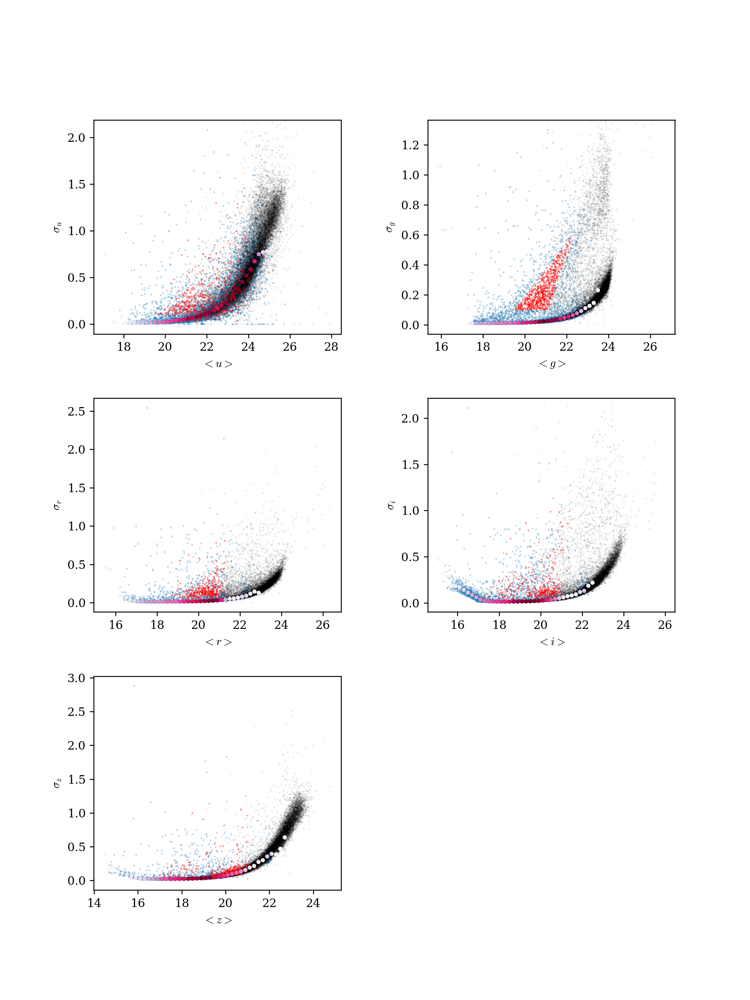

In [76]:
# same plot as above, just zoomed in

fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

bin_size = 0.2

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    mags = sigmaclipped_medians[sigmaclipped_smallerrs,j]
    rms = sigmaclipped_stddevs[sigmaclipped_smallerrs,j]
    start = np.floor(np.min(mags))
    end = np.ceil(np.max(mags))
    mags_plot = np.arange(start+(bin_size/2), end+(bin_size/2), bin_size)
    medrms_plot = np.empty_like(mags_plot)
    num_in_bin = np.empty_like(mags_plot)
    
    for k, mag in enumerate(mags_plot):
        in_bin = np.where((mags>mag-(bin_size/2)) & (mags<mag+(bin_size/2)))[0]
        medrms_plot[k] = np.median(rms[in_bin])
        num_in_bin[k] = len(in_bin)
    
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(mags[~select], rms[~select], s=0.1, alpha=0.5)
    ylims = ax.get_ylim()
    xlims = ax.get_xlim()
    ax.scatter(sigmaclipped_medians[~sigmaclipped_smallerrs,j], sigmaclipped_stddevs[~sigmaclipped_smallerrs,j], 
               s=0.05, alpha=0.2, c='k')
    ax.scatter(mags[select], rms[select], s=0.1, alpha=0.7, c='r')
    ax.scatter(mags_plot, medrms_plot, s=7, c=num_in_bin, cmap='PuRd')
    ax.set_ylim(ylims)
    #ax.set_xlim(xlims)
    ax.set_ylabel(r'$\sigma_%s$' % band)
    ax.set_xlabel(r'$<%s>$' % band)

<IPython.core.display.Javascript object>


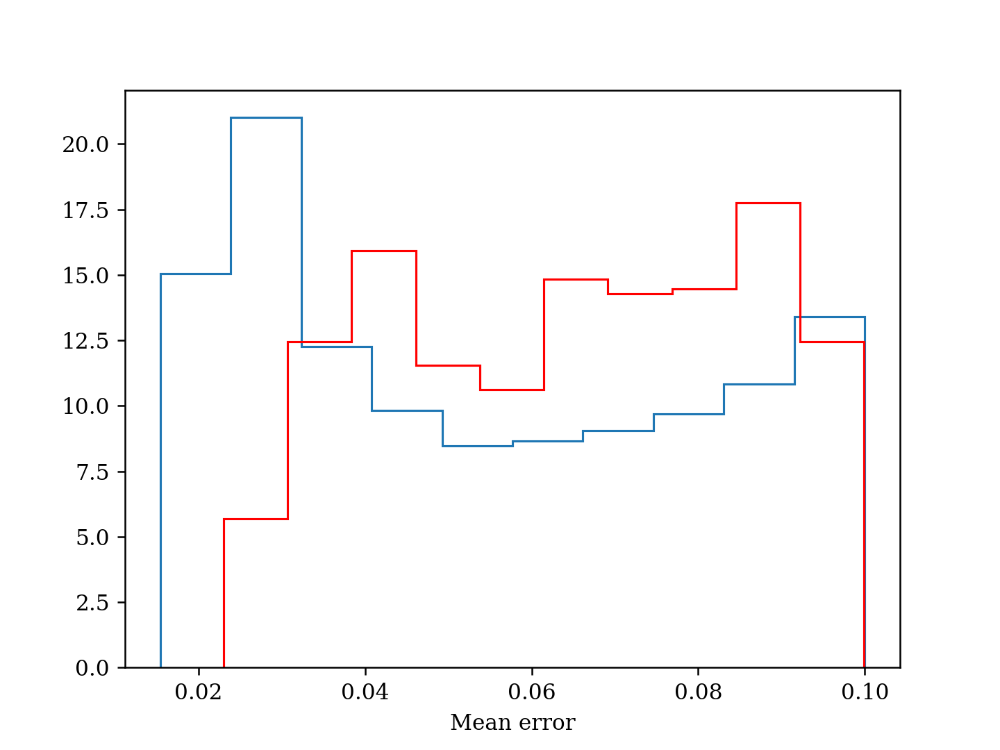

Text(0.5, 0, 'Mean error')

In [77]:
# normalized histogram of the mean photometric measurement error distribution to see if it's related
plt.hist(sigmaclipped_meanerr[sigmaclipped_smallerrs], histtype='step', density=True) # full data
plt.hist(sigmaclipped_meanerr[sigmaclipped_smallerrs][select], histtype='step', density=True, color='r') # selected stars from before 
plt.xlabel('Mean error')

<IPython.core.display.Javascript object>


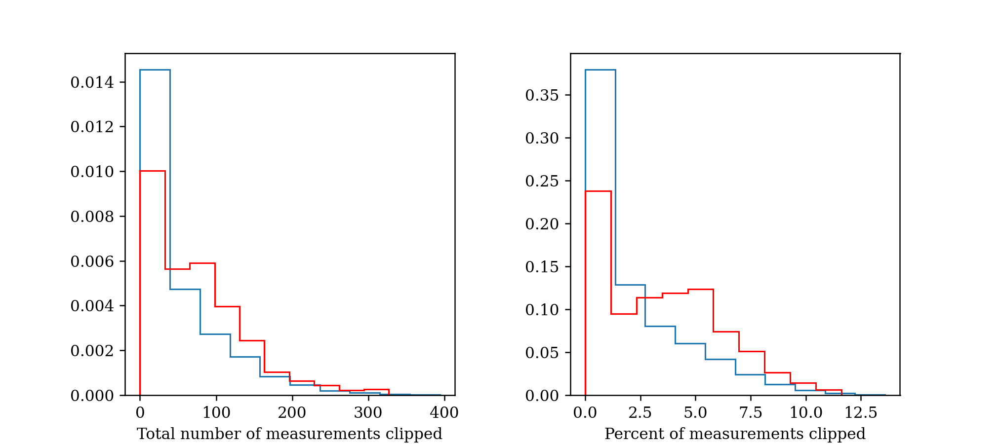

Text(0.5, 0, 'Percent of measurements clipped')

In [78]:
# histograms of total measurements clipped and percent of measurements clipped to see if there's anything unusual in the upward spray
fig = plt.figure(figsize=(9,4))
fig.subplots_adjust(wspace=0.35)

ax1 = fig.add_subplot(1,2,1)
ax1.hist(sigmaclip_stats[sigmaclipped_smallerrs,0], histtype='step', density=True)
ax1.hist(sigmaclip_stats[sigmaclipped_smallerrs,0][select], histtype='step', density=True, color='r')
ax1.set_xlabel('Total number of measurements clipped')

ax2 = fig.add_subplot(1,2,2)
ax2.hist(sigmaclip_stats[sigmaclipped_smallerrs,1], histtype='step', density=True)
ax2.hist(sigmaclip_stats[sigmaclipped_smallerrs,1][select], histtype='step', density=True, color='r')
ax2.set_xlabel('Percent of measurements clipped')

<IPython.core.display.Javascript object>


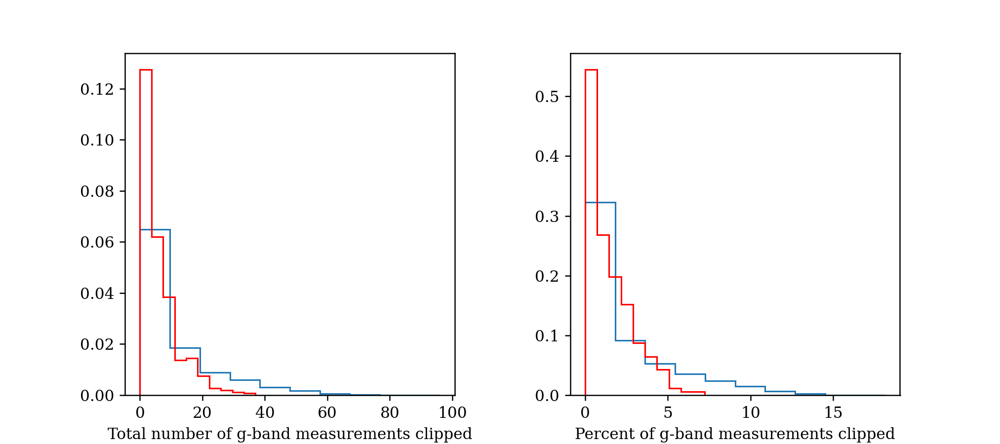

Text(0.5, 0, 'Percent of g-band measurements clipped')

In [79]:
# similar to above, but only for the g-band
fig = plt.figure(figsize=(9,4))
fig.subplots_adjust(wspace=0.35)

ax1 = fig.add_subplot(1,2,1)
ax1.hist(sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,0], histtype='step', density=True)
ax1.hist(sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,0][select], histtype='step', density=True, color='r')
ax1.set_xlabel('Total number of g-band measurements clipped')

ax2 = fig.add_subplot(1,2,2)
ax2.hist(sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,1], histtype='step', density=True)
ax2.hist(sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,1][select], histtype='step', density=True, color='r')
ax2.set_xlabel('Percent of g-band measurements clipped')

<IPython.core.display.Javascript object>


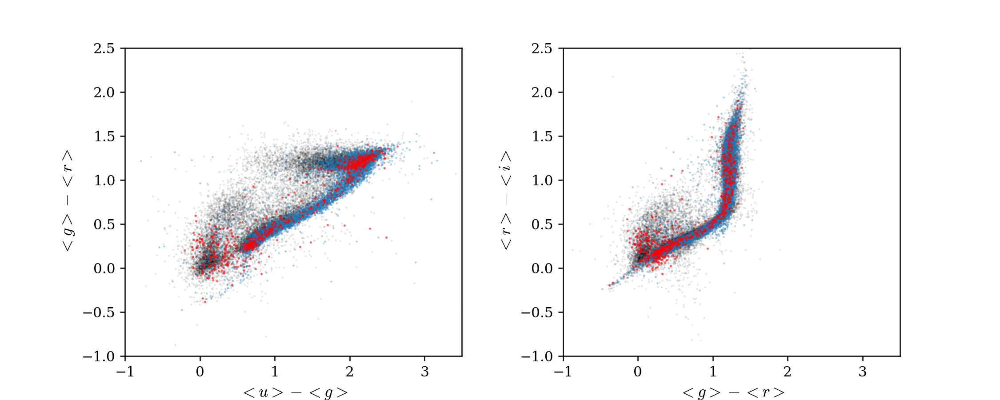

Text(0, 0.5, '$<r>-<i>$')

In [80]:
# ugr and gri color-color plots (since they involve the g-band) with the g-band sample in red

fig = plt.figure(figsize=(10,4))
fig.subplots_adjust(wspace=0.3)

ax1 = fig.add_subplot(1,2,1)
ax1.scatter(sigmaclipped_ug_color[~sigmaclipped_smallerrs], sigmaclipped_gr_color[~sigmaclipped_smallerrs], 
            s=0.05, alpha=0.2, c='k')
ax1.scatter(sigmaclipped_ug_color[sigmaclipped_smallerrs][~select], sigmaclipped_gr_color[sigmaclipped_smallerrs][~select], 
            s=0.1, alpha=0.5)
ax1.scatter(sigmaclipped_ug_color[sigmaclipped_smallerrs][select], sigmaclipped_gr_color[sigmaclipped_smallerrs][select], 
            s=0.5, alpha=0.5, c='r')
ax1.set_xlim(-1,3.5)
ax1.set_ylim(-1,2.5)
ax1.set_xlabel(r'$<u>-<g>$', fontsize=12)
ax1.set_ylabel(r'$<g>-<r>$', fontsize=12)

ax2 = fig.add_subplot(1,2,2)
ax2.scatter(sigmaclipped_gr_color[~sigmaclipped_smallerrs], sigmaclipped_ri_color[~sigmaclipped_smallerrs], 
            s=0.05, alpha=0.2, c='k')
ax2.scatter(sigmaclipped_gr_color[sigmaclipped_smallerrs][~select], sigmaclipped_ri_color[sigmaclipped_smallerrs][~select], 
            s=0.1, alpha=0.5)
ax2.scatter(sigmaclipped_gr_color[sigmaclipped_smallerrs][select], sigmaclipped_ri_color[sigmaclipped_smallerrs][select], 
            s=0.5, alpha=0.5, c='r')
ax2.set_xlim(-1,3.5)
ax2.set_ylim(-1,2.5)
ax2.set_xlabel(r'$<g>-<r>$', fontsize=12)
ax2.set_ylabel(r'$<r>-<i>$', fontsize=12)

Unfortunately, none of these tests were particularly conclusive. It's possible that what we see in the g-band RMS vs. median plot is just a general overdensity of stars in that area of the graph.

Back to identifying variable stars that could be RR Lyrae candidates: a way to determine what amount of variation is normal is to take the standard deviation of the RMS:

In [81]:
np.std(sigmaclipped_stddevs, axis=0) # standard deviation of RMS values in each filter

array([0.41009326, 0.20949264, 0.14051186, 0.20950915, 0.32313633])

In [82]:
# same as above, but only for objects with avg measurement error<0.1 mag
np.std(sigmaclipped_stddevs[sigmaclipped_smallerrs], axis=0)

array([0.25731658, 0.11799035, 0.08742673, 0.10149005, 0.10012879])

<IPython.core.display.Javascript object>


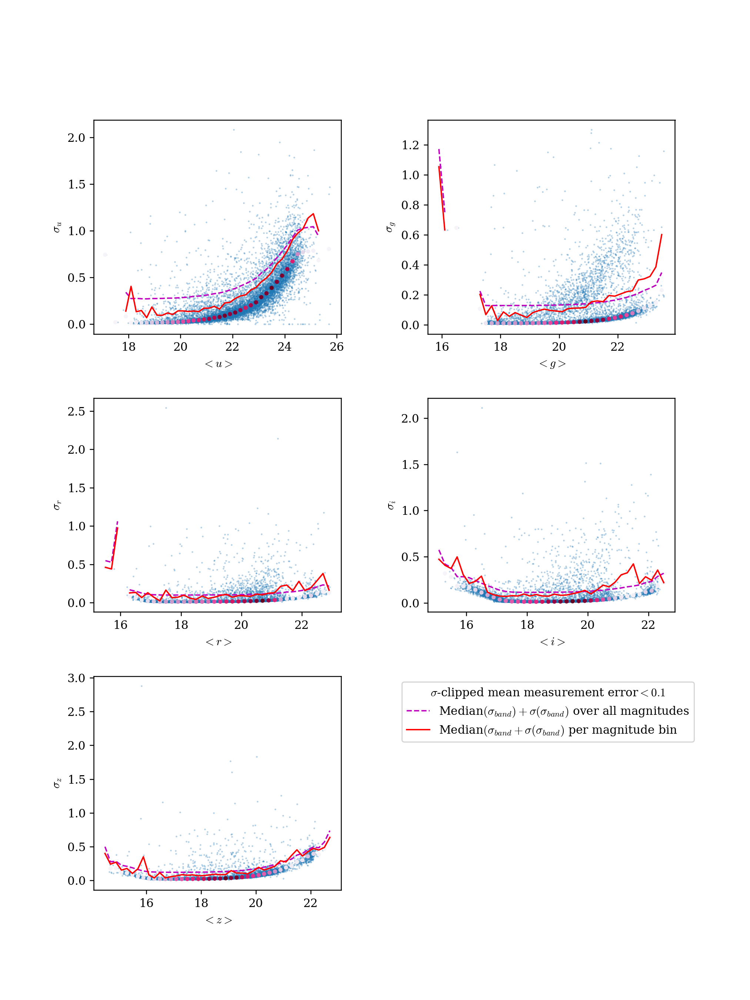

<ipython-input-83-2695b2361573>:32: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  plt.legend([overall, by_bin], labels=[r'Median$(\sigma_{band})+\sigma(\sigma_{band})$ over all magnitudes', r'Median$(\sigma_{band}+\sigma(\sigma_{band})$ per magnitude bin'],


In [83]:
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

bin_size = 0.2

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    mags = sigmaclipped_medians[sigmaclipped_smallerrs,j]
    rms = sigmaclipped_stddevs[sigmaclipped_smallerrs,j]
    start = np.floor(np.min(mags))
    end = np.ceil(np.max(mags))
    mags_plot = np.arange(start+(bin_size/2), end+(bin_size/2), bin_size)
    medrms_plot = np.empty_like(mags_plot)
    stdrms_plot = np.empty_like(mags_plot)
    num_in_bin = np.empty_like(mags_plot)
    
    for k, mag in enumerate(mags_plot):
        in_bin = np.where((mags>mag-(bin_size/2)) & (mags<mag+(bin_size/2)))[0]
        with warnings.catch_warnings():
            warnings.simplefilter(action='ignore', category=RuntimeWarning)
            medrms_plot[k] = np.median(rms[in_bin])
            stdrms_plot[k] = np.std(rms[in_bin])
        num_in_bin[k] = len(in_bin)
    
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(mags, rms, s=0.1, alpha=0.5)
    ax.scatter(mags_plot, medrms_plot, s=7, c=num_in_bin, cmap='PuRd')
    overall = ax.plot(mags_plot, medrms_plot+np.std(rms), 'm--', lw=1.2)
    by_bin = ax.plot(mags_plot, medrms_plot+stdrms_plot, 'r-', linewidth=1.2)
    ax.set_ylabel(r'$\sigma_%s$' % band)
    ax.set_xlabel(r'$<%s>$' % band)
    
plt.legend([overall, by_bin], labels=[r'Median$(\sigma_{band})+(\sigma(\sigma_{band})$ over all magnitudes)', r'Median$(\sigma_{band})+(\sigma(\sigma_{band})$ per magnitude bin)'],
           title=r'$\sigma$-clipped mean measurement error$<0.1$', loc='upper right', bbox_to_anchor=(2.45, 0, 0, 1))

<IPython.core.display.Javascript object>


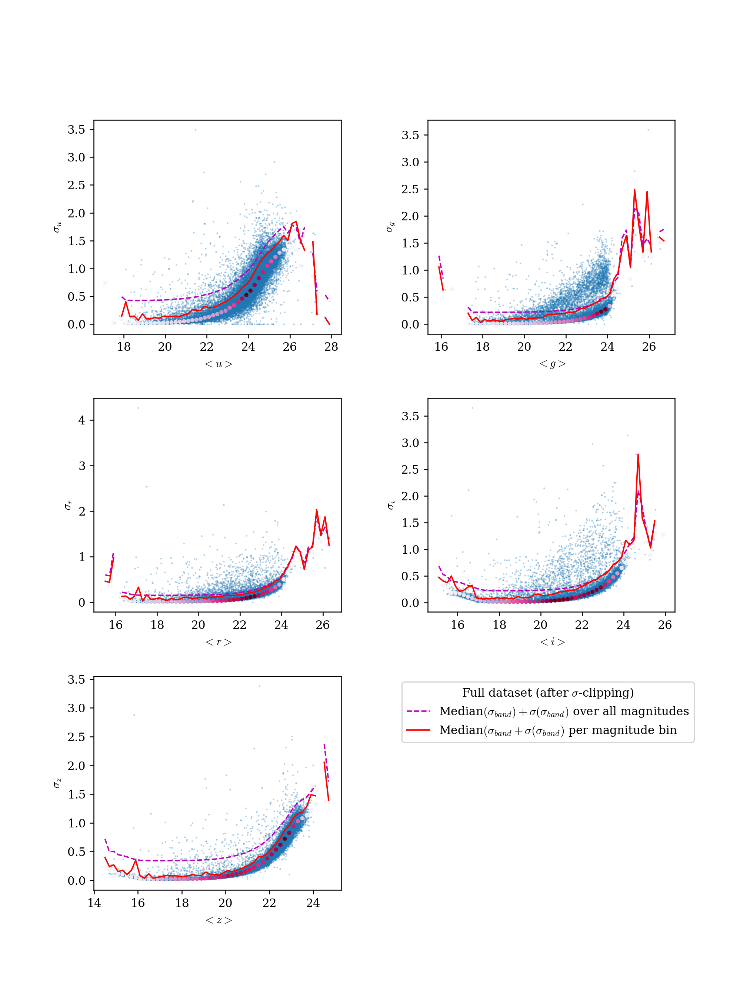

<ipython-input-84-14c5f3452279>:32: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  plt.legend([overall, by_bin], labels=[r'Median$(\sigma_{band})+\sigma(\sigma_{band})$ over all magnitudes', r'Median$(\sigma_{band}+\sigma(\sigma_{band})$ per magnitude bin'],


In [84]:
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

bin_size = 0.2

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    mags = sigmaclipped_medians[:,j]
    rms = sigmaclipped_stddevs[:,j]
    start = np.floor(np.min(mags))
    end = np.ceil(np.max(mags))
    mags_plot = np.arange(start+(bin_size/2), end+(bin_size/2), bin_size)
    medrms_plot = np.empty_like(mags_plot)
    stdrms_plot = np.empty_like(mags_plot)
    num_in_bin = np.empty_like(mags_plot)
    
    for k, mag in enumerate(mags_plot):
        in_bin = np.where((mags>mag-(bin_size/2)) & (mags<mag+(bin_size/2)))[0]
        with warnings.catch_warnings():
            warnings.simplefilter(action='ignore', category=RuntimeWarning)
            medrms_plot[k] = np.median(rms[in_bin])
            stdrms_plot[k] = np.std(rms[in_bin])
        num_in_bin[k] = len(in_bin)
    
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(mags, rms, s=0.1, alpha=0.5)
    ax.scatter(mags_plot, medrms_plot, s=7, c=num_in_bin, cmap='PuRd')
    overall = ax.plot(mags_plot, medrms_plot+np.std(rms), 'm--', lw=1.2)
    by_bin = ax.plot(mags_plot, medrms_plot+stdrms_plot, 'r-', linewidth=1.2)
    ax.set_ylabel(r'$\sigma_%s$' % band)
    ax.set_xlabel(r'$<%s>$' % band)
    
plt.legend([overall, by_bin], labels=[r'Median$(\sigma_{band})+(\sigma(\sigma_{band})$ over all magnitudes)', r'Median$(\sigma_{band}(+(\sigma(\sigma_{band})$ per magnitude bin)'],
           title=r'Full dataset (after $\sigma$-clipping)', loc='upper right', bbox_to_anchor=(2.45, 0, 0, 1))

<IPython.core.display.Javascript object>


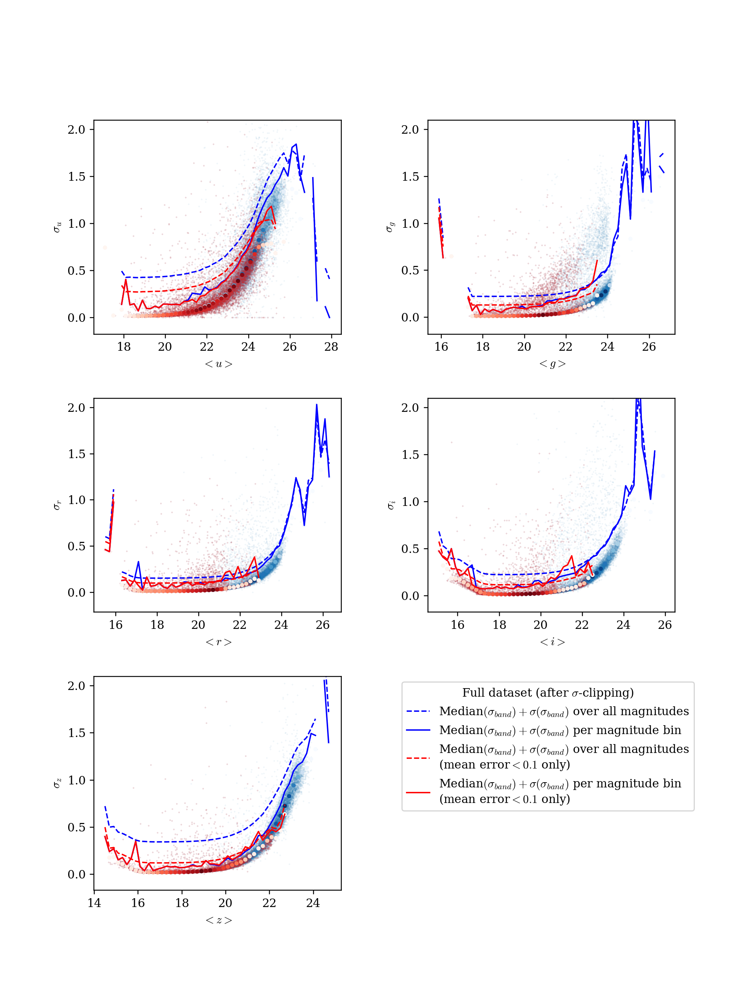

<ipython-input-85-e790949709a9>:52: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  plt.legend([overall_all, by_bin_all, overall, by_bin],


In [85]:
fig = plt.figure(figsize=(9,12))
fig.subplots_adjust(wspace=0.35, hspace=0.3)

bin_size = 0.2

for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    mags_all = sigmaclipped_medians[:,j]
    rms_all = sigmaclipped_stddevs[:,j]
    mags = sigmaclipped_medians[sigmaclipped_smallerrs,j]
    rms = sigmaclipped_stddevs[sigmaclipped_smallerrs,j]
    start_all = np.floor(np.min(mags_all))
    end_all = np.ceil(np.max(mags_all))
    start = np.floor(np.min(mags))
    end = np.ceil(np.max(mags))
    mags_plot_all = np.arange(start_all+(bin_size/2), end_all+(bin_size/2), bin_size)
    medrms_plot_all = np.empty_like(mags_plot_all)
    stdrms_plot_all = np.empty_like(mags_plot_all)
    num_in_bin_all = np.empty_like(mags_plot_all)
    mags_plot = np.arange(start+(bin_size/2), end+(bin_size/2), bin_size)
    medrms_plot = np.empty_like(mags_plot)
    stdrms_plot = np.empty_like(mags_plot)
    num_in_bin = np.empty_like(mags_plot)
    
    for k, mag in enumerate(mags_plot_all):
        in_bin = np.where((mags_all>mag-(bin_size/2)) & (mags_all<mag+(bin_size/2)))[0]
        with warnings.catch_warnings():
            warnings.simplefilter(action='ignore', category=RuntimeWarning)
            medrms_plot_all[k] = np.median(rms_all[in_bin])
            stdrms_plot_all[k] = np.std(rms_all[in_bin])
        num_in_bin_all[k] = len(in_bin)
    for k, mag in enumerate(mags_plot):
        in_bin = np.where((mags>mag-(bin_size/2)) & (mags<mag+(bin_size/2)))[0]
        with warnings.catch_warnings():
            warnings.simplefilter(action='ignore', category=RuntimeWarning)
            medrms_plot[k] = np.median(rms[in_bin])
            stdrms_plot[k] = np.std(rms[in_bin])
        num_in_bin[k] = len(in_bin)
        
    ax = fig.add_subplot(3,2,j+1)
    ax.scatter(mags_all, rms_all, s=0.01, alpha=0.3, c='tab:blue')
    ax.scatter(mags, rms, s=0.05, alpha=0.3, c='tab:red')
    ax.scatter(mags_plot_all, medrms_plot_all, s=7, c=num_in_bin_all, cmap='Blues')
    overall_all = ax.plot(mags_plot_all, medrms_plot_all+np.std(rms_all), 'b--', lw=1.2)
    by_bin_all = ax.plot(mags_plot_all, medrms_plot_all+stdrms_plot_all, 'b-', linewidth=1.2)
    ax.scatter(mags_plot, medrms_plot, s=7, c=num_in_bin, cmap='Reds')
    overall = ax.plot(mags_plot, medrms_plot+np.std(rms), 'r--', lw=1.2)
    by_bin = ax.plot(mags_plot, medrms_plot+stdrms_plot, 'r-', linewidth=1.2)
    ax.set_ylabel(r'$\sigma_%s$' % band)
    ax.set_xlabel(r'$<%s>$' % band)
    ax.set_ylim(top=2.1)
    
plt.legend([overall_all, by_bin_all, overall, by_bin], 
           labels=[r'Median$(\sigma_{band})+(\sigma(\sigma_{band})$ over all magnitudes)', r'Median$(\sigma_{band})+(\sigma(\sigma_{band})$ per magnitude bin)',
                   r'Median$(\sigma_{band})+(\sigma(\sigma_{band})$ over all magnitudes)'+'\n'+'(mean error$<0.1$ only)', 
                   r'Median$(\sigma_{band})+(\sigma(\sigma_{band})$ per magnitude bin)'+'\n'+'(mean error$<0.1$ only)'],
           title=r'Full dataset (after $\sigma$-clipping)', loc='upper right', bbox_to_anchor=(2.45, 0, 0, 1))

At this point, I went back and tried to look at the odd upward trend in the g-band RMS vs. median magnitude plot again by examining the light curves. Of course, that's a lot of objects, so I selected 10 at random from both the selected region and from a sample close to the median RMS to look at the light curves.

The code cell below will select a new sample of 10 points each time it's run.

(Sorry this Jupyter notebook is a bit out of order!)

<IPython.core.display.Javascript object>


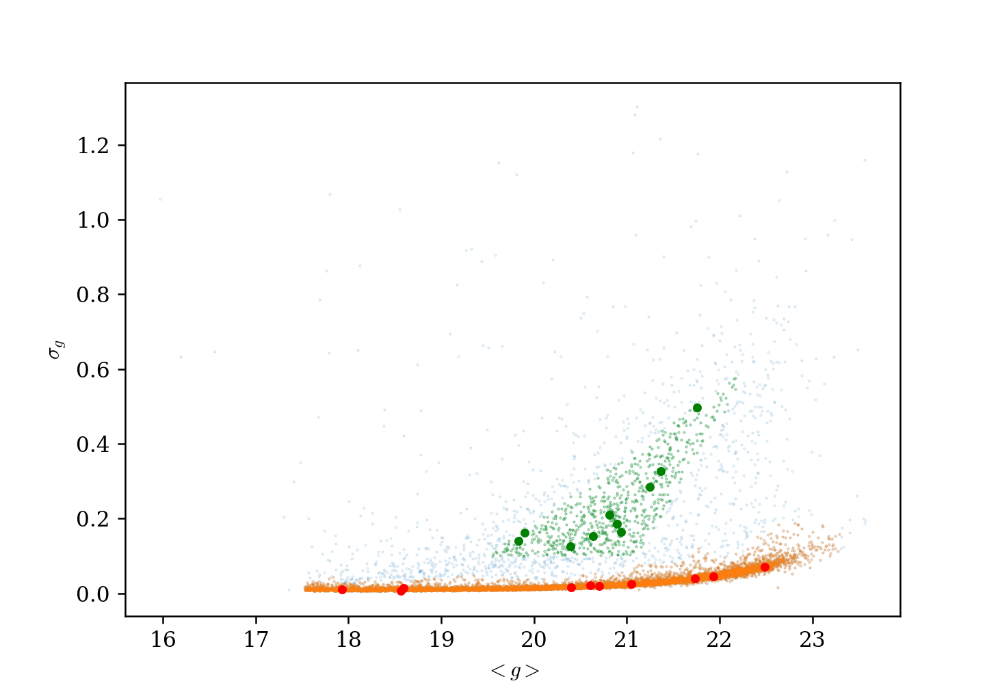

Text(0, 0.5, '$\\sigma_g$')

In [86]:
select = np.logical_and(sigmaclipped_stddevs[sigmaclipped_smallerrs,g]>0.1,
                         np.logical_and(
                            sigmaclipped_stddevs[sigmaclipped_smallerrs,g]<0.62+(((0.1-0.62)/(19.5-22.4))*(sigmaclipped_medians[sigmaclipped_smallerrs,g]-22.4)),
                            sigmaclipped_stddevs[sigmaclipped_smallerrs,g]>0.62+(((0.1-0.62)/(21.1-22.4))*(sigmaclipped_medians[sigmaclipped_smallerrs,g]-22.4))))

close_to_medianrms_g = np.full(np.sum(sigmaclipped_smallerrs), False)
mags_g = sigmaclipped_medians[sigmaclipped_smallerrs,g]
rms_g = sigmaclipped_stddevs[sigmaclipped_smallerrs,g]
bins_lowerbound = np.arange(17.4+(bin_size/2), 23+(bin_size/2), bin_size)    
for k, mag in enumerate(bins_lowerbound):
    in_bin = np.logical_and(mags_g>mag, mags_g<mag+bin_size)
    with warnings.catch_warnings():
        warnings.simplefilter(action='ignore', category=RuntimeWarning)
        close_to_medianrms_g[in_bin] = rms_g[in_bin]<(np.median(rms_g[in_bin])+(0.5*np.std(rms[in_bin])))

plt.figure(figsize=(6.5,4.5))
plt.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g], sigmaclipped_stddevs[sigmaclipped_smallerrs,g], s=0.05, alpha=0.3)
plt.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g][select], sigmaclipped_stddevs[sigmaclipped_smallerrs,g][select], s=0.05, alpha=0.7, c='tab:green')
plt.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g][close_to_medianrms_g], sigmaclipped_stddevs[sigmaclipped_smallerrs,g][close_to_medianrms_g], s=0.05, alpha=0.6, c='tab:orange')

select1 = np.random.choice(np.flatnonzero(select), 10, replace=False)
select2 = np.random.choice(np.flatnonzero(close_to_medianrms_g), 10, replace=False)

plt.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g][select1], sigmaclipped_stddevs[sigmaclipped_smallerrs,g][select1], s=10, alpha=1, c='g')
plt.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g][select2], sigmaclipped_stddevs[sigmaclipped_smallerrs,g][select2], s=10, alpha=1, c='r')

plt.xlabel('$<g>$')
plt.ylabel('$\sigma_g$')

#plt.savefig('figs/location_of_gband_samples.png', bbox_inches='tight')

<IPython.core.display.Javascript object>


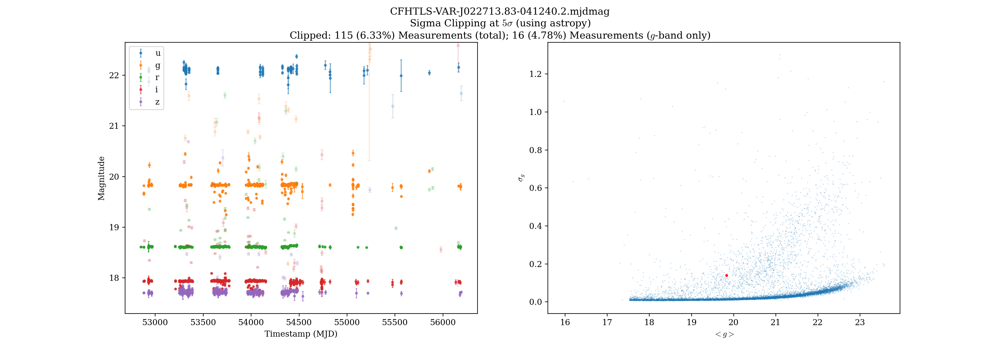

Text(0.5, 0.98, 'CFHTLS-VAR-J022713.83-041240.2.mjdmag\nSigma Clipping at $5\\sigma$ (using astropy)\nClipped: 115 (6.33%) Measurements (total); 16 (4.78%) Measurements ($g$-band only)')

In [87]:
# plot light curve and indicates location on the RMS vs median g-band plot for one of the samples in the upper sequence

test_file = file_list[sigmaclipped_smallerrs][select1][0]
test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)

fig = plt.figure(figsize=(17,6))
fig.subplots_adjust(wspace=0.2)

ylims = np.empty((5,2))
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple']
ax1 = fig.add_subplot(1,2,1)

for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    
    ax1.errorbar(test_t[test_filts==i][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==i][mask], 
                 fmt='.', capsize=1, linewidth=1, ms=5, c=colors[i], alpha=0.7, label=band)
    ylims[i,0], ylims[i,1] = ax1.get_ylim()
    
for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    ax1.errorbar(test_t[test_filts==i][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==i][~mask], 
                 fmt='.', capsize=2, c=colors[i], alpha=0.15)

ax1.set_ylim(ylims[:,0].min(), ylims[:,1].max())
ax1.set_xlabel('Timestamp (MJD)')
ax1.set_ylabel('Magnitude')
ax1.legend()

ax2 = fig.add_subplot(1,2,2)
ax2.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g], sigmaclipped_stddevs[sigmaclipped_smallerrs,g], 
            s=0.05, alpha=0.5)
ax2.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g][select1][0], sigmaclipped_stddevs[sigmaclipped_smallerrs,g][select1][0], 
            s=5, c='r')
ax2.set_ylabel(r'$\sigma_g$')
ax2.set_xlabel(r'$<g>$')

fig.suptitle(test_file+'\n'+r'Sigma Clipping at $5\sigma$ (using astropy)'+'\n'+'Clipped: %s (%.2f%%) Measurements (total); %s (%.2f%%) Measurements ($g$-band only)' 
             % (int(sigmaclip_stats[sigmaclipped_smallerrs,0][select1][0]), sigmaclip_stats[sigmaclipped_smallerrs,1][select1][0], 
                int(sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,0][select1][0]), sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,1][select1][0]))

In [ ]:
# generates and saves plots like the one above for the entire 10-object sample of objects in the upper sequence

plt.ioff()
test_files = file_list[sigmaclipped_smallerrs][select1]
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple']

for i, test_file in enumerate(test_files):
    test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)
    
    fig = plt.figure(figsize=(17,6))
    fig.subplots_adjust(wspace=0.2)
    
    ylims = np.empty((5,2))
    
    ax1 = fig.add_subplot(1,2,1)
    for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
        masked_mags = sigma_clip(test_mag[test_filts==j], sigma=5, maxiters=None)
        mask = ~masked_mags.mask
        ax1.errorbar(test_t[test_filts==j][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==j][mask], 
                     fmt='.', capsize=1, linewidth=1, ms=5, c=colors[j], alpha=0.7, label=band)
        ylims[j,0], ylims[j,1] = ax1.get_ylim()
    
    for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
        masked_mags = sigma_clip(test_mag[test_filts==j], sigma=5, maxiters=None)
        mask = ~masked_mags.mask
        ax1.errorbar(test_t[test_filts==j][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==j][~mask], 
                     fmt='.', capsize=2, c=colors[j], alpha=0.15)
        
    ax1.set_ylim(ylims[:,0].min(), ylims[:,1].max())
    ax1.set_xlabel('Timestamp (MJD)')
    ax1.set_ylabel('Magnitude')
    ax1.legend()
    
    ax2 = fig.add_subplot(1,2,2)
    ax2.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g], sigmaclipped_stddevs[sigmaclipped_smallerrs,g], 
                s=0.05, alpha=0.5)
    ax2.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g][select1][i], sigmaclipped_stddevs[sigmaclipped_smallerrs,g][select1][i], 
                s=5, c='r')
    ax2.set_ylabel(r'$\sigma_g$')
    ax2.set_xlabel(r'$<g>$')
    
    fig.suptitle(test_file+'\n'+r'Sigma Clipping at $5\sigma$ (using astropy)'+'\n'+'Clipped: %s (%.2f%%) Measurements (total); %s (%.2f%%) Measurements ($g$-band only)' 
                 % (int(sigmaclip_stats[sigmaclipped_smallerrs,0][select1][i]), sigmaclip_stats[sigmaclipped_smallerrs,1][select1][i], 
                    int(sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,0][select1][i]), sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,1][select1][i]))
    
    plt.savefig('./figs/gband_rms_upperseq_samplestar%s.png' % i, bbox_inches='tight')
    plt.close()
    
plt.ion()

<IPython.core.display.Javascript object>


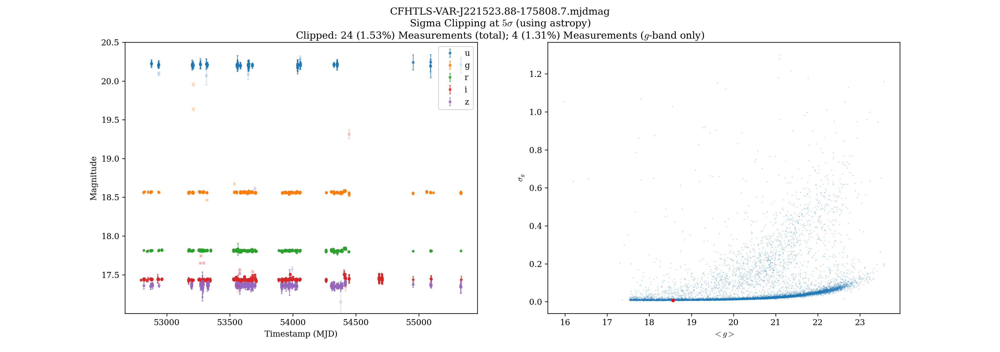

Text(0.5, 0.98, 'CFHTLS-VAR-J221523.88-175808.7.mjdmag\nSigma Clipping at $5\\sigma$ (using astropy)\nClipped: 24 (1.53%) Measurements (total); 4 (1.31%) Measurements ($g$-band only)')

In [88]:
# plot light curve and indicates location on the RMS vs median g-band plot for one of the samples near the median RMS

test_file = file_list[sigmaclipped_smallerrs][select2][0]
test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)

fig = plt.figure(figsize=(17,6))
fig.subplots_adjust(wspace=0.2)

ylims = np.empty((5,2))
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple']
ax1 = fig.add_subplot(1,2,1)

for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    
    ax1.errorbar(test_t[test_filts==i][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==i][mask], 
                 fmt='.', capsize=1, linewidth=1, ms=5, c=colors[i], alpha=0.7, label=band)
    ylims[i,0], ylims[i,1] = ax1.get_ylim()
    
for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    ax1.errorbar(test_t[test_filts==i][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==i][~mask], 
                 fmt='.', capsize=2, c=colors[i], alpha=0.15)

ax1.set_ylim(ylims[:,0].min(), ylims[:,1].max())
ax1.set_xlabel('Timestamp (MJD)')
ax1.set_ylabel('Magnitude')
ax1.legend()

ax2 = fig.add_subplot(1,2,2)
ax2.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g], sigmaclipped_stddevs[sigmaclipped_smallerrs,g], 
            s=0.05, alpha=0.5)
ax2.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g][select2][0], sigmaclipped_stddevs[sigmaclipped_smallerrs,g][select2][0], 
            s=10, c='r')
ax2.set_ylabel(r'$\sigma_g$')
ax2.set_xlabel(r'$<g>$')

fig.suptitle(test_file+'\n'+r'Sigma Clipping at $5\sigma$ (using astropy)'+'\n'+'Clipped: %s (%.2f%%) Measurements (total); %s (%.2f%%) Measurements ($g$-band only)' 
             % (int(sigmaclip_stats[sigmaclipped_smallerrs,0][select2][0]), sigmaclip_stats[sigmaclipped_smallerrs,1][select2][0], 
                int(sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,0][select2][0]), sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,1][select2][0]))

In [ ]:
# generates and saves plots like the one above for the entire 10-object sample of objects near the median RMS
plt.ioff()
test_files = file_list[sigmaclipped_smallerrs][select2]

for i, test_file in enumerate(test_files):
    test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)
    
    fig = plt.figure(figsize=(17,6))
    fig.subplots_adjust(wspace=0.2)
    
    ylims = np.empty((5,2))
    
    ax1 = fig.add_subplot(1,2,1)
    for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
        masked_mags = sigma_clip(test_mag[test_filts==j], sigma=5, maxiters=None)
        mask = ~masked_mags.mask
        ax1.errorbar(test_t[test_filts==j][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==j][mask], 
                     fmt='.', capsize=1, linewidth=1, ms=5, c=colors[j], alpha=0.7, label=band)
        ylims[j,0], ylims[j,1] = ax1.get_ylim()
    
    for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
        masked_mags = sigma_clip(test_mag[test_filts==j], sigma=5, maxiters=None)
        mask = ~masked_mags.mask
        ax1.errorbar(test_t[test_filts==j][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==j][~mask], 
                     fmt='.', capsize=2, c=colors[j], alpha=0.15)
        
    ax1.set_ylim(ylims[:,0].min(), ylims[:,1].max())
    ax1.set_xlabel('Timestamp (MJD)')
    ax1.set_ylabel('Magnitude')
    ax1.legend()
    
    ax2 = fig.add_subplot(1,2,2)
    ax2.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g], sigmaclipped_stddevs[sigmaclipped_smallerrs,g], 
                s=0.05, alpha=0.5)
    ax2.scatter(sigmaclipped_medians[sigmaclipped_smallerrs,g][select2][i], sigmaclipped_stddevs[sigmaclipped_smallerrs,g][select2][i], 
                s=5, c='r')
    ax2.set_ylabel(r'$\sigma_g$')
    ax2.set_xlabel(r'$<g>$')
    
    fig.suptitle(test_file+'\n'+r'Sigma Clipping at $5\sigma$ (using astropy)'+'\n'+'Clipped: %s (%.2f%%) Measurements (total); %s (%.2f%%) Measurements ($g$-band only)' 
                 % (int(sigmaclip_stats[sigmaclipped_smallerrs,0][select2][i]), sigmaclip_stats[sigmaclipped_smallerrs,1][select2][i], 
                    int(sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,0][select2][i]), sigmaclip_stats_by_filter[sigmaclipped_smallerrs,1,1][select2][i]))
    
    plt.savefig('./figs/gband_rms_nearmedian_samplestar%s.png' % i, bbox_inches='tight')
    plt.close()
    
plt.ion()

Unfortunately, checking the individual light curves wasn't very insightful regarding the cause of that upper spray of points either.


Finally, we did a check on stars whose RMS variation changed greatly after sigma clipping:

<IPython.core.display.Javascript object>


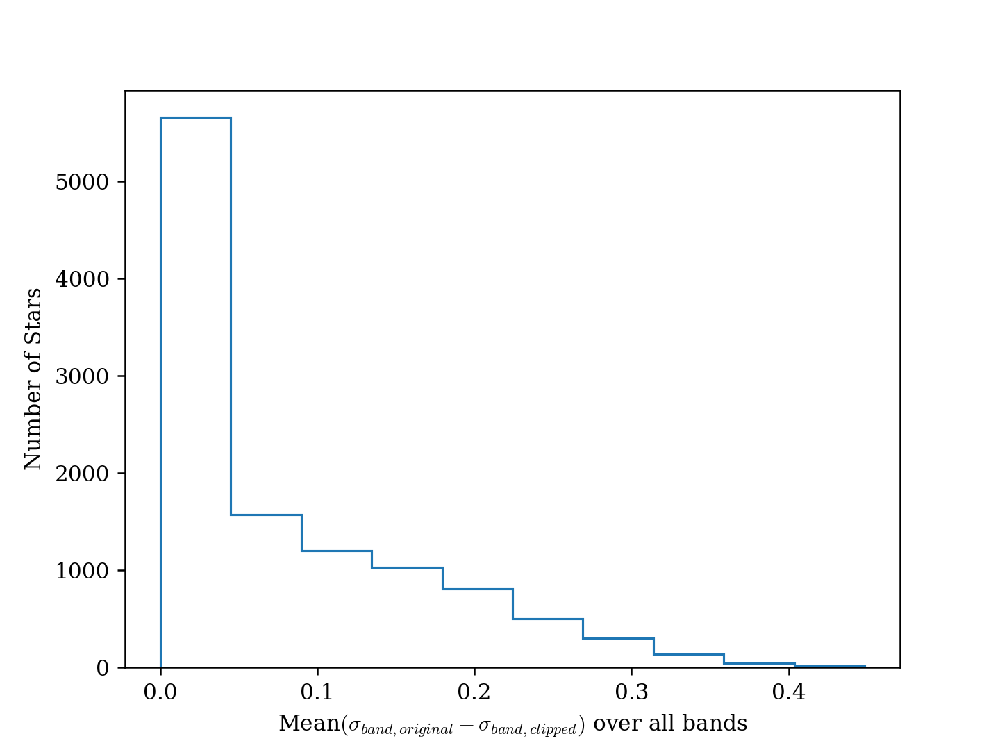

Text(0.5, 0, 'Mean$(\\sigma_{band, original}-\\sigma_{band, clipped})$ over all bands')

In [89]:
# histogram showing the distribution of average change in RMS variation before and after sigma clipping
plt.hist(np.mean(stddevs_combined_i[sigmaclipped_smallerrs] - sigmaclipped_stddevs[sigmaclipped_smallerrs], axis=1), histtype='step')
plt.ylabel('Number of Stars')
plt.xlabel('Mean$(\sigma_{band, original}-\sigma_{band, clipped})$ over all bands')

<IPython.core.display.Javascript object>


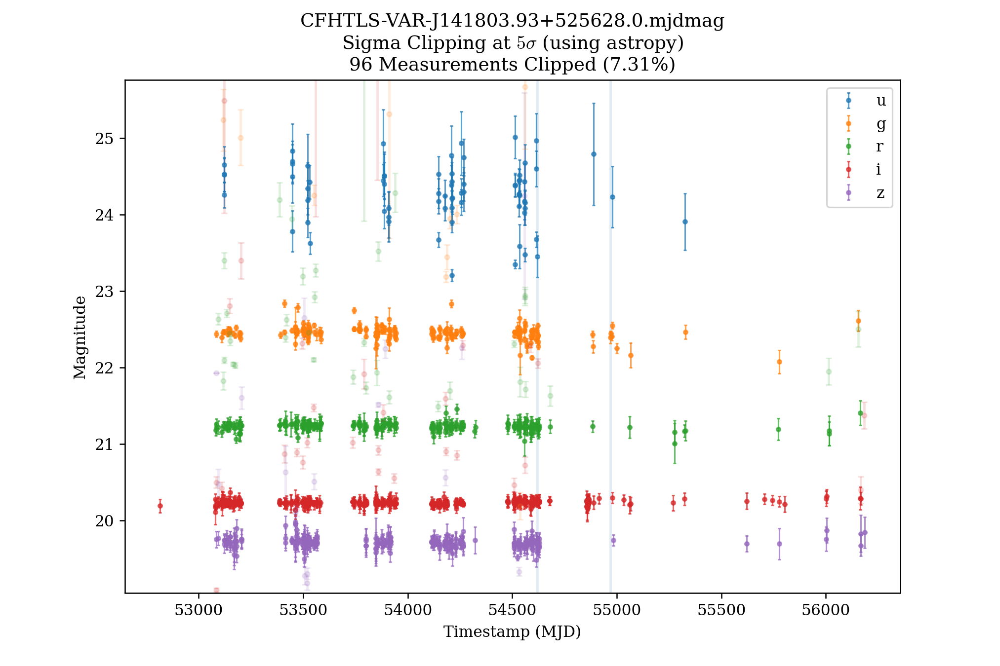

Text(0.5, 1.0, 'CFHTLS-VAR-J141803.93+525628.0.mjdmag\nSigma Clipping at $5\\sigma$ (using astropy)\n96 Measurements Clipped (7.31%)')

In [90]:
# plots light curves of objects whose RMS variation changed most drastically after sigma clipping

# the threshold used was mean change over all bands >0.4 mag, aka the very tail end of the histogram
bigsigmaclipeffect = np.mean(stddevs_combined_i[sigmaclipped_smallerrs] - sigmaclipped_stddevs[sigmaclipped_smallerrs], axis=1)>0.4
test_file = file_list[sigmaclipped_smallerrs][bigsigmaclipeffect][6] # change this index as you'd like
test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)

plt.figure(figsize=(9,6))
num_clipped = 0
ylims = np.empty((5,2))
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple']
for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    num_clipped += np.sum(~mask)
    
    plt.errorbar(test_t[test_filts==i][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==i][mask], 
                 fmt='.', capsize=1, linewidth=1, ms=5, c=colors[i], alpha=0.7, label=band)
    ylims[i,0], ylims[i,1] = plt.ylim()

# plot the clipped measurements as well, but faded wrt the color indicating the filter
for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    plt.errorbar(test_t[test_filts==i][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==i][~mask], 
                 fmt='.', capsize=2, c=colors[i], alpha=0.15)

plt.ylim(ylims[:,0].min(), ylims[:,1].max())
plt.xlabel('Timestamp (MJD)')
plt.ylabel('Magnitude')
plt.legend()
plt.title(test_file+'\n'+r'Sigma Clipping at $5\sigma$ (using astropy)'+'\n'+'%s Measurements Clipped (%.2f%%)' % (num_clipped, 100*(num_clipped/len(test_mag))))

In [236]:
# generates plots like the above for all stars with mean change in RMS over all bands from sigma clipping >0.4 mag
plt.ioff()
test_files = file_list[sigmaclipped_smallerrs][bigsigmaclipeffect]

for i, test_file in enumerate(test_files):
    test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)
    
    plt.figure(figsize=(9,6))
    ylims = np.empty((5,2))
    
    for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
        masked_mags = sigma_clip(test_mag[test_filts==j], sigma=5, maxiters=None)
        mask = ~masked_mags.mask
        plt.errorbar(test_t[test_filts==j][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==j][mask], 
                     fmt='.', capsize=1, linewidth=1, ms=5, c=colors[j], alpha=0.7, label=band)
        ylims[j,0], ylims[j,1] = plt.ylim()
    
    for j, band in enumerate(['u', 'g', 'r', 'i', 'z']):
        masked_mags = sigma_clip(test_mag[test_filts==j], sigma=5, maxiters=None)
        mask = ~masked_mags.mask
        plt.errorbar(test_t[test_filts==j][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==j][~mask], 
                     fmt='.', capsize=2, c=colors[j], alpha=0.15)
        
    plt.ylim(ylims[:,0].min(), ylims[:,1].max())
    plt.xlabel('Timestamp (MJD)')
    plt.ylabel('Magnitude')
    plt.legend()
    plt.title(test_file+'\n'+r'Sigma Clipping at $5\sigma$ (using astropy)'+'\n'+'%s (%.2f%%) Measurements Clipped' 
              % (int(sigmaclip_stats[sigmaclipped_smallerrs,0][bigsigmaclipeffect][i]), sigmaclip_stats[sigmaclipped_smallerrs,1][bigsigmaclipeffect][i]))
    
    plt.savefig('./figs/large_sigmaclip_effect_star%s.png' % i, bbox_inches='tight')
    plt.close()
    
plt.ion()

To begin examining individual light curves and the cadence and quality of our data, we can start by looking at already known RR Lyrae in the CFHTLS fields. Another RR Lyrae catalog that we can try to match objects to is the PanSTARRS1 (PS1) 3π survey, which covers a lot more area than CFHTLS but in less depth.

We can get the RA/DEC coordinates of the four CFHTLS fields [here](https://www.cfht.hawaii.edu/Science/CFHLS/cfhtlsdeepwidefields.html), and then use Vizier to search the [PS1 catalog](https://vizier.u-strasbg.fr/viz-bin/VizieR-3?-source=J/AJ/153/204/table5) by entering the RA/DEC bounds of each CFHTLS field. This gives us 0 PS1 stars in D1, 5 in D2, 0 in D3, and 3 in D4.

Then, we can try to match our CFHTLS objects to those 8 PS1 objects.

In [91]:
def get_radec(file_list):
    """
    Function that obtains the RA and DEC values of each object from the CFHTLS data
    
    Parameters
    ---
    file_list : list of str
        List of file paths (eg. one created by os.listdir(folder_path))
    
    Returns
    ---
    ra : ndarray
        Array of right ascension values of objects in file_list
    dec : ndarray
        Array of declination values of objects in file_list
    """
    ra = np.empty(len(file_list))
    dec = np.empty(len(file_list))
    
    for i, file_name in enumerate(file_list):
        with open('full/'+file_name) as data_file:
            next(data_file)
            line = data_file.readline()
            ra[i] = np.float((line.split())[2])
            dec[i] = np.float((line.split())[3])
            
    return ra, dec

In [16]:
ras, decs = get_radec(file_list)

In [13]:
# save the RA/DEC values for objects by field
for _, field in enumerate(['D1', 'D2', 'D3', 'D4']):
    tosave = np.vstack((ras[fields==field], decs[fields==field])).transpose()
    np.savetxt('%s_ras_decs.txt' % field, tosave, delimiter=',')

In [17]:
# same as above, but saved as a region file for DS9
for _, field in enumerate(['D2', 'D4']):
    brightest100_in_field = np.argsort((np.sum(sigmaclipped_medians, axis=1))[fields==field])[-100:]
    tosave = []
    for _, ind in enumerate(brightest100_in_field):
        tosave.append('j2000; point(%s,%s) # point=circle 5' % (ras[fields==field][ind], decs[fields==field][ind]))
    np.savetxt('%s_brightest100_ras_decs.reg' % field, tosave, fmt='%s')

In [38]:
# save RA/DEC values only for the 100 brightest objects in each field
for _, field in enumerate(['D1', 'D2', 'D3', 'D4']):
    brightest100_in_field = np.argsort((np.sum(sigmaclipped_medians, axis=1))[fields==field])[-100:]
    tosave = np.vstack((ras[fields==field][brightest100_in_field], decs[fields==field][brightest100_in_field])).transpose()
    np.savetxt('%s_brightest100_ras_decs.txt' % field, tosave, delimiter=',')

In [17]:
# same as above, but saved as a region file for DS9
for field in ['D1', 'D2', 'D3', 'D4']:
    tosave = []
    for ind in range(sum(fields==field)):
        tosave.append('j2000; point(%s,%s) # point=circle 5' % (ras[fields==field][ind], decs[fields==field][ind]))
    np.savetxt('%s_ras_decs.reg' % field, tosave, fmt='%s')

In [19]:
# save RA/DEC of all CFHTLS objects as a region file for DS9
tosave = []
for ind in range(len(file_list)):
    tosave.append('j2000; point(%s,%s) # point=circle 5' % (ras[ind], decs[ind]))
np.savetxt('all_ras_decs.reg', tosave, fmt='%s')

In [20]:
def load_ps1_match_data():
    """
    Function that obtains the RA/DEC, mean magnitude, and period of the PS1 RR Lyrae in the CFHTLS fields.
    
    Returns
    ---
    ra : ndarray
        Array of right ascension values for PS1 RR Lyrae in CFHTLS fields
    dec : ndarray
        Array of declination for PS1 RR Lyrae in CFHTLS fields
    avg_mags : ndarray
        Array of average PS1 magnitudes in griz for PS1 RR Lyrae in CFHTLS fields
    per : ndarray
        Array of calculated PS1 periods for PS1 RR Lyrae in CFHTLS fields
    """
    with warnings.catch_warnings():
        warnings.simplefilter(action='ignore')
        d2 = (fits.open('ps1_in_d2.fit'))[1].data
        d4 = (fits.open('ps1_in_d4.fit'))[1].data
    
    ra = np.concatenate((d2['RAJ2000'], d4['RAJ2000']))
    dec = np.concatenate((d2['DEJ2000'], d4['DEJ2000']))
    
    avg_mags = np.empty((len(ra), 4))
    avg_mags[:,0] = np.concatenate((d2['__gmag_'], d4['__gmag_']))
    avg_mags[:,1] = np.concatenate((d2['__rmag_'], d4['__rmag_']))
    avg_mags[:,2] = np.concatenate((d2['__imag_'], d4['__imag_']))
    avg_mags[:,3] = np.concatenate((d2['__zmag_'], d4['__zmag_']))
    
    per = np.concatenate((d2['Per'], d4['Per']))
    
    return ra, dec, avg_mags, per

In [21]:
ps1_ras, ps1_decs, ps1_grizmags, ps1_periods = load_ps1_match_data()

In [44]:
# save the PS1 RA/DEC values by CFHTLS filter in the same format as the CFHTLS objects' RA/DEC
np.savetxt('ps1_in_d2_ras_decs.txt', np.vstack((ps1_ras[:5], ps1_decs[:5])).transpose(), delimiter=',')
np.savetxt('ps1_in_d4_ras_decs.txt', np.vstack((ps1_ras[5:], ps1_decs[5:])).transpose(), delimiter=',')

In [24]:
# save PS1 RA/DEC values by CFHTLS filter as DS9 regions
tosave = []
for ind in range(5):
    tosave.append('j2000; point(%s,%s) # point=circle 5' % (ps1_ras[ind], ps1_decs[ind]))
np.savetxt('ps1_in_d2_ras_decs.reg', tosave, fmt='%s')

tosave = []
for ind in range(3):
    tosave.append('j2000; point(%s,%s) # point=circle 5' % (ps1_ras[-(ind+1)], ps1_decs[-(ind+1)]))
np.savetxt('ps1_in_d4_ras_decs.reg', tosave, fmt='%s')

In [67]:
# matches all 8 PS1 objects to CFHTLS objects by finding the CFHTLS object with the closest apparent magnitude within a certain distance from the PS1 object
closestmatch_by_mag_inds = np.empty(len(ps1_ras), dtype=int)

for i in range(len(ps1_ras)):
    close_radec_inds = np.where((ras>ps1_ras[i]-.01) & (ras<ps1_ras[i]+.01) & (decs>ps1_decs[i]-.01) & (decs<ps1_decs[i]+.01))[0]
    closest_mag_ind = np.argmin(np.abs(np.mean(sigmaclipped_medians[close_radec_inds,1:]-ps1_grizmags[i], axis=1)))
    closestmatch_by_mag_inds[i] = close_radec_inds[closest_mag_ind]
    
closestmatch_by_mag_inds

array([11811, 11505, 10583,  7210,  8516, 25121, 22689, 23581])

In [68]:
# matches all 8 PS1 objects to CFHTLS objects by minimzing the distance in RA/DEC
closestmatch_by_dist_inds = np.empty(len(ps1_ras), dtype=int)

for i in range(len(ps1_ras)):
    radiff = np.abs(ras-ps1_ras[i])
    decdiff = np.abs(decs-ps1_decs[i])
    radec_dist = np.sqrt(radiff**2 + decdiff**2)
    closestmatch_by_dist_inds[i] = np.argmin(radec_dist)
    
closestmatch_by_dist_inds

array([11811, 11505, 10583,  7210,  8516, 25121, 22689, 23581])

Above, I used two different methods to match the 8 PS1 objects in the CFHTLS fields and got the same set of objects. This is promising. 

But those DS9 region files were made for a reason. If you download the [full CFHTLS multi-wavelength images](https://www.cadc-ccda.hia-iha.nrc-cnrc.gc.ca/en/megapipe/cfhtls/scrollD2.html) for each field (or, really, only D2 and D4 are needed since the other fields don't have any PS1 objects), open them in D9, and use the region files to indicate all the objects, you'll notice that several of the already few PS1 objects in those fields aren't CFHTLS objects at all. There are PS1 objects that are clearly spatially separated from any CFHTLS object. Some of these objects are just too bright for CFHTLS to observer properly and others don't appear as point sources (ie. they aren't stars; they're actually likely to be distant quasars) at all. I've summarized whether each PS1 object actually has a CFHTLS match below by looking the full image in DS9 below, but you are welcome to try it for yourself! (The numbers are just the index of each object from the matching above)

**D2 "matches"**\
0: not a match, likely saturated (slightly visible diffraction spikes, ps1 object is a rr lyrae with score 1 but mean gmag \~15 is too bright for CFHTLS)\
1: not a match, not a point source (ps1 object is *very* elongated, likely a quasar - ps1 score 0.42 may indicate variation)\
2: not a match, may not be a point source (ps1 object is round but seems far diffuse/radial light profile appears to be shallower than nearby CFHTLS point sources, ps1 score 0.01 so unlikely to be variable anyway)\
3: not a match, likely saturated (visible diffraction spikes, ps1 score 0.09 and mean gmag \~14, probably not worth worrying about)\
4: match, likely rr lyrae (variable phase-folded curve + ps1 score 0.92)

**D4 "matches"**\
5: not a match, not a point source (ps1 object is elongated, likely a quasar - ps1 score 0.69 may indicate variation)\
6: match, likely rr lyrae (variable phase-folded curve + ps1 score 0.83)\
7: match, not rr lyrae (flat phase-folded curve + ps1 score 0.29)

To double-check these findings, I calculated the distance between the PS1 object and the closest CFHTLS match. If both objects are indeed the same, we expect the difference to not exceed more than an arcsecond or two.

In [69]:
np.sqrt((np.abs(ras[closestmatch_by_dist_inds]-ps1_ras))**2 + (np.abs(decs[closestmatch_by_dist_inds]-ps1_decs))**2)

array([9.27462802e-03, 6.21281619e-03, 7.96318145e-03, 4.40900229e-03,
       7.22495675e-06, 4.95104571e-03, 3.85292097e-05, 2.07000000e-05])

In [80]:
# same as above, but in arcseconds
3600*np.sqrt((np.abs(ras[closestmatch_by_dist_inds]-ps1_ras))**2 + (np.abs(decs[closestmatch_by_dist_inds]-ps1_decs))**2)

array([3.33886609e+01, 2.23661383e+01, 2.86674532e+01, 1.58724082e+01,
       2.60098443e-02, 1.78237646e+01, 1.38705155e-01, 7.45200000e-02])

Finally, to triple check, I plotted the (sigma clipped) light curves of each CFHTLS object that was supposedly a match. Then I also plotted the phase-folded light curve (where I divided the time value by the PS1 period of the supposed match). You can quickly generate these plots for yourself below:

In [63]:
plt.ioff()
for match_ind, ind in enumerate(closestmatch_by_dist_inds):
    test_file = file_list[ind]
    test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)

    plt.figure(figsize=(9,6))
    ylims = np.empty((5,2))
    colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple']
    for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
        masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
        mask = ~masked_mags.mask
        num_clipped += np.sum(~mask)

        plt.errorbar(test_t[test_filts==i][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==i][mask], 
                     fmt='.', capsize=1, linewidth=1, ms=5, c=colors[i], alpha=0.7, label=band)
        if i!=0:
            plt.axhline(ps1_grizmags[match_ind, i-1], c=colors[i], ls='--', lw=1.5)
        ylims[i,0], ylims[i,1] = plt.ylim()

    for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
        masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
        mask = ~masked_mags.mask
        plt.errorbar(test_t[test_filts==i][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==i][~mask], 
                     fmt='.', capsize=2, c=colors[i], alpha=0.15)

    plt.ylim(ylims[:,0].min(), ylims[:,1].max())
    plt.gca().invert_yaxis()
    plt.xlabel('Timestamp (MJD)')
    plt.ylabel('Magnitude')
    plt.legend()
    plt.title(test_file+'\n'+'RA/DEC: %.5f, %.5f (PS1 Closest Match: %.5f, %.5f)' 
              % (ras[ind], decs[ind], ps1_ras[match_ind], ps1_decs[match_ind]))
    
    plt.savefig('./figs/closest_ps1_match_%s.png' % match_ind, bbox_inches='tight')
    plt.close()
    
plt.ion()

In [79]:
plt.ioff()
for match_ind, ind in enumerate(closestmatch_by_dist_inds):
    test_file = file_list[ind]
    test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)
    test_phase = test_t % ps1_periods[match_ind]

    plt.figure(figsize=(9,6))
    ylims = np.empty((5,2))
    colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple']
    for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
        masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
        mask = ~masked_mags.mask
        num_clipped += np.sum(~mask)

        plt.errorbar(test_phase[test_filts==i][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==i][mask], 
                     fmt='.', capsize=1, linewidth=1, ms=5, c=colors[i], alpha=0.7, label=band)
        ylims[i,0], ylims[i,1] = plt.ylim()

    for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
        masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
        mask = ~masked_mags.mask
        plt.errorbar(test_phase[test_filts==i][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==i][~mask], 
                     fmt='.', capsize=2, c=colors[i], alpha=0.15)

    plt.ylim(ylims[:,0].min(), ylims[:,1].max())
    plt.gca().invert_yaxis()
    plt.xlabel('Timestamp (MJD)')
    plt.ylabel('Magnitude')
    plt.legend()
    plt.title(test_file+'\n'+'RA/DEC: %.5f, %.5f (PS1 Closest Match: %.5f, %.5f)' 
              % (ras[ind], decs[ind], ps1_ras[match_ind], ps1_decs[match_ind]))
    
    plt.savefig('./figs/closest_ps1_match_%s_phasefolded.png' % match_ind, bbox_inches='tight')
    plt.close()
    
plt.ion()

Just to show off the three CFHTLS objects that turned out to be true matches, I plotted their phase-folded light curves below:

<IPython.core.display.Javascript object>


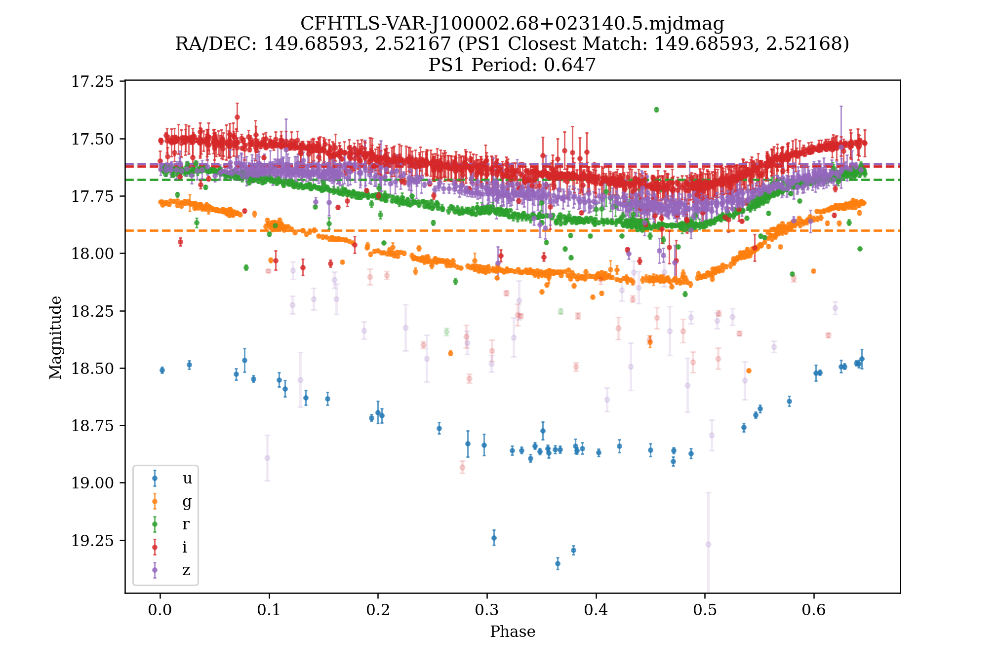

2989 measurements clipped


In [91]:
match_ind = 4
ind = closestmatch_by_dist_inds[match_ind]
test_file = file_list[ind]
test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)
test_phase = test_t % ps1_periods[match_ind]

plt.figure(figsize=(9,6))
ylims = np.empty((5,2))
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple']
for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    num_clipped += np.sum(~mask)

    plt.errorbar(test_phase[test_filts==i][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==i][mask], 
                 fmt='.', capsize=1, linewidth=1, ms=5, c=colors[i], alpha=0.7, label=band)
    if i!=0:
        plt.axhline(ps1_grizmags[match_ind, i-1], c=colors[i], ls='--', lw=1.5)
    
    ylims[i,0], ylims[i,1] = plt.ylim()

for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    plt.errorbar(test_phase[test_filts==i][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==i][~mask], 
                 fmt='.', capsize=2, c=colors[i], alpha=0.15)

plt.ylim(ylims[:,0].min(), ylims[:,1].max())
plt.gca().invert_yaxis()
plt.xlabel('Phase')
plt.ylabel('Magnitude')
plt.legend()
plt.title(test_file+'\n'+'RA/DEC: %.5f, %.5f (PS1 Closest Match: %.5f, %.5f)\nPS1 Period: %.3f' 
          % (ras[ind], decs[ind], ps1_ras[match_ind], ps1_decs[match_ind], ps1_periods[match_ind]))

print('%s measurements clipped' % num_clipped)

<IPython.core.display.Javascript object>


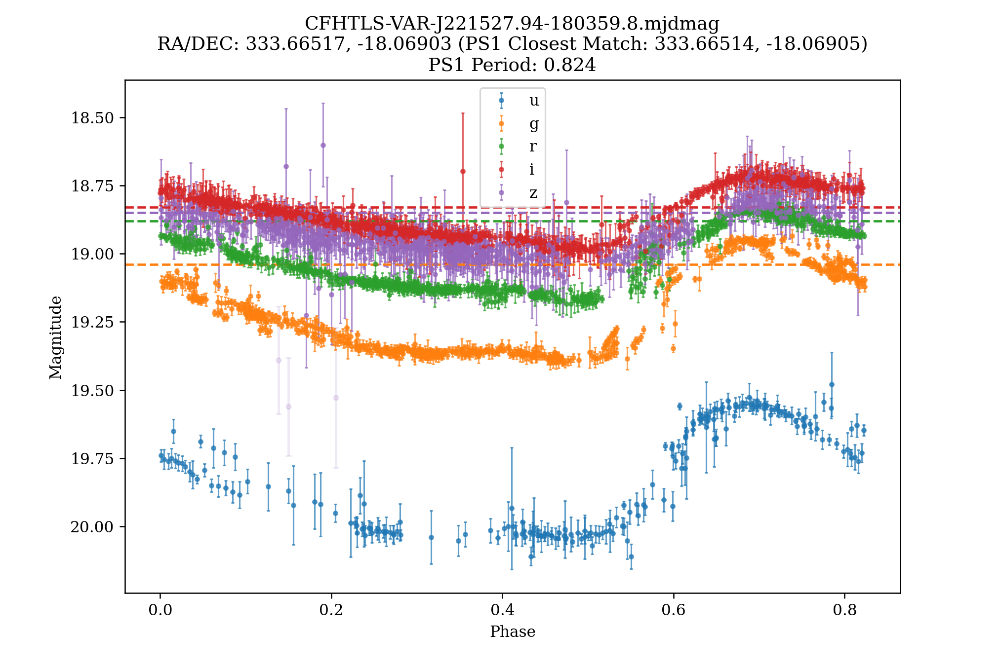

2993 measurements clipped


In [92]:
match_ind = 6
ind = closestmatch_by_dist_inds[match_ind]
test_file = file_list[ind]
test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)
test_phase = test_t % ps1_periods[match_ind]

plt.figure(figsize=(9,6))
ylims = np.empty((5,2))
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple']
for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    num_clipped += np.sum(~mask)

    plt.errorbar(test_phase[test_filts==i][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==i][mask], 
                 fmt='.', capsize=1, linewidth=1, ms=5, c=colors[i], alpha=0.7, label=band)
    if i!=0:
        plt.axhline(ps1_grizmags[match_ind, i-1], c=colors[i], ls='--', lw=1.5)
    
    ylims[i,0], ylims[i,1] = plt.ylim()

for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    plt.errorbar(test_phase[test_filts==i][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==i][~mask], 
                 fmt='.', capsize=2, c=colors[i], alpha=0.15)

plt.ylim(ylims[:,0].min(), ylims[:,1].max())
plt.gca().invert_yaxis()
plt.xlabel('Phase')
plt.ylabel('Magnitude')
plt.legend()
plt.title(test_file+'\n'+'RA/DEC: %.5f, %.5f (PS1 Closest Match: %.5f, %.5f)\nPS1 Period: %.3f' 
          % (ras[ind], decs[ind], ps1_ras[match_ind], ps1_decs[match_ind], ps1_periods[match_ind]))

print('%s measurements clipped' % num_clipped)

<IPython.core.display.Javascript object>


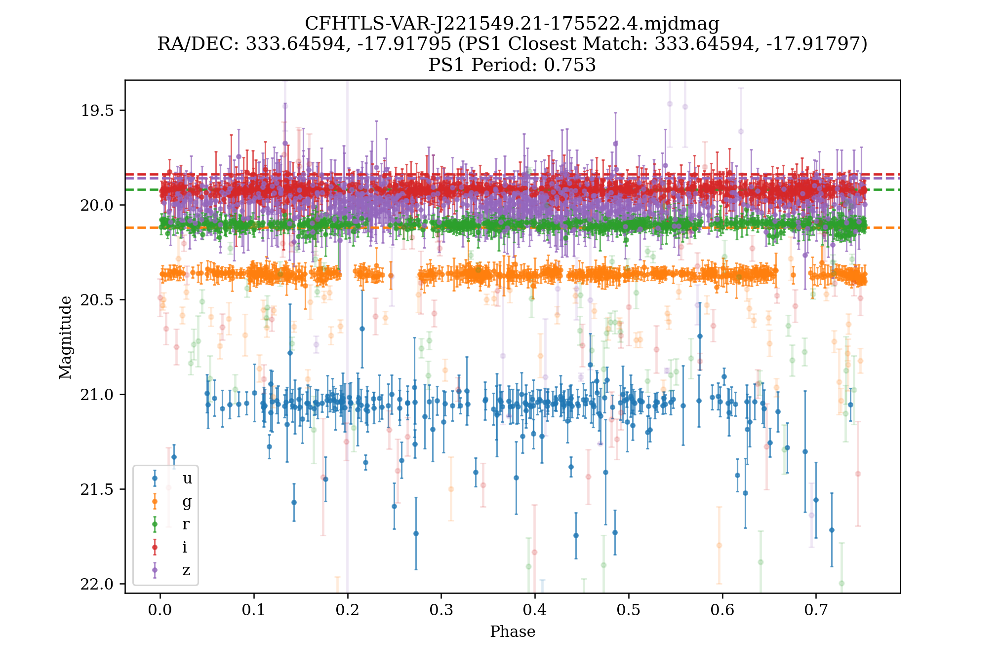

Text(0.5, 1.0, 'CFHTLS-VAR-J221549.21-175522.4.mjdmag\nRA/DEC: 333.64594, -17.91795 (PS1 Closest Match: 333.64594, -17.91797)\nPS1 Period: 0.753')

In [77]:
match_ind = 7
ind = closestmatch_by_dist_inds[match_ind]
test_file = file_list[ind]
test_t, test_mag, test_magerr, test_filts = load_one_timeseries_combined_i(test_file, fit_coeffs)
test_phase = test_t % ps1_periods[match_ind]

plt.figure(figsize=(9,6))
ylims = np.empty((5,2))
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple']
for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    num_clipped += np.sum(~mask)

    plt.errorbar(test_phase[test_filts==i][mask], masked_mags[mask].data, yerr=test_magerr[test_filts==i][mask], 
                 fmt='.', capsize=1, linewidth=1, ms=5, c=colors[i], alpha=0.7, label=band)
    if i!=0:
        plt.axhline(ps1_grizmags[match_ind, i-1], c=colors[i], ls='--', lw=1.5)
    
    ylims[i,0], ylims[i,1] = plt.ylim()

for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    masked_mags = sigma_clip(test_mag[test_filts==i], sigma=5, maxiters=None)
    mask = ~masked_mags.mask
    plt.errorbar(test_phase[test_filts==i][~mask], (masked_mags.data)[~mask], yerr=test_magerr[test_filts==i][~mask], 
                 fmt='.', capsize=2, c=colors[i], alpha=0.15)

plt.ylim(ylims[:,0].min(), ylims[:,1].max())
plt.gca().invert_yaxis()
plt.xlabel('Phase')
plt.ylabel('Magnitude')
plt.legend()
plt.title(test_file+'\n'+'RA/DEC: %.5f, %.5f (PS1 Closest Match: %.5f, %.5f)\nPS1 Period: %.3f' 
          % (ras[ind], decs[ind], ps1_ras[match_ind], ps1_decs[match_ind], ps1_periods[match_ind]))

From the above 3 plots, it should be clear that the last object is not actually variable and thus, not a RR Lyrae star. Still, the cadence presented in the CFHTLS light curves of the two PS1 RR Lyrae we did find in our data set is extraordinary!